<a href="https://colab.research.google.com/github/CRISTIANJULIOCESAR/DANN/blob/main/dann_cv_shaps_global_FINAL_el%20que%20va%20funcionando.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import os
import glob

def clear_previous_features(directory):
    # Eliminar todos los archivos .pkl en el directorio especificado
    files = glob.glob(os.path.join(directory, '*.pkl'))
    for f in files:
        try:
            os.remove(f)
            print(f'Eliminado: {f}')
        except Exception as e:
            print(f'No se pudo eliminar {f}. Error: {str(e)}')

# Directorio donde guardas las características
save_dir = "/content/drive/MyDrive/PANCANCER FINAL"

# Llamada a la función para limpiar los archivos previos
clear_previous_features(save_dir)


In [3]:
import os

# Obtener el número de núcleos
num_cores = os.cpu_count()
print(f"Número de núcleos de CPU: {num_cores}")


Número de núcleos de CPU: 12


In [4]:
import torch

if torch.cuda.is_available():
    gpu_name = torch.cuda.get_device_name(0)
    print(f"GPU en uso: {gpu_name}")
    print(f"Memoria total de la GPU: {torch.cuda.get_device_properties(0).total_memory / (1024 ** 3):.2f} GB")
else:
    print("No se encontró una GPU disponible.")


GPU en uso: NVIDIA L4
Memoria total de la GPU: 22.17 GB


In [5]:
!pip install umap-learn shap
!pytorch-lamb

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.7/85.7 kB 8.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 540.1/540.1 kB 42.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.9/56.9 kB 5.6 MB/s eta 0:00:00
/bin/bash: line 1: pytorch-lamb: command not found


In [6]:
import pandas as pd
clinicos = pd.read_pickle('/content/drive/MyDrive/pan_cancer_diner/final/Pan Cancer/Validados/picklesnuevos/meta_sinFPPP.pkl')
clinicos

,Unnamed: 0,data_type,updated_datetime,file_name,md5sum,data_category,experimental_strategy,project,sample_uuid,sample_barcode,...,panel,histology,tissue_site,stage,T,N,M,residual_tumor,new_tumor_events,follow_ups
file_id,,,,,,,,,,,,,,,,,,,,,
9fe7d0f4-866d-490f-b2cb-d9be7da889de,7001,Gene Expression Quantification,2016-05-26T20:51:28.753650-05:00,1db2cfc5-346d-4398-9dd4-8b92435059fd.htseq.cou...,bff9318f04ad067bccc0fbd2d31b45f1,Transcriptome Profiling,RNA-Seq,TCGA,9259e9ee-7279-4b62-8512-509cb705029c,TCGA-DD-AAVP-01A,...,LIHC,Hepatocellular Carcinoma,Liver,Stage I,T1,N0,M0,R0,2.0,1.0
dd74434f-300f-4798-8342-aad31b192e12,8001,Gene Expression Quantification,2016-05-26T21:04:47.187859-05:00,5f4cf592-e135-43ff-9c11-bcba462626d3.htseq.cou...,92cf7b5b7f0a0f5dfa02919c586b72c7,Transcriptome Profiling,RNA-Seq,TCGA,bccb7f9d-8dde-45b7-a50d-6c7233239ceb,TCGA-KK-A7B2-01A,...,PRAD,Prostate Adenocarcinoma Acinar Type,Prostate,NaN,T3a,N1,NaN,R0,2.0,1.0
07db9e9d-059d-4e6c-b483-81517a492b96,1001,Gene Expression Quantification,2016-05-26T21:04:48.015693-05:00,aa4a76e4-5348-479c-8beb-3e4e34e18ce9.htseq.cou...,503fa39eb3a770b869ab0c4297fd0d43,Transcriptome Profiling,RNA-Seq,TCGA,03877fe0-b0d6-4800-be46-b45c70350e48,TCGA-DC-6158-01A,...,READ,Rectal Adenocarcinoma,Rectum,Stage I,T2,N0,M0,R0,3.0,2.0
47ee860a-fd18-48f2-bfe7-4e19391950bd,2001,Gene Expression Quantification,2016-05-26T21:04:48.692729-05:00,0c172934-64ff-44dc-bdba-4c738f5692ea.htseq.cou...,c61b88a22488a1a0d2fb3e7739db0b32,Transcriptome Profiling,RNA-Seq,TCGA,8d3e521b-6df4-4633-bb44-7647ded94130,TCGA-DD-A4NP-01A,...,LIHC,Hepatocellular Carcinoma,Liver,Stage I,T1,N0,M0,R0,3.0,2.0
e322b0e5-458a-4cbf-a64f-9b348e413939,5001,Gene Expression Quantification,2016-05-26T21:04:49.266949-05:00,3025ad45-1d29-4c05-b90f-3d4a348c82c6.htseq.cou...,d279845ef0505630cf5a2ee4b1be5cac,Transcriptome Profiling,RNA-Seq,TCGA,8fef5013-4e57-4043-8770-a56135aeac9b,TCGA-HQ-A5ND-01A,...,BLCA,Muscle invasive urothelial carcinoma (pT2 or a...,Bladder,Stage IV,T3b,N1,M0,NaN,2.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
62cb41b1-8960-4fa2-8f74-38dd174af004,3999,Gene Expression Quantification,2016-06-01T23:31:30.205560-05:00,1ef78255-1b5c-42af-aa81-128c1b009114.htseq.cou...,4e139effd7c17a3b6f8c8a2dcf1ba2f5,Transcriptome Profiling,RNA-Seq,TCGA,f03d9b83-a4d7-4e77-abaa-5c3dbee0bcf3,TCGA-BP-4790-01A,...,KIRC,Kidney Clear Cell Renal Carcinoma,Kidney,Stage I,T1a,NX,M0,NaN,2.0,1.0
673a85f3-ba5e-448a-acee-dfec77b5238e,8000,Gene Expression Quantification,2016-06-01T23:31:30.867514-05:00,d07c7238-807f-48b1-bf06-deaa6200f4aa.htseq.cou...,b07dddd077d9db4f26b3e2ae066555c4,Transcriptome Profiling,RNA-Seq,TCGA,d90a2617-bf0b-453f-a483-ceac82781a6c,TCGA-N9-A4Q4-01A,...,UCS,Uterine Carcinosarcoma/ Malignant Mixed Muller...,Uterus,NaN,NaN,NaN,NaN,R0,1.0,0.0
3d93b2ae-7730-4914-af23-ff3554752922,9000,Gene Expression Quantification,2016-06-01T23:31:31.468195-05:00,3c5b65ad-998a-4124-814f-760de89f05d0.htseq.cou...,2046f591b06fa9eafb79d667f7942795,Transcriptome Profiling,RNA-Seq,TCGA,bf8e8426-dc44-40b0-8459-ad1dbaf9ba5a,TCGA-RY-A847-01A,...,LGG,Oligodendroglioma,Central nervous system,NaN,NaN,NaN,NaN,NaN,2.0,1.0


In [7]:
df = pd.read_pickle('/content/drive/MyDrive/pan_cancer_diner/final/Pan Cancer/Validados/picklesnuevos/df_sinFPPP_2.pkl')
df

,5S_rRNA,5_8S_rRNA,7SK,A1BG,A1BG-AS1,A1CF,A2M,A2M-AS1,A2ML1,A2ML1-AS1,...,ZYG11A,ZYG11AP1,ZYG11B,ZYX,ZYXP1,ZZEF1,ZZZ3,hsa-mir-1253,hsa-mir-423,snoZ196
9fe7d0f4-866d-490f-b2cb-d9be7da889de,0,0,79,1055,12,3291,6614,11,0,0,...,5,0,557,3130,0,314,469,0,0,3
dd74434f-300f-4798-8342-aad31b192e12,1,0,1250,8,51,3,24510,55,120,0,...,73,0,963,10619,0,1656,1146,0,0,3
07db9e9d-059d-4e6c-b483-81517a492b96,0,0,41,2,35,1618,21227,29,1,0,...,5,0,2136,13793,0,3667,2641,0,0,3
47ee860a-fd18-48f2-bfe7-4e19391950bd,0,0,111,16482,328,10632,159168,124,1,0,...,66,0,3417,887,0,1822,1891,0,0,1
e322b0e5-458a-4cbf-a64f-9b348e413939,2,0,22,2,0,2,7488,18,1714,0,...,52,0,2155,13427,0,1404,2215,0,0,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
62cb41b1-8960-4fa2-8f74-38dd174af004,3,0,52,14,76,2971,111008,92,6,0,...,28,0,3969,11102,0,4381,2584,0,0,1
673a85f3-ba5e-448a-acee-dfec77b5238e,3,0,169,40,142,4,25243,27,277,0,...,172,0,2717,14657,0,1090,2165,0,0,3
3d93b2ae-7730-4914-af23-ff3554752922,0,1,3961,10,54,3,32550,26,289,1,...,2,0,2568,4216,0,3239,908,0,0,1
85a0b88f-2b89-4117-9e04-b81fad7f2e1b,9,1,1003,90,272,0,331,96,55,0,...,10,0,1611,19604,0,7247,3970,0,0,13


In [8]:
clinicos = clinicos.dropna(subset=['vital'])
clinicos = clinicos.dropna(subset=['panel'])

In [9]:
df['vital'] = clinicos['vital']
df['panel'] = clinicos['panel']

In [10]:
df = df.dropna(subset=['vital'])
df = df.dropna(subset=['panel'])

In [11]:
clinicos['panel'].unique()

array(['LIHC', 'PRAD', 'READ', 'BLCA', 'LGG', 'BRCA', 'UCEC', 'SARC',
       'KIRC', 'PCPG', 'DLBC', 'MESO', 'THYM', 'LUSC', 'LUAD', 'STAD',
       'GBM', 'LAML', 'THCA', 'CESC', 'COAD', 'HNSC', 'UVM', 'SKCM',
       'PAAD', 'OV', 'TGCT', 'KICH', 'ESCA', 'KIRP', 'ACC', 'CHOL', 'UCS'],
      dtype=object)

In [12]:
df

,5S_rRNA,5_8S_rRNA,7SK,A1BG,A1BG-AS1,A1CF,A2M,A2M-AS1,A2ML1,A2ML1-AS1,...,ZYG11B,ZYX,ZYXP1,ZZEF1,ZZZ3,hsa-mir-1253,hsa-mir-423,snoZ196,vital,panel
9fe7d0f4-866d-490f-b2cb-d9be7da889de,0,0,79,1055,12,3291,6614,11,0,0,...,557,3130,0,314,469,0,0,3,Alive,LIHC
dd74434f-300f-4798-8342-aad31b192e12,1,0,1250,8,51,3,24510,55,120,0,...,963,10619,0,1656,1146,0,0,3,Alive,PRAD
07db9e9d-059d-4e6c-b483-81517a492b96,0,0,41,2,35,1618,21227,29,1,0,...,2136,13793,0,3667,2641,0,0,3,Dead,READ
47ee860a-fd18-48f2-bfe7-4e19391950bd,0,0,111,16482,328,10632,159168,124,1,0,...,3417,887,0,1822,1891,0,0,1,Alive,LIHC
e322b0e5-458a-4cbf-a64f-9b348e413939,2,0,22,2,0,2,7488,18,1714,0,...,2155,13427,0,1404,2215,0,0,4,Dead,BLCA
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
62cb41b1-8960-4fa2-8f74-38dd174af004,3,0,52,14,76,2971,111008,92,6,0,...,3969,11102,0,4381,2584,0,0,1,Dead,KIRC
673a85f3-ba5e-448a-acee-dfec77b5238e,3,0,169,40,142,4,25243,27,277,0,...,2717,14657,0,1090,2165,0,0,3,Alive,UCS
3d93b2ae-7730-4914-af23-ff3554752922,0,1,3961,10,54,3,32550,26,289,1,...,2568,4216,0,3239,908,0,0,1,Alive,LGG
85a0b88f-2b89-4117-9e04-b81fad7f2e1b,9,1,1003,90,272,0,331,96,55,0,...,1611,19604,0,7247,3970,0,0,13,Alive,LAML


Usando dispositivo: cuda
Epoch [1/100], Train Loss Label: 0.9456, Train Loss Domain: 1.4607, Train Total Loss: 2.4063
Validation Loss Label: 0.5738, Validation Loss Domain: 1.3349, Validation Total Loss: 1.9088
Train Label Accuracy: 0.6699, Train Domain Accuracy: 0.6201
Validation Label Accuracy: 0.7041, Validation Domain Accuracy: 0.6142
Epoch [2/100], Train Loss Label: 0.5945, Train Loss Domain: 1.5048, Train Total Loss: 2.0993
Validation Loss Label: 0.5678, Validation Loss Domain: 2.0120, Validation Total Loss: 2.5799
Train Label Accuracy: 0.6945, Train Domain Accuracy: 0.5696
Validation Label Accuracy: 0.7080, Validation Domain Accuracy: 0.4966
Epoch [3/100], Train Loss Label: 0.5756, Train Loss Domain: 1.4981, Train Total Loss: 2.0737
Validation Loss Label: 0.6201, Validation Loss Domain: 1.2980, Validation Total Loss: 1.9181
Train Label Accuracy: 0.6986, Train Domain Accuracy: 0.5880
Validation Label Accuracy: 0.6774, Validation Domain Accuracy: 0.6307
Epoch [4/100], Train Loss L

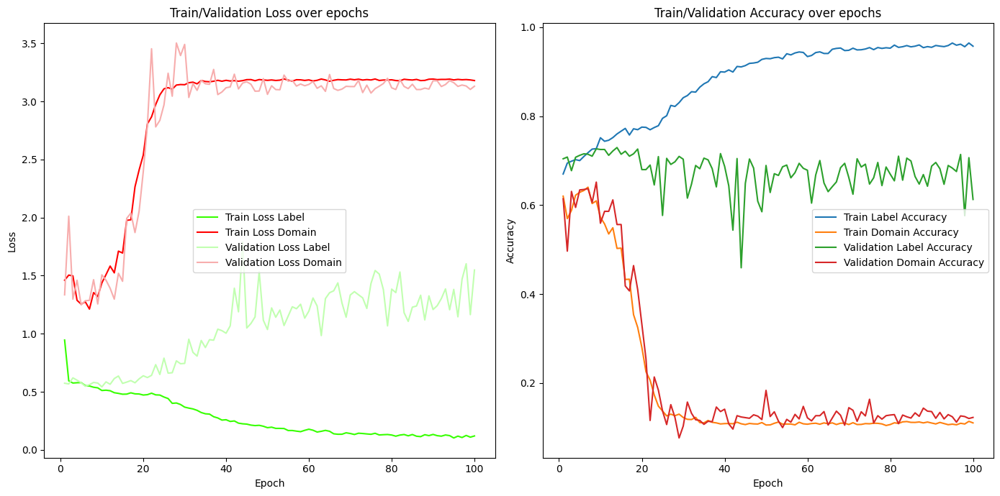

In [13]:
"""
import os
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from sklearn.preprocessing import LabelEncoder
from torch.utils.data import DataLoader, TensorDataset
import numpy as np
import umap
import seaborn as sns
import matplotlib.pyplot as plt
import pickle
import pandas as pd
from torchsummary import summary  # Para imprimir el resumen del modelo

# Configurar el dispositivo para GPU si está disponible, de lo contrario, usar CPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Usando dispositivo: {device}")

# Preparar los datos
X = df.iloc[:, :-2].values  # Datos de miRNAs
Y = df['vital'].values  # Estado vital
panels = df['panel'].values  # Etiquetas del dominio (paneles)
original_indices = df.index.values  # Guardar los índices originales

from sklearn.model_selection import train_test_split

# Dividir los datos en conjuntos de entrenamiento (80%) y validación (20%) de forma estratificada
X_train, X_val, Y_train, Y_val, panels_train, panels_val, indices_train, indices_val = train_test_split(
    X, Y, panels, original_indices, test_size=0.2, stratify=Y, random_state=42
)

# Convertir el estado vital y las etiquetas de dominio a valores numéricos
label_encoder_vital = LabelEncoder()
Y_train = label_encoder_vital.fit_transform(Y_train)
Y_val = label_encoder_vital.transform(Y_val)

label_encoder_panel = LabelEncoder()
panels_train = label_encoder_panel.fit_transform(panels_train)
panels_val = label_encoder_panel.transform(panels_val)

# Convertir los datos a tensores y moverlos al dispositivo
X_train_tensor = torch.tensor(X_train, dtype=torch.float32).to(device)
Y_train_tensor = torch.tensor(Y_train, dtype=torch.float32).unsqueeze(1).to(device)
panels_train_tensor = torch.tensor(panels_train, dtype=torch.long).to(device)

X_val_tensor = torch.tensor(X_val, dtype=torch.float32).to(device)
Y_val_tensor = torch.tensor(Y_val, dtype=torch.float32).unsqueeze(1).to(device)
panels_val_tensor = torch.tensor(panels_val, dtype=torch.long).to(device)

# Crear datasets y dataloaders
batch_size = 128
train_dataset = TensorDataset(X_train_tensor, Y_train_tensor, panels_train_tensor)
val_dataset = TensorDataset(X_val_tensor, Y_val_tensor, panels_val_tensor)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

# Definición del modelo DANN mejorado (igual al anterior)
class FeatureExtractor(nn.Module):
    def __init__(self, input_dim):
        super(FeatureExtractor, self).__init__()
        self.fc1 = nn.Linear(input_dim, 1000)
        self.bn1 = nn.BatchNorm1d(1000)
        self.dropout1 = nn.Dropout(0.1)

        # Inicialización de He
        nn.init.kaiming_normal_(self.fc1.weight, nonlinearity='leaky_relu')

    def forward(self, x, lambda_=1.0):
        x = F.leaky_relu(self.bn1(self.fc1(x)))
        x = self.dropout1(x)
        return x

class LabelPredictor(nn.Module):
    def __init__(self, input_dim):
        super(LabelPredictor, self).__init__()
        self.fc1 = nn.Linear(input_dim, 1000)
        self.bn1 = nn.BatchNorm1d(1000)
        self.dropout1 = nn.Dropout(0.1)
        self.fc2 = nn.Linear(1000, 1000)
        self.bn2 = nn.BatchNorm1d(1000)
        self.dropout2 = nn.Dropout(0.1)
        self.fc3 = nn.Linear(1000, 1)

        # Inicialización de He
        nn.init.kaiming_normal_(self.fc1.weight, nonlinearity='leaky_relu')
        nn.init.kaiming_normal_(self.fc2.weight, nonlinearity='leaky_relu')
        nn.init.kaiming_normal_(self.fc3.weight, nonlinearity='leaky_relu')

    def forward(self, x):
        x = F.leaky_relu(self.bn1(self.fc1(x)))
        x = self.dropout1(x)
        x = F.leaky_relu(self.bn2(self.fc2(x)))
        x = self.dropout2(x)
        x = torch.sigmoid(self.fc3(x))
        return x

class DomainClassifier(nn.Module):
    def __init__(self, input_dim, num_domains):
        super(DomainClassifier, self).__init__()
        self.fc1 = nn.Linear(input_dim, 1000)
        self.bn1 = nn.BatchNorm1d(1000)
        self.dropout1 = nn.Dropout(0.1)
        self.fc2 = nn.Linear(1000, 1000)
        self.bn2 = nn.BatchNorm1d(1000)
        self.dropout2 = nn.Dropout(0.1)
        self.fc3 = nn.Linear(1000, num_domains)

        # Inicialización de He
        nn.init.kaiming_normal_(self.fc1.weight, nonlinearity='leaky_relu')
        nn.init.kaiming_normal_(self.fc2.weight, nonlinearity='leaky_relu')
        nn.init.kaiming_normal_(self.fc3.weight, nonlinearity='leaky_relu')

    def forward(self, x):
        x = F.leaky_relu(self.bn1(self.fc1(x)))
        x = self.dropout1(x)
        x = F.leaky_relu(self.bn2(self.fc2(x)))
        x = self.dropout2(x)
        x = self.fc3(x)
        return x

class DANN(nn.Module):
    def __init__(self, feature_dim, num_domains):
        super(DANN, self).__init__()
        self.feature_extractor = FeatureExtractor(feature_dim)
        self.label_predictor = LabelPredictor(1000)
        self.domain_classifier = DomainClassifier(1000, num_domains)

    def forward(self, x, lambda_=1.0):
        features = self.feature_extractor(x)
        reverse_features = ReverseLayerF.apply(features, lambda_)
        label_output = self.label_predictor(features)
        domain_output = self.domain_classifier(reverse_features)
        return label_output, domain_output, features

class ReverseLayerF(torch.autograd.Function):
    @staticmethod
    def forward(ctx, x, lambda_):
        ctx.lambda_ = lambda_
        return x.view_as(x)

    @staticmethod
    def backward(ctx, grad_output):
        return grad_output.neg() * ctx.lambda_, None

# Parámetro tunable: lambda
lambda_ = 1

# Definir las funciones de pérdida
criterion_label = nn.BCELoss().to(device)
criterion_domain = nn.CrossEntropyLoss().to(device)

# Crear el modelo
input_dim = X.shape[1]
num_domains = len(label_encoder_panel.classes_)
model = DANN(input_dim, num_domains).to(device)

# Definir el optimizador AdamW
optimizer = optim.AdamW(
    model.parameters(),
    lr=0.01,  # Tasa de aprendizaje
    betas=(0.9, 0.99),  # Coeficientes beta
    eps=1e-8,  # Valor pequeño para estabilidad numérica
    weight_decay=0.01,  # Regularización L2
    amsgrad=False  # Si deseas usar la variante AMSGrad
)

# Inicializar listas para guardar pérdidas y accuracies
losses_label_train, losses_domain_train, losses_total_train = [], [], []
accuracies_label_train, accuracies_domain_train = [], []

losses_label_val, losses_domain_val, losses_total_val = [], [], []
accuracies_label_val, accuracies_domain_val = [], []

# Función para evaluar en el conjunto de validación
def evaluate_model(model, loader):
    model.eval()
    running_loss_label = 0.0
    running_loss_domain = 0.0
    correct_label = 0
    correct_domain = 0
    total = 0

    with torch.no_grad():
        for inputs, labels, domains in loader:
            inputs, labels, domains = inputs.to(device), labels.to(device), domains.to(device)

            label_preds, domain_preds, _ = model(inputs, lambda_)

            loss_label = criterion_label(label_preds, labels)
            loss_domain = criterion_domain(domain_preds, domains)

            running_loss_label += loss_label.item()
            running_loss_domain += loss_domain.item()

            predicted_label = (label_preds > 0.5).float()
            correct_label += (predicted_label == labels).sum().item()

            _, predicted_domain = torch.max(domain_preds, 1)
            correct_domain += (predicted_domain == domains).sum().item()

            total += labels.size(0)

    return running_loss_label / len(loader), running_loss_domain / len(loader), correct_label / total, correct_domain / total

# Entrenamiento
num_epochs = 100
for epoch in range(num_epochs):
    model.train()
    running_loss_label_train = 0.0
    running_loss_domain_train = 0.0
    correct_label_train = 0
    correct_domain_train = 0
    total_train = 0

    for i, (inputs, labels, domains) in enumerate(train_loader):
        inputs, labels, domains = inputs.to(device), labels.to(device), domains.to(device)

        # Forward pass
        label_preds, domain_preds, features = model(inputs, lambda_)

        # Cálculo de pérdidas
        loss_label = criterion_label(label_preds, labels)
        loss_domain = criterion_domain(domain_preds, domains)
        total_loss = loss_label + loss_domain

        # Reseteo de gradientes
        optimizer.zero_grad()

        # Backpropagation
        total_loss.backward()

        # Actualización de los parámetros del modelo
        optimizer.step()

        # Acumulación de pérdidas
        running_loss_label_train += loss_label.item()
        running_loss_domain_train += loss_domain.item()

        # Calcular accuracies
        predicted_label = (label_preds > 0.5).float()
        correct_label_train += (predicted_label == labels).sum().item()

        _, predicted_domain = torch.max(domain_preds, 1)
        correct_domain_train += (predicted_domain == domains).sum().item()

        total_train += labels.size(0)

    # Guardar métricas de entrenamiento
    losses_label_train.append(running_loss_label_train / len(train_loader))
    losses_domain_train.append(running_loss_domain_train / len(train_loader))
    losses_total_train.append((running_loss_label_train + running_loss_domain_train) / len(train_loader))
    accuracies_label_train.append(correct_label_train / total_train)
    accuracies_domain_train.append(correct_domain_train / total_train)

    # Evaluar en validación
    loss_label_val, loss_domain_val, accuracy_label_val, accuracy_domain_val = evaluate_model(model, val_loader)
    losses_label_val.append(loss_label_val)
    losses_domain_val.append(loss_domain_val)
    losses_total_val.append(loss_label_val + loss_domain_val)
    accuracies_label_val.append(accuracy_label_val)
    accuracies_domain_val.append(accuracy_domain_val)

    # Imprimir métricas por época
    print(f'Epoch [{epoch+1}/{num_epochs}], Train Loss Label: {losses_label_train[-1]:.4f}, Train Loss Domain: {losses_domain_train[-1]:.4f}, Train Total Loss: {losses_total_train[-1]:.4f}')
    print(f'Validation Loss Label: {losses_label_val[-1]:.4f}, Validation Loss Domain: {losses_domain_val[-1]:.4f}, Validation Total Loss: {losses_total_val[-1]:.4f}')
    print(f'Train Label Accuracy: {accuracies_label_train[-1]:.4f}, Train Domain Accuracy: {accuracies_domain_train[-1]:.4f}')
    print(f'Validation Label Accuracy: {accuracies_label_val[-1]:.4f}, Validation Domain Accuracy: {accuracies_domain_val[-1]:.4f}')

# Graficar las métricas
plt.figure(figsize=(14, 7))

# Pérdidas
plt.subplot(1, 2, 1)
plt.plot(range(1, num_epochs+1), losses_label_train, label='Train Loss Label',color='#37ff00')
plt.plot(range(1, num_epochs+1), losses_domain_train, label='Train Loss Domain', color= '#ff0000')
#plt.plot(range(1, num_epochs+1), losses_total_train, label='Train Total Loss')
plt.plot(range(1, num_epochs+1), losses_label_val, label='Validation Loss Label',color='#c1ffb0')
plt.plot(range(1, num_epochs+1), losses_domain_val, label='Validation Loss Domain', color = '#f7adad')
#plt.plot(range(1, num_epochs+1), losses_total_val, label='Validation Total Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Train/Validation Loss over epochs')
plt.legend()

# Accuracies
plt.subplot(1, 2, 2)
plt.plot(range(1, num_epochs+1), accuracies_label_train, label='Train Label Accuracy')
plt.plot(range(1, num_epochs+1), accuracies_domain_train, label='Train Domain Accuracy')
plt.plot(range(1, num_epochs+1), accuracies_label_val, label='Validation Label Accuracy')
plt.plot(range(1, num_epochs+1), accuracies_domain_val, label='Validation Domain Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Train/Validation Accuracy over epochs')
plt.legend()

plt.tight_layout()
plt.show()
"""

Usando dispositivo: cuda
Epoch [1/30]
--------------------------------------------------
Train Loss Label: 0.8495
Train Loss Domain: 1.1673
Train Total Loss: 2.0169

Validation Loss Label: 0.5440
Validation Loss Domain: 0.5880
Validation Total Loss: 1.1320

Train Label Accuracy: 0.6805
Train Domain Accuracy: 0.6852

Validation Label Accuracy: 0.7342
Validation Domain Accuracy: 0.8251
--------------------------------------------------
Modelo guardado: model_checkpoints/model_epoch_1.pth
Epoch [2/30]
--------------------------------------------------
Train Loss Label: 0.5506
Train Loss Domain: 0.5447
Train Total Loss: 1.0953

Validation Loss Label: 0.5479
Validation Loss Domain: 0.5246
Validation Total Loss: 1.0725

Train Label Accuracy: 0.7276
Train Domain Accuracy: 0.8294

Validation Label Accuracy: 0.7206
Validation Domain Accuracy: 0.8382
--------------------------------------------------
Modelo guardado: model_checkpoints/model_epoch_2.pth
Epoch [3/30]
------------------------------

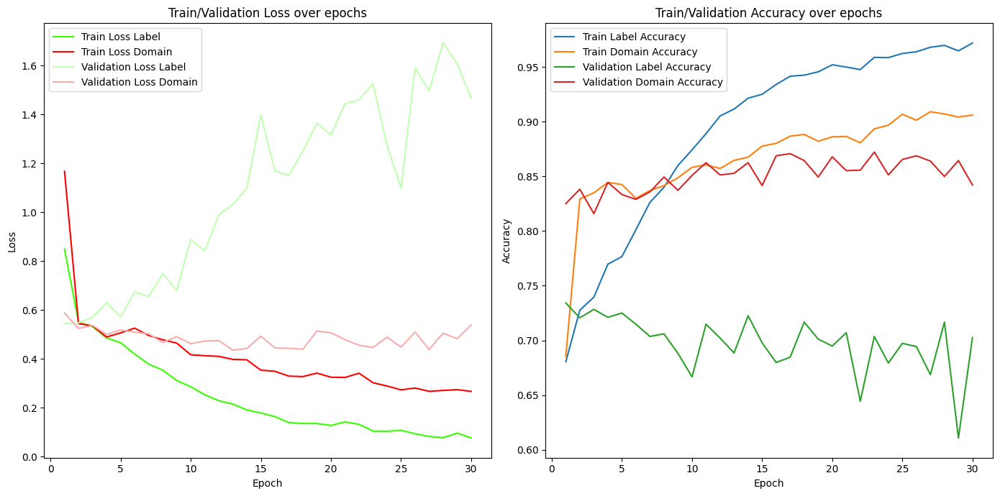

In [14]:
import os
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from sklearn.preprocessing import LabelEncoder
from torch.utils.data import DataLoader, TensorDataset
import numpy as np
import umap
import seaborn as sns
import matplotlib.pyplot as plt
import pickle
import pandas as pd
from torchsummary import summary  # Para imprimir el resumen del modelo

# Configurar el dispositivo para GPU si está disponible, de lo contrario, usar CPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Usando dispositivo: {device}")

# Preparar los datos
X = df.iloc[:, :-2].values  # Datos de miRNAs
Y = df['vital'].values  # Estado vital
panels = df['panel'].values  # Etiquetas del dominio (paneles)
original_indices = df.index.values  # Guardar los índices originales

from sklearn.model_selection import train_test_split

# Dividir los datos en conjuntos de entrenamiento (80%) y validación (20%) de forma estratificada
X_train, X_val, Y_train, Y_val, panels_train, panels_val, indices_train, indices_val = train_test_split(
    X, Y, panels, original_indices, test_size=0.2, stratify=Y, random_state=42
)

# Convertir el estado vital y las etiquetas de dominio a valores numéricos
label_encoder_vital = LabelEncoder()
Y_train = label_encoder_vital.fit_transform(Y_train)
Y_val = label_encoder_vital.transform(Y_val)

label_encoder_panel = LabelEncoder()
panels_train = label_encoder_panel.fit_transform(panels_train)
panels_val = label_encoder_panel.transform(panels_val)

# Convertir los datos a tensores y moverlos al dispositivo
X_train_tensor = torch.tensor(X_train, dtype=torch.float32).to(device)
Y_train_tensor = torch.tensor(Y_train, dtype=torch.float32).unsqueeze(1).to(device)
panels_train_tensor = torch.tensor(panels_train, dtype=torch.long).to(device)

X_val_tensor = torch.tensor(X_val, dtype=torch.float32).to(device)
Y_val_tensor = torch.tensor(Y_val, dtype=torch.float32).unsqueeze(1).to(device)
panels_val_tensor = torch.tensor(panels_val, dtype=torch.long).to(device)

# Crear datasets y dataloaders
batch_size = 128
train_dataset = TensorDataset(X_train_tensor, Y_train_tensor, panels_train_tensor)
val_dataset = TensorDataset(X_val_tensor, Y_val_tensor, panels_val_tensor)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

# Definición del modelo DANN mejorado (igual al anterior)
class FeatureExtractor(nn.Module):
    def __init__(self, input_dim):
        super(FeatureExtractor, self).__init__()
        self.fc1 = nn.Linear(input_dim, 1000)
        self.bn1 = nn.BatchNorm1d(1000)
        self.dropout1 = nn.Dropout(0.1)

        # Inicialización de He
        nn.init.kaiming_normal_(self.fc1.weight, nonlinearity='leaky_relu')

    def forward(self, x, lambda_=1.0):
        x = F.leaky_relu(self.bn1(self.fc1(x)))
        x = self.dropout1(x)
        return x

class LabelPredictor(nn.Module):
    def __init__(self, input_dim):
        super(LabelPredictor, self).__init__()
        self.fc1 = nn.Linear(input_dim, 1000)
        self.bn1 = nn.BatchNorm1d(1000)
        self.dropout1 = nn.Dropout(0.1)
        self.fc2 = nn.Linear(1000, 1000)
        self.bn2 = nn.BatchNorm1d(1000)
        self.dropout2 = nn.Dropout(0.1)
        self.fc3 = nn.Linear(1000, 1)

        # Inicialización de He
        nn.init.kaiming_normal_(self.fc1.weight, nonlinearity='leaky_relu')
        nn.init.kaiming_normal_(self.fc2.weight, nonlinearity='leaky_relu')
        nn.init.kaiming_normal_(self.fc3.weight, nonlinearity='leaky_relu')

    def forward(self, x):
        x = F.leaky_relu(self.bn1(self.fc1(x)))
        x = self.dropout1(x)
        x = F.leaky_relu(self.bn2(self.fc2(x)))
        x = self.dropout2(x)
        x = torch.sigmoid(self.fc3(x))
        return x

class DomainClassifier(nn.Module):
    def __init__(self, input_dim, num_domains):
        super(DomainClassifier, self).__init__()
        self.fc1 = nn.Linear(input_dim, 1000)
        self.bn1 = nn.BatchNorm1d(1000)
        self.dropout1 = nn.Dropout(0.1)
        self.fc2 = nn.Linear(1000, 1000)
        self.bn2 = nn.BatchNorm1d(1000)
        self.dropout2 = nn.Dropout(0.1)
        self.fc3 = nn.Linear(1000, num_domains)

        # Inicialización de He
        nn.init.kaiming_normal_(self.fc1.weight, nonlinearity='leaky_relu')
        nn.init.kaiming_normal_(self.fc2.weight, nonlinearity='leaky_relu')
        nn.init.kaiming_normal_(self.fc3.weight, nonlinearity='leaky_relu')

    def forward(self, x):
        x = F.leaky_relu(self.bn1(self.fc1(x)))
        x = self.dropout1(x)
        x = F.leaky_relu(self.bn2(self.fc2(x)))
        x = self.dropout2(x)
        x = self.fc3(x)
        return x

class DANN(nn.Module):
    def __init__(self, feature_dim, num_domains):
        super(DANN, self).__init__()
        self.feature_extractor = FeatureExtractor(feature_dim)
        self.label_predictor = LabelPredictor(1000)
        self.domain_classifier = DomainClassifier(1000, num_domains)

    def forward(self, x, lambda_=1.0):
        features = self.feature_extractor(x)
        reverse_features = ReverseLayerF.apply(features, lambda_)
        label_output = self.label_predictor(features)
        domain_output = self.domain_classifier(reverse_features)
        return label_output, domain_output, features

class ReverseLayerF(torch.autograd.Function):
    @staticmethod
    def forward(ctx, x, lambda_):
        ctx.lambda_ = lambda_
        return x.view_as(x)

    @staticmethod
    def backward(ctx, grad_output):
        return grad_output.neg() * ctx.lambda_, None

# Parámetro tunable: lambda
lambda_ = 0.01

# Definir las funciones de pérdida
criterion_label = nn.BCELoss().to(device)
criterion_domain = nn.CrossEntropyLoss().to(device)

# Crear el modelo
input_dim = X.shape[1]
num_domains = len(label_encoder_panel.classes_)
model = DANN(input_dim, num_domains).to(device)

# Definir el optimizador AdamW
optimizer = optim.AdamW(
    model.parameters(),
    lr=0.01,  # Tasa de aprendizaje
    betas=(0.9, 0.99),  # Coeficientes beta
    eps=1e-8,  # Valor pequeño para estabilidad numérica
    weight_decay=0.01,  # Regularización L2
    amsgrad=False  # Si deseas usar la variante AMSGrad
)

# Crear una carpeta para guardar los modelos si no existe
model_dir = 'model_checkpoints'
os.makedirs(model_dir, exist_ok=True)

# Inicializar listas para guardar pérdidas y accuracies
losses_label_train, losses_domain_train, losses_total_train = [], [], []
accuracies_label_train, accuracies_domain_train = [], []

losses_label_val, losses_domain_val, losses_total_val = [], [], []
accuracies_label_val, accuracies_domain_val = [], []

# Función para evaluar en el conjunto de validación
def evaluate_model(model, loader):
    model.eval()
    running_loss_label = 0.0
    running_loss_domain = 0.0
    correct_label = 0
    correct_domain = 0
    total = 0

    with torch.no_grad():
        for inputs, labels, domains in loader:
            inputs, labels, domains = inputs.to(device), labels.to(device), domains.to(device)

            label_preds, domain_preds, _ = model(inputs, lambda_)

            loss_label = criterion_label(label_preds, labels)
            loss_domain = criterion_domain(domain_preds, domains)

            running_loss_label += loss_label.item()
            running_loss_domain += loss_domain.item()

            predicted_label = (label_preds > 0.5).float()
            correct_label += (predicted_label == labels).sum().item()

            _, predicted_domain = torch.max(domain_preds, 1)
            correct_domain += (predicted_domain == domains).sum().item()

            total += labels.size(0)

    return running_loss_label / len(loader), running_loss_domain / len(loader), correct_label / total, correct_domain / total

# Entrenamiento
num_epochs = 30
for epoch in range(num_epochs):
    model.train()
    running_loss_label_train = 0.0
    running_loss_domain_train = 0.0
    correct_label_train = 0
    correct_domain_train = 0
    total_train = 0

    for i, (inputs, labels, domains) in enumerate(train_loader):
        inputs, labels, domains = inputs.to(device), labels.to(device), domains.to(device)

        # Forward pass
        label_preds, domain_preds, features = model(inputs, lambda_)

        # Cálculo de pérdidas
        loss_label = criterion_label(label_preds, labels)
        loss_domain = criterion_domain(domain_preds, domains)
        total_loss = loss_label + loss_domain

        # Reseteo de gradientes
        optimizer.zero_grad()

        # Backpropagation
        total_loss.backward()

        # Actualización de los parámetros del modelo
        optimizer.step()

        # Acumulación de pérdidas
        running_loss_label_train += loss_label.item()
        running_loss_domain_train += loss_domain.item()

        # Calcular accuracies
        predicted_label = (label_preds > 0.5).float()
        correct_label_train += (predicted_label == labels).sum().item()

        _, predicted_domain = torch.max(domain_preds, 1)
        correct_domain_train += (predicted_domain == domains).sum().item()

        total_train += labels.size(0)

    # Guardar métricas de entrenamiento
    losses_label_train.append(running_loss_label_train / len(train_loader))
    losses_domain_train.append(running_loss_domain_train / len(train_loader))
    losses_total_train.append((running_loss_label_train + running_loss_domain_train) / len(train_loader))
    accuracies_label_train.append(correct_label_train / total_train)
    accuracies_domain_train.append(correct_domain_train / total_train)

    # Evaluar en validación
    loss_label_val, loss_domain_val, accuracy_label_val, accuracy_domain_val = evaluate_model(model, val_loader)
    losses_label_val.append(loss_label_val)
    losses_domain_val.append(loss_domain_val)
    losses_total_val.append(loss_label_val + loss_domain_val)
    accuracies_label_val.append(accuracy_label_val)
    accuracies_domain_val.append(accuracy_domain_val)

    # Imprimir métricas por época
    print(f'Epoch [{epoch+1}/{num_epochs}]')
    print('-' * 50)
    print(f'Train Loss Label: {losses_label_train[-1]:.4f}')
    print(f'Train Loss Domain: {losses_domain_train[-1]:.4f}')
    print(f'Train Total Loss: {losses_total_train[-1]:.4f}')
    print()
    print(f'Validation Loss Label: {losses_label_val[-1]:.4f}')
    print(f'Validation Loss Domain: {losses_domain_val[-1]:.4f}')
    print(f'Validation Total Loss: {losses_total_val[-1]:.4f}')
    print()
    print(f'Train Label Accuracy: {accuracies_label_train[-1]:.4f}')
    print(f'Train Domain Accuracy: {accuracies_domain_train[-1]:.4f}')
    print()
    print(f'Validation Label Accuracy: {accuracies_label_val[-1]:.4f}')
    print(f'Validation Domain Accuracy: {accuracies_domain_val[-1]:.4f}')
    print('-' * 50)


    # Guardar el modelo de la iteración actual
    model_path = os.path.join(model_dir, f'model_epoch_{epoch+1}.pth')
    torch.save(model.state_dict(), model_path)
    print(f'Modelo guardado: {model_path}')

# Graficar las métricas
plt.figure(figsize=(14, 7))

# Pérdidas
plt.subplot(1, 2, 1)
plt.plot(range(1, num_epochs+1), losses_label_train, label='Train Loss Label', color='#37ff00')
plt.plot(range(1, num_epochs+1), losses_domain_train, label='Train Loss Domain', color= '#ff0000')
plt.plot(range(1, num_epochs+1), losses_label_val, label='Validation Loss Label', color='#c1ffb0')
plt.plot(range(1, num_epochs+1), losses_domain_val, label='Validation Loss Domain', color = '#f7adad')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Train/Validation Loss over epochs')
plt.legend()

# Accuracies
plt.subplot(1, 2, 2)
plt.plot(range(1, num_epochs+1), accuracies_label_train, label='Train Label Accuracy')
plt.plot(range(1, num_epochs+1), accuracies_domain_train, label='Train Domain Accuracy')
plt.plot(range(1, num_epochs+1), accuracies_label_val, label='Validation Label Accuracy')
plt.plot(range(1, num_epochs+1), accuracies_domain_val, label='Validation Domain Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Train/Validation Accuracy over epochs')
plt.legend()

plt.tight_layout()
plt.show()


In [15]:
X.shape

(10286, 39979)

In [16]:
!pip install prettytable

<ipython-input-17-2c387bc12976>:37: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


Modelo de la época 30 cargado exitosamente.

+-----------------------+------------------+------------+
|   Nombre de la capa   |   Tipo de capa   | Parámetros |
+-----------------------+------------------+------------+
|                       |       DANN       |  44028034  |
|   feature_extractor   | FeatureExtractor |  39982000  |
| feature_extractor.fc1 |      Linear      |  39980000  |
| feature_extractor.bn1 |   BatchNorm1d    |    2000    |
|    label_predictor    |  LabelPredictor  |  2007001   |
|  label_predictor.fc1  |      Linear      |  1001000   |
|  label_predictor.bn1  |   BatchNorm1d    |    2000    |
|  label_predictor.fc2  |      Linear      |  1001000   |
|  label_predictor.bn2  |   BatchNorm1d    |    2000    |
|  label_predictor.fc3  |      Linear      |    1001    |
|   domain_classifier   | DomainClassifier |  2039033   |
| domain_classifier.fc1 |      Linear      |  1001000   |
| domain_classifier.bn1 |   BatchNorm1d    |    2000    |
| domain_classifier.fc2 |  

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


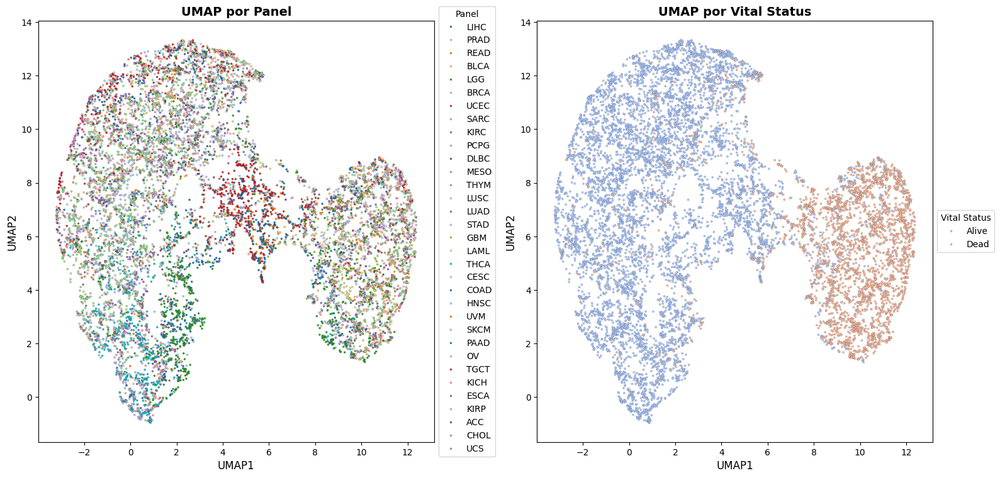

In [17]:
import os
import torch
import umap
import pandas as pd
import numpy as np
from prettytable import PrettyTable
from torch.utils.data import DataLoader, TensorDataset
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import LabelEncoder

def process_model_and_umap(df, epoch_to_load, layer_of_interest, device='cpu', batch_size=128):
    # Preparar los datos del DataFrame
    X = df.iloc[:, :-2].values  # Datos de las características (miRNAs u otras variables)
    Y = df['vital'].replace({'Alive': 1, 'Dead': 0}).values  # Estado vital
    panels = df['panel'].values  # Etiquetas del dominio (paneles)
    indices = df.index.values  # Mantener los índices originales como cadenas

    # Convertir la columna 'panel' a valores numéricos usando LabelEncoder
    label_encoder_panel = LabelEncoder()
    panels = label_encoder_panel.fit_transform(panels)

    # Convertir los datos en tensores para PyTorch
    X_tensor = torch.tensor(X, dtype=torch.float32).to(device)
    Y_tensor = torch.tensor(Y, dtype=torch.float32).unsqueeze(1).to(device)
    panels_tensor = torch.tensor(panels, dtype=torch.long).to(device)

    # Crear el DataLoader
    dataset = TensorDataset(X_tensor, Y_tensor, panels_tensor)
    loader = DataLoader(dataset, batch_size=batch_size, shuffle=False)

    # Cargar el modelo de la época deseada
    model_path = os.path.join('model_checkpoints', f'model_epoch_{epoch_to_load}.pth')
    input_dim = X.shape[1]
    num_domains = len(label_encoder_panel.classes_)
    model = DANN(input_dim, num_domains).to(device)
    model.load_state_dict(torch.load(model_path))
    model.eval()

    # Mostrar información del modelo
    print(f"Modelo de la época {epoch_to_load} cargado exitosamente.\n")
    table = PrettyTable(["Nombre de la capa", "Tipo de capa", "Parámetros"])
    for name, layer in model.named_modules():
        num_params = sum(p.numel() for p in layer.parameters())
        if num_params > 0:
            table.add_row([name, layer.__class__.__name__, num_params])
    print(table)
    # Función para extraer características solo de las capas lineales
    def extract_features(model, loader, layer_name, indices, device):
        model.eval()
        features_list, labels_list, panels_list, indices_list = [], [], [], []

        with torch.no_grad():
            for i, (inputs, labels, domains) in enumerate(loader):
                inputs = inputs.to(device)

                # Extraer características de las capas lineales de interés
                if layer_name == 'feature_extractor.fc1':
                    features = model.feature_extractor.fc1(inputs)
                elif layer_name == 'label_predictor.fc1':
                    features = model.label_predictor.fc1(model.feature_extractor(inputs))
                elif layer_name == 'label_predictor.fc2':
                    features = model.label_predictor.fc2(model.label_predictor.fc1(model.feature_extractor(inputs)))
                elif layer_name == 'label_predictor.fc3':
                    features = model.label_predictor.fc3(model.label_predictor.fc2(model.label_predictor.fc1(model.feature_extractor(inputs))))
                elif layer_name == 'domain_classifier.fc1':
                    features = model.domain_classifier.fc1(model.feature_extractor(inputs))
                elif layer_name == 'domain_classifier.fc2':
                    features = model.domain_classifier.fc2(model.domain_classifier.fc1(model.feature_extractor(inputs)))
                elif layer_name == 'domain_classifier.fc3':
                    features = model.domain_classifier.fc3(model.domain_classifier.fc2(model.domain_classifier.fc1(model.feature_extractor(inputs))))
                else:
                    raise ValueError(f"Capa no reconocida: {layer_name}")

                features_list.append(features.cpu().numpy())
                labels_list.append(labels.cpu().numpy())
                panels_list.append(domains.cpu().numpy())
                indices_list.append(indices[i * batch_size:(i + 1) * batch_size])

        all_features = np.concatenate(features_list, axis=0)
        all_labels = np.concatenate(labels_list, axis=0)
        all_panels = np.concatenate(panels_list, axis=0)
        all_indices = np.concatenate(indices_list, axis=0)

        return all_features, all_labels, all_panels, all_indices


    # Extraer características
    all_features, all_labels, all_panels, all_indices = extract_features(model, loader, layer_of_interest, indices, device)

    # Aplicar UMAP
    def apply_umap(features):
        reducer = umap.UMAP(n_neighbors=15, min_dist=0.1, n_components=2, random_state=42)
        umap_coords = reducer.fit_transform(features)
        return umap_coords

    umap_coords = apply_umap(all_features)

    # Crear DataFrame final
    df_umap = pd.DataFrame(umap_coords, columns=['UMAP1', 'UMAP2'])
    df_umap['vital_status'] = all_labels
    df_umap['panel'] = all_panels
    df_umap['index'] = all_indices
    df_final = df_umap.merge(df, left_on='index', right_index=True)

    # Visualización con seaborn
    fig, axes = plt.subplots(1, 2, figsize=(16, 8))

    sns.scatterplot(ax=axes[0], x='UMAP1', y='UMAP2', hue='panel_y', data=df_final,
                    palette='tab20', legend='full', s=5, edgecolor='black', linewidth=0.1)
    axes[0].set_title('UMAP por Panel', fontsize=14, weight='bold')
    axes[0].set_xlabel('UMAP1', fontsize=12)
    axes[0].set_ylabel('UMAP2', fontsize=12)
    axes[0].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='Panel')

    sns.scatterplot(ax=axes[1], x='UMAP1', y='UMAP2', hue='vital', data=df_final,
                    palette='coolwarm', legend='full', s=5, edgecolor='black', linewidth=0.1)
    axes[1].set_title('UMAP por Vital Status', fontsize=14, weight='bold')
    axes[1].set_xlabel('UMAP1', fontsize=12)
    axes[1].set_ylabel('UMAP2', fontsize=12)
    axes[1].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='Vital Status')

    plt.tight_layout()
    plt.show()

    return df_final[['UMAP1', 'UMAP2', 'index', 'vital', 'panel_y']]

# Uso de la función
df_coords = process_model_and_umap(df, epoch_to_load=30, layer_of_interest='label_predictor.fc2', device='cuda')


In [18]:
df_coords

,UMAP1,UMAP2,index,vital,panel_y
0,3.315575,5.548252,9fe7d0f4-866d-490f-b2cb-d9be7da889de,Alive,LIHC
1,-1.307040,9.362494,dd74434f-300f-4798-8342-aad31b192e12,Alive,PRAD
2,10.324514,8.523129,07db9e9d-059d-4e6c-b483-81517a492b96,Dead,READ
3,0.890576,-0.831648,47ee860a-fd18-48f2-bfe7-4e19391950bd,Alive,LIHC
4,11.661679,8.389454,e322b0e5-458a-4cbf-a64f-9b348e413939,Dead,BLCA
...,...,...,...,...,...
10281,9.027594,7.064115,62cb41b1-8960-4fa2-8f74-38dd174af004,Dead,KIRC
10282,5.105608,12.059362,673a85f3-ba5e-448a-acee-dfec77b5238e,Alive,UCS
10283,2.547596,3.885732,3d93b2ae-7730-4914-af23-ff3554752922,Alive,LGG
10284,5.790080,8.589130,85a0b88f-2b89-4117-9e04-b81fad7f2e1b,Alive,LAML


<ipython-input-17-2c387bc12976>:37: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


Modelo de la época 1 cargado exitosamente.

+-----------------------+------------------+------------+
|   Nombre de la capa   |   Tipo de capa   | Parámetros |
+-----------------------+------------------+------------+
|                       |       DANN       |  44028034  |
|   feature_extractor   | FeatureExtractor |  39982000  |
| feature_extractor.fc1 |      Linear      |  39980000  |
| feature_extractor.bn1 |   BatchNorm1d    |    2000    |
|    label_predictor    |  LabelPredictor  |  2007001   |
|  label_predictor.fc1  |      Linear      |  1001000   |
|  label_predictor.bn1  |   BatchNorm1d    |    2000    |
|  label_predictor.fc2  |      Linear      |  1001000   |
|  label_predictor.bn2  |   BatchNorm1d    |    2000    |
|  label_predictor.fc3  |      Linear      |    1001    |
|   domain_classifier   | DomainClassifier |  2039033   |
| domain_classifier.fc1 |      Linear      |  1001000   |
| domain_classifier.bn1 |   BatchNorm1d    |    2000    |
| domain_classifier.fc2 |   

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


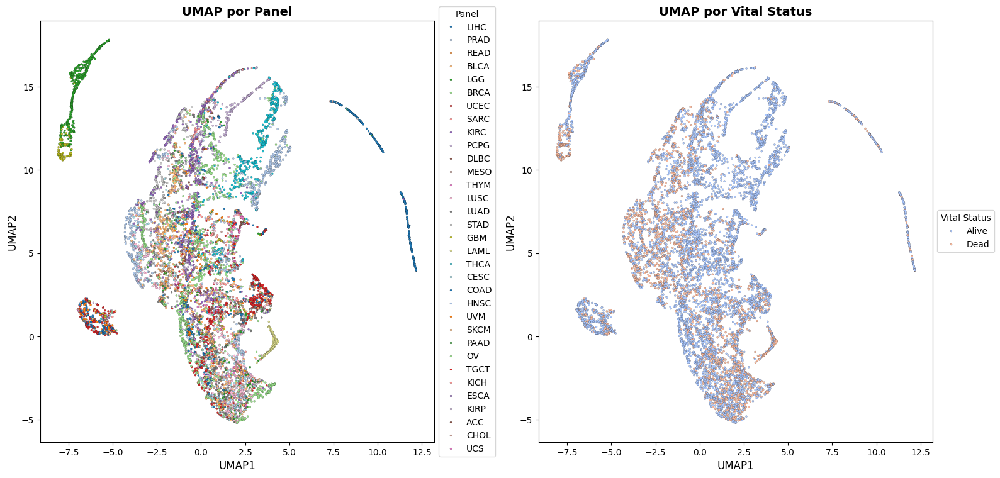

<ipython-input-17-2c387bc12976>:37: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


Modelo de la época 2 cargado exitosamente.

+-----------------------+------------------+------------+
|   Nombre de la capa   |   Tipo de capa   | Parámetros |
+-----------------------+------------------+------------+
|                       |       DANN       |  44028034  |
|   feature_extractor   | FeatureExtractor |  39982000  |
| feature_extractor.fc1 |      Linear      |  39980000  |
| feature_extractor.bn1 |   BatchNorm1d    |    2000    |
|    label_predictor    |  LabelPredictor  |  2007001   |
|  label_predictor.fc1  |      Linear      |  1001000   |
|  label_predictor.bn1  |   BatchNorm1d    |    2000    |
|  label_predictor.fc2  |      Linear      |  1001000   |
|  label_predictor.bn2  |   BatchNorm1d    |    2000    |
|  label_predictor.fc3  |      Linear      |    1001    |
|   domain_classifier   | DomainClassifier |  2039033   |
| domain_classifier.fc1 |      Linear      |  1001000   |
| domain_classifier.bn1 |   BatchNorm1d    |    2000    |
| domain_classifier.fc2 |   

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


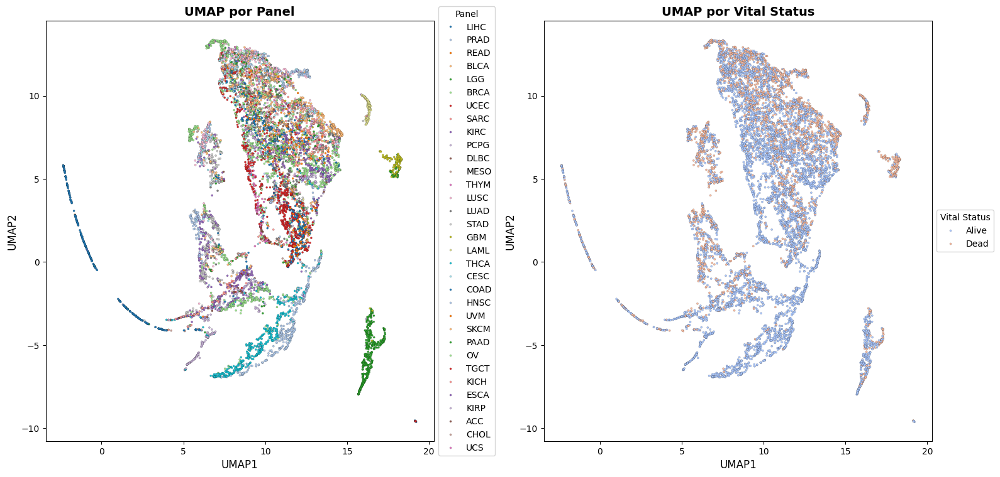

<ipython-input-17-2c387bc12976>:37: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


Modelo de la época 3 cargado exitosamente.

+-----------------------+------------------+------------+
|   Nombre de la capa   |   Tipo de capa   | Parámetros |
+-----------------------+------------------+------------+
|                       |       DANN       |  44028034  |
|   feature_extractor   | FeatureExtractor |  39982000  |
| feature_extractor.fc1 |      Linear      |  39980000  |
| feature_extractor.bn1 |   BatchNorm1d    |    2000    |
|    label_predictor    |  LabelPredictor  |  2007001   |
|  label_predictor.fc1  |      Linear      |  1001000   |
|  label_predictor.bn1  |   BatchNorm1d    |    2000    |
|  label_predictor.fc2  |      Linear      |  1001000   |
|  label_predictor.bn2  |   BatchNorm1d    |    2000    |
|  label_predictor.fc3  |      Linear      |    1001    |
|   domain_classifier   | DomainClassifier |  2039033   |
| domain_classifier.fc1 |      Linear      |  1001000   |
| domain_classifier.bn1 |   BatchNorm1d    |    2000    |
| domain_classifier.fc2 |   

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


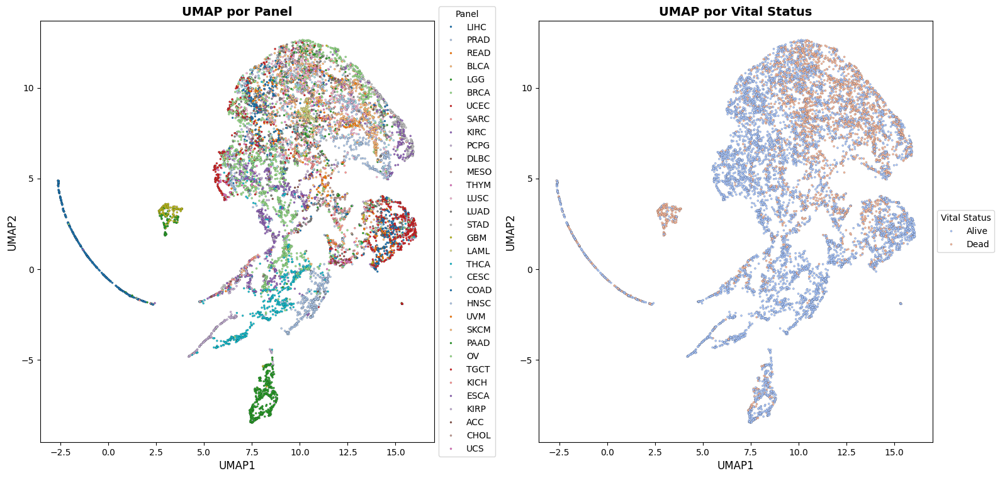

<ipython-input-17-2c387bc12976>:37: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


Modelo de la época 4 cargado exitosamente.

+-----------------------+------------------+------------+
|   Nombre de la capa   |   Tipo de capa   | Parámetros |
+-----------------------+------------------+------------+
|                       |       DANN       |  44028034  |
|   feature_extractor   | FeatureExtractor |  39982000  |
| feature_extractor.fc1 |      Linear      |  39980000  |
| feature_extractor.bn1 |   BatchNorm1d    |    2000    |
|    label_predictor    |  LabelPredictor  |  2007001   |
|  label_predictor.fc1  |      Linear      |  1001000   |
|  label_predictor.bn1  |   BatchNorm1d    |    2000    |
|  label_predictor.fc2  |      Linear      |  1001000   |
|  label_predictor.bn2  |   BatchNorm1d    |    2000    |
|  label_predictor.fc3  |      Linear      |    1001    |
|   domain_classifier   | DomainClassifier |  2039033   |
| domain_classifier.fc1 |      Linear      |  1001000   |
| domain_classifier.bn1 |   BatchNorm1d    |    2000    |
| domain_classifier.fc2 |   

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


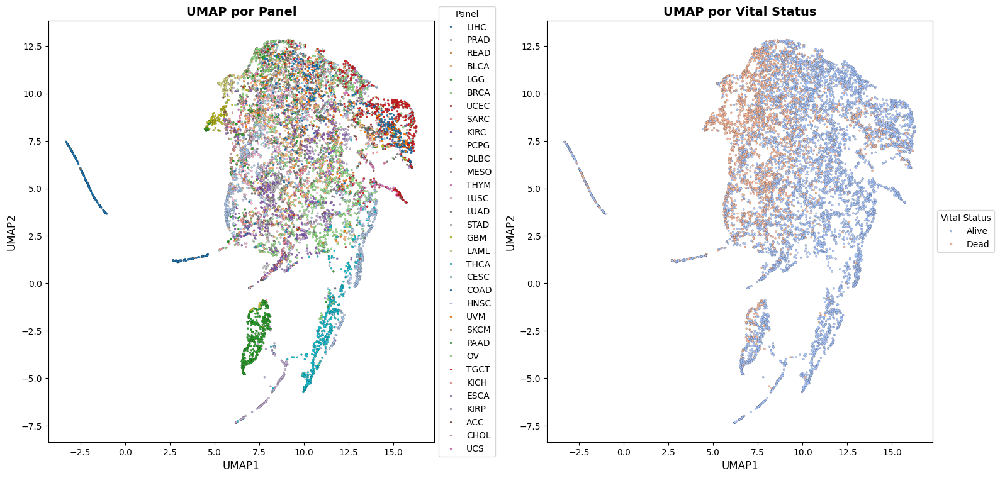

<ipython-input-17-2c387bc12976>:37: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


Modelo de la época 5 cargado exitosamente.

+-----------------------+------------------+------------+
|   Nombre de la capa   |   Tipo de capa   | Parámetros |
+-----------------------+------------------+------------+
|                       |       DANN       |  44028034  |
|   feature_extractor   | FeatureExtractor |  39982000  |
| feature_extractor.fc1 |      Linear      |  39980000  |
| feature_extractor.bn1 |   BatchNorm1d    |    2000    |
|    label_predictor    |  LabelPredictor  |  2007001   |
|  label_predictor.fc1  |      Linear      |  1001000   |
|  label_predictor.bn1  |   BatchNorm1d    |    2000    |
|  label_predictor.fc2  |      Linear      |  1001000   |
|  label_predictor.bn2  |   BatchNorm1d    |    2000    |
|  label_predictor.fc3  |      Linear      |    1001    |
|   domain_classifier   | DomainClassifier |  2039033   |
| domain_classifier.fc1 |      Linear      |  1001000   |
| domain_classifier.bn1 |   BatchNorm1d    |    2000    |
| domain_classifier.fc2 |   

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


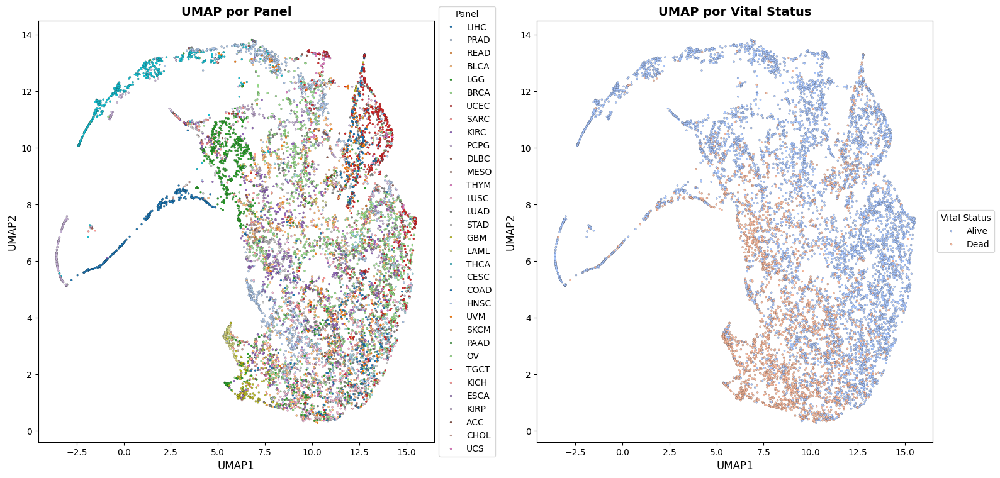

<ipython-input-17-2c387bc12976>:37: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


Modelo de la época 6 cargado exitosamente.

+-----------------------+------------------+------------+
|   Nombre de la capa   |   Tipo de capa   | Parámetros |
+-----------------------+------------------+------------+
|                       |       DANN       |  44028034  |
|   feature_extractor   | FeatureExtractor |  39982000  |
| feature_extractor.fc1 |      Linear      |  39980000  |
| feature_extractor.bn1 |   BatchNorm1d    |    2000    |
|    label_predictor    |  LabelPredictor  |  2007001   |
|  label_predictor.fc1  |      Linear      |  1001000   |
|  label_predictor.bn1  |   BatchNorm1d    |    2000    |
|  label_predictor.fc2  |      Linear      |  1001000   |
|  label_predictor.bn2  |   BatchNorm1d    |    2000    |
|  label_predictor.fc3  |      Linear      |    1001    |
|   domain_classifier   | DomainClassifier |  2039033   |
| domain_classifier.fc1 |      Linear      |  1001000   |
| domain_classifier.bn1 |   BatchNorm1d    |    2000    |
| domain_classifier.fc2 |   

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


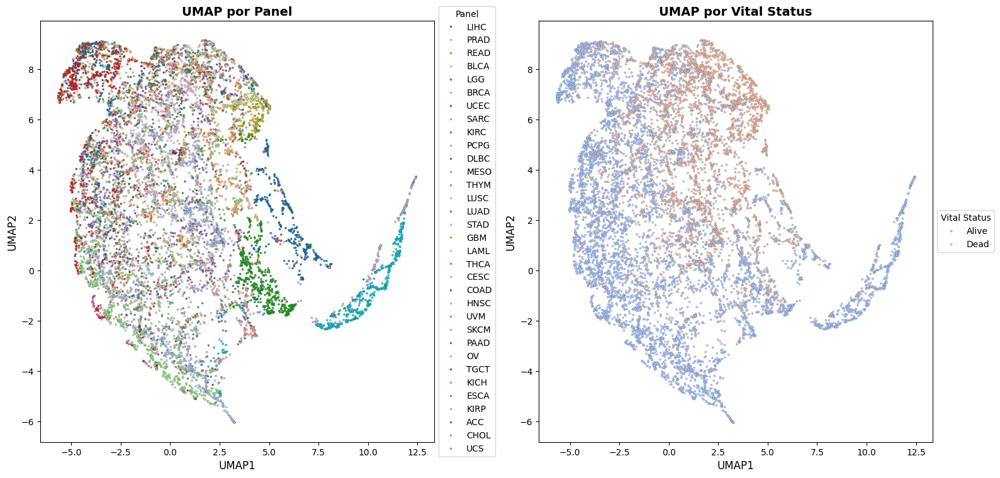

<ipython-input-17-2c387bc12976>:37: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


Modelo de la época 7 cargado exitosamente.

+-----------------------+------------------+------------+
|   Nombre de la capa   |   Tipo de capa   | Parámetros |
+-----------------------+------------------+------------+
|                       |       DANN       |  44028034  |
|   feature_extractor   | FeatureExtractor |  39982000  |
| feature_extractor.fc1 |      Linear      |  39980000  |
| feature_extractor.bn1 |   BatchNorm1d    |    2000    |
|    label_predictor    |  LabelPredictor  |  2007001   |
|  label_predictor.fc1  |      Linear      |  1001000   |
|  label_predictor.bn1  |   BatchNorm1d    |    2000    |
|  label_predictor.fc2  |      Linear      |  1001000   |
|  label_predictor.bn2  |   BatchNorm1d    |    2000    |
|  label_predictor.fc3  |      Linear      |    1001    |
|   domain_classifier   | DomainClassifier |  2039033   |
| domain_classifier.fc1 |      Linear      |  1001000   |
| domain_classifier.bn1 |   BatchNorm1d    |    2000    |
| domain_classifier.fc2 |   

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


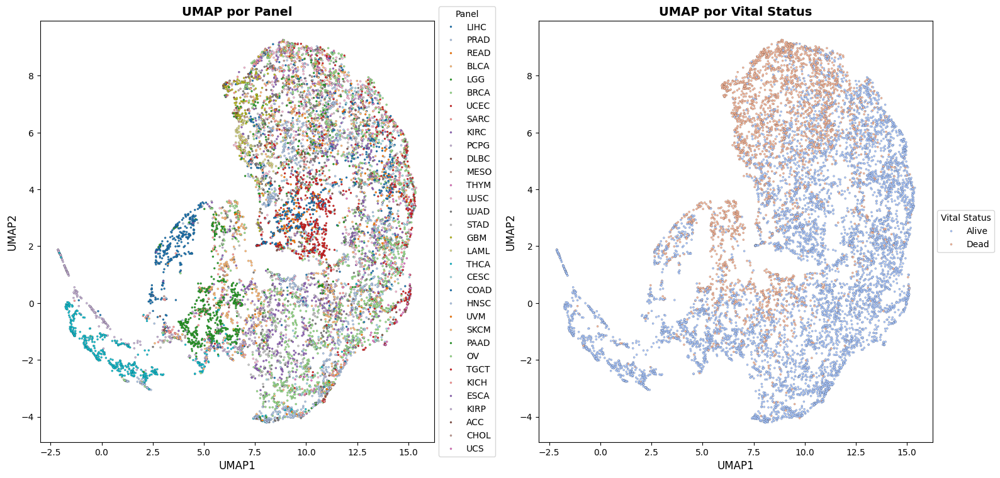

<ipython-input-17-2c387bc12976>:37: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


Modelo de la época 8 cargado exitosamente.

+-----------------------+------------------+------------+
|   Nombre de la capa   |   Tipo de capa   | Parámetros |
+-----------------------+------------------+------------+
|                       |       DANN       |  44028034  |
|   feature_extractor   | FeatureExtractor |  39982000  |
| feature_extractor.fc1 |      Linear      |  39980000  |
| feature_extractor.bn1 |   BatchNorm1d    |    2000    |
|    label_predictor    |  LabelPredictor  |  2007001   |
|  label_predictor.fc1  |      Linear      |  1001000   |
|  label_predictor.bn1  |   BatchNorm1d    |    2000    |
|  label_predictor.fc2  |      Linear      |  1001000   |
|  label_predictor.bn2  |   BatchNorm1d    |    2000    |
|  label_predictor.fc3  |      Linear      |    1001    |
|   domain_classifier   | DomainClassifier |  2039033   |
| domain_classifier.fc1 |      Linear      |  1001000   |
| domain_classifier.bn1 |   BatchNorm1d    |    2000    |
| domain_classifier.fc2 |   

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


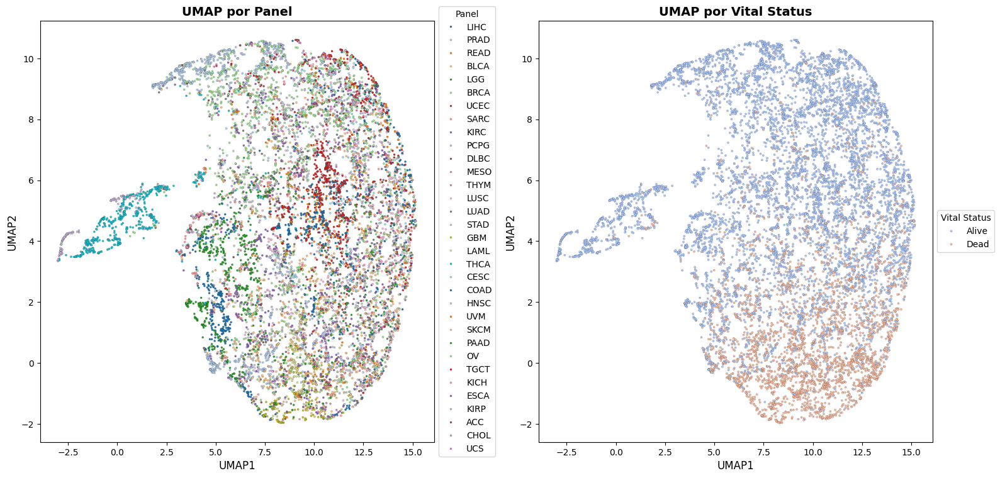

<ipython-input-17-2c387bc12976>:37: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


Modelo de la época 9 cargado exitosamente.

+-----------------------+------------------+------------+
|   Nombre de la capa   |   Tipo de capa   | Parámetros |
+-----------------------+------------------+------------+
|                       |       DANN       |  44028034  |
|   feature_extractor   | FeatureExtractor |  39982000  |
| feature_extractor.fc1 |      Linear      |  39980000  |
| feature_extractor.bn1 |   BatchNorm1d    |    2000    |
|    label_predictor    |  LabelPredictor  |  2007001   |
|  label_predictor.fc1  |      Linear      |  1001000   |
|  label_predictor.bn1  |   BatchNorm1d    |    2000    |
|  label_predictor.fc2  |      Linear      |  1001000   |
|  label_predictor.bn2  |   BatchNorm1d    |    2000    |
|  label_predictor.fc3  |      Linear      |    1001    |
|   domain_classifier   | DomainClassifier |  2039033   |
| domain_classifier.fc1 |      Linear      |  1001000   |
| domain_classifier.bn1 |   BatchNorm1d    |    2000    |
| domain_classifier.fc2 |   

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


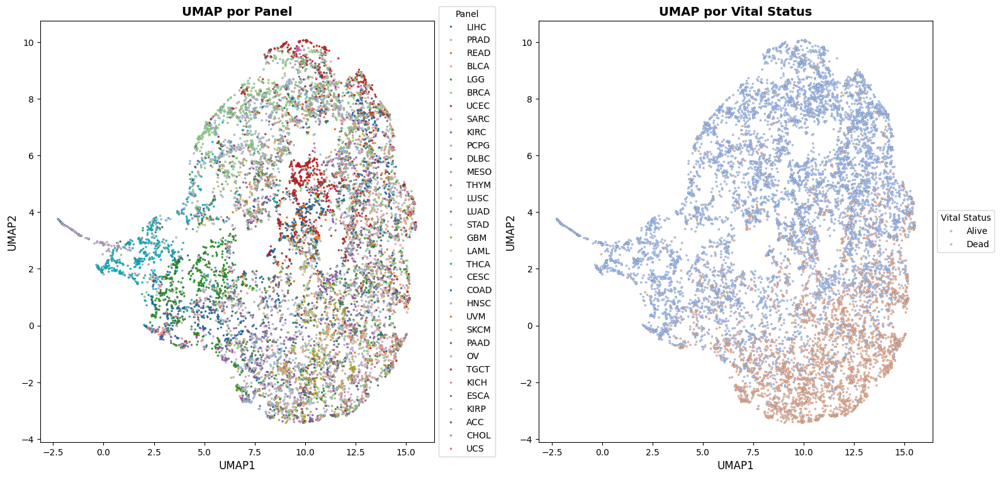

<ipython-input-17-2c387bc12976>:37: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


Modelo de la época 10 cargado exitosamente.

+-----------------------+------------------+------------+
|   Nombre de la capa   |   Tipo de capa   | Parámetros |
+-----------------------+------------------+------------+
|                       |       DANN       |  44028034  |
|   feature_extractor   | FeatureExtractor |  39982000  |
| feature_extractor.fc1 |      Linear      |  39980000  |
| feature_extractor.bn1 |   BatchNorm1d    |    2000    |
|    label_predictor    |  LabelPredictor  |  2007001   |
|  label_predictor.fc1  |      Linear      |  1001000   |
|  label_predictor.bn1  |   BatchNorm1d    |    2000    |
|  label_predictor.fc2  |      Linear      |  1001000   |
|  label_predictor.bn2  |   BatchNorm1d    |    2000    |
|  label_predictor.fc3  |      Linear      |    1001    |
|   domain_classifier   | DomainClassifier |  2039033   |
| domain_classifier.fc1 |      Linear      |  1001000   |
| domain_classifier.bn1 |   BatchNorm1d    |    2000    |
| domain_classifier.fc2 |  

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


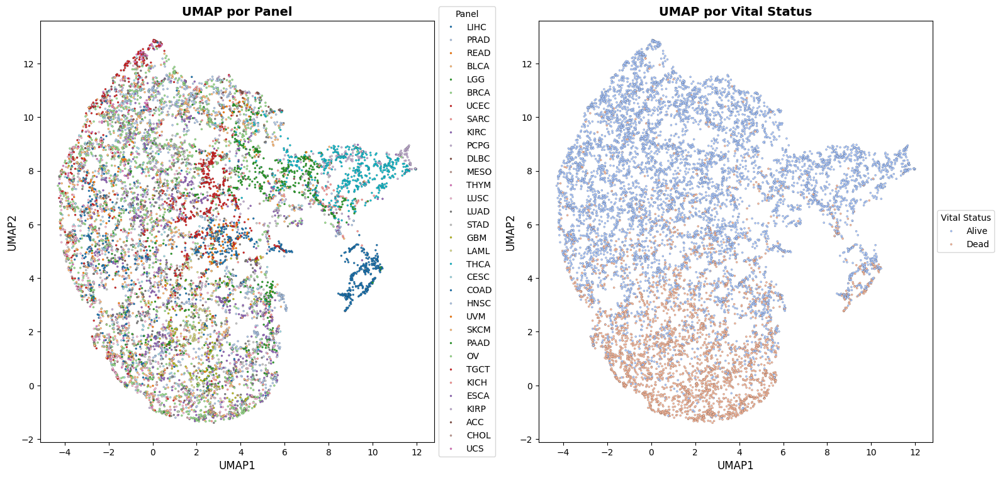

<ipython-input-17-2c387bc12976>:37: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


Modelo de la época 11 cargado exitosamente.

+-----------------------+------------------+------------+
|   Nombre de la capa   |   Tipo de capa   | Parámetros |
+-----------------------+------------------+------------+
|                       |       DANN       |  44028034  |
|   feature_extractor   | FeatureExtractor |  39982000  |
| feature_extractor.fc1 |      Linear      |  39980000  |
| feature_extractor.bn1 |   BatchNorm1d    |    2000    |
|    label_predictor    |  LabelPredictor  |  2007001   |
|  label_predictor.fc1  |      Linear      |  1001000   |
|  label_predictor.bn1  |   BatchNorm1d    |    2000    |
|  label_predictor.fc2  |      Linear      |  1001000   |
|  label_predictor.bn2  |   BatchNorm1d    |    2000    |
|  label_predictor.fc3  |      Linear      |    1001    |
|   domain_classifier   | DomainClassifier |  2039033   |
| domain_classifier.fc1 |      Linear      |  1001000   |
| domain_classifier.bn1 |   BatchNorm1d    |    2000    |
| domain_classifier.fc2 |  

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


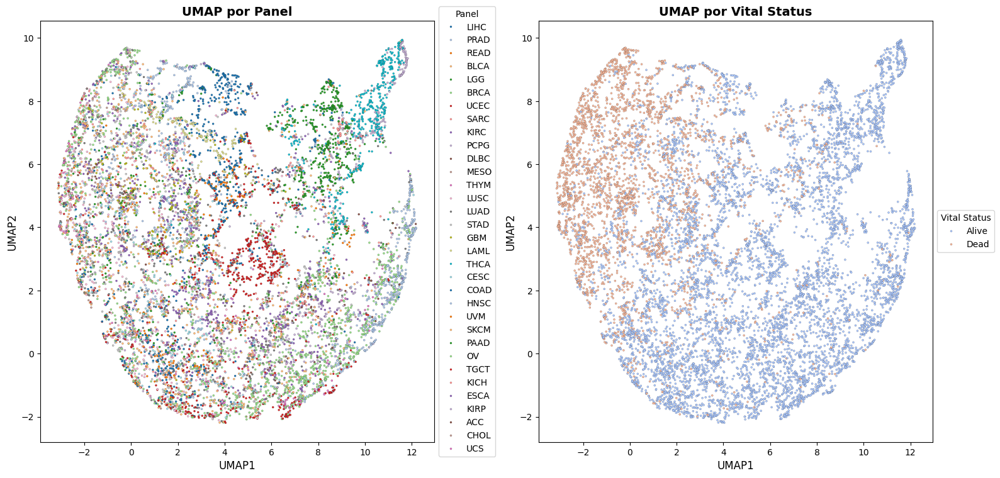

<ipython-input-17-2c387bc12976>:37: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


Modelo de la época 12 cargado exitosamente.

+-----------------------+------------------+------------+
|   Nombre de la capa   |   Tipo de capa   | Parámetros |
+-----------------------+------------------+------------+
|                       |       DANN       |  44028034  |
|   feature_extractor   | FeatureExtractor |  39982000  |
| feature_extractor.fc1 |      Linear      |  39980000  |
| feature_extractor.bn1 |   BatchNorm1d    |    2000    |
|    label_predictor    |  LabelPredictor  |  2007001   |
|  label_predictor.fc1  |      Linear      |  1001000   |
|  label_predictor.bn1  |   BatchNorm1d    |    2000    |
|  label_predictor.fc2  |      Linear      |  1001000   |
|  label_predictor.bn2  |   BatchNorm1d    |    2000    |
|  label_predictor.fc3  |      Linear      |    1001    |
|   domain_classifier   | DomainClassifier |  2039033   |
| domain_classifier.fc1 |      Linear      |  1001000   |
| domain_classifier.bn1 |   BatchNorm1d    |    2000    |
| domain_classifier.fc2 |  

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


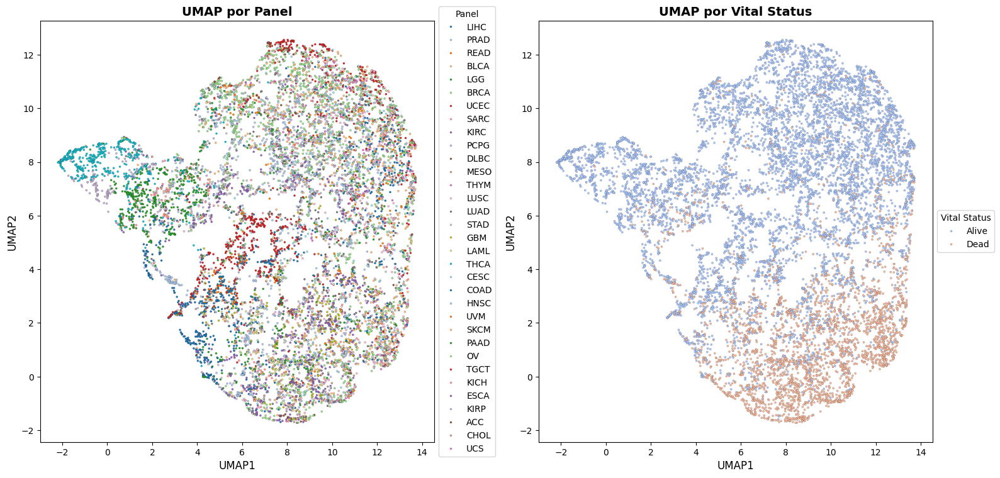

<ipython-input-17-2c387bc12976>:37: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


Modelo de la época 13 cargado exitosamente.

+-----------------------+------------------+------------+
|   Nombre de la capa   |   Tipo de capa   | Parámetros |
+-----------------------+------------------+------------+
|                       |       DANN       |  44028034  |
|   feature_extractor   | FeatureExtractor |  39982000  |
| feature_extractor.fc1 |      Linear      |  39980000  |
| feature_extractor.bn1 |   BatchNorm1d    |    2000    |
|    label_predictor    |  LabelPredictor  |  2007001   |
|  label_predictor.fc1  |      Linear      |  1001000   |
|  label_predictor.bn1  |   BatchNorm1d    |    2000    |
|  label_predictor.fc2  |      Linear      |  1001000   |
|  label_predictor.bn2  |   BatchNorm1d    |    2000    |
|  label_predictor.fc3  |      Linear      |    1001    |
|   domain_classifier   | DomainClassifier |  2039033   |
| domain_classifier.fc1 |      Linear      |  1001000   |
| domain_classifier.bn1 |   BatchNorm1d    |    2000    |
| domain_classifier.fc2 |  

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


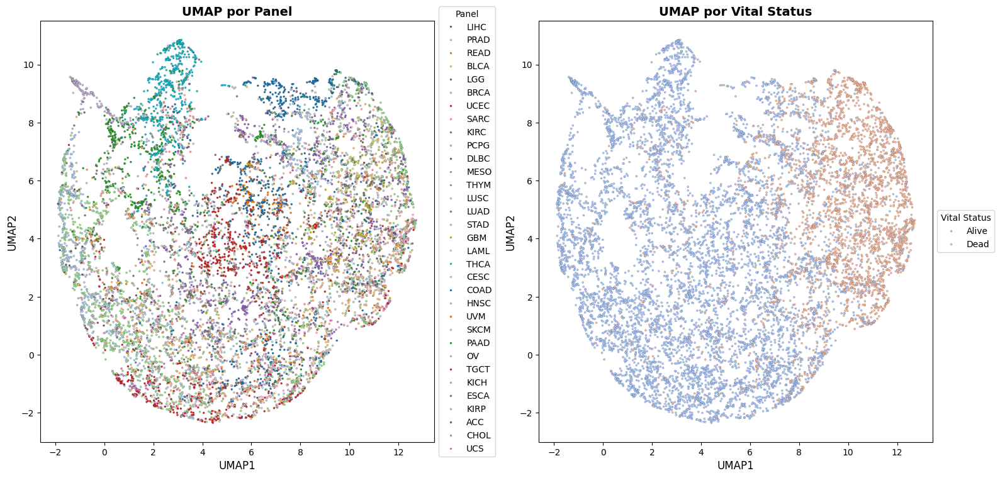

<ipython-input-17-2c387bc12976>:37: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


Modelo de la época 14 cargado exitosamente.

+-----------------------+------------------+------------+
|   Nombre de la capa   |   Tipo de capa   | Parámetros |
+-----------------------+------------------+------------+
|                       |       DANN       |  44028034  |
|   feature_extractor   | FeatureExtractor |  39982000  |
| feature_extractor.fc1 |      Linear      |  39980000  |
| feature_extractor.bn1 |   BatchNorm1d    |    2000    |
|    label_predictor    |  LabelPredictor  |  2007001   |
|  label_predictor.fc1  |      Linear      |  1001000   |
|  label_predictor.bn1  |   BatchNorm1d    |    2000    |
|  label_predictor.fc2  |      Linear      |  1001000   |
|  label_predictor.bn2  |   BatchNorm1d    |    2000    |
|  label_predictor.fc3  |      Linear      |    1001    |
|   domain_classifier   | DomainClassifier |  2039033   |
| domain_classifier.fc1 |      Linear      |  1001000   |
| domain_classifier.bn1 |   BatchNorm1d    |    2000    |
| domain_classifier.fc2 |  

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


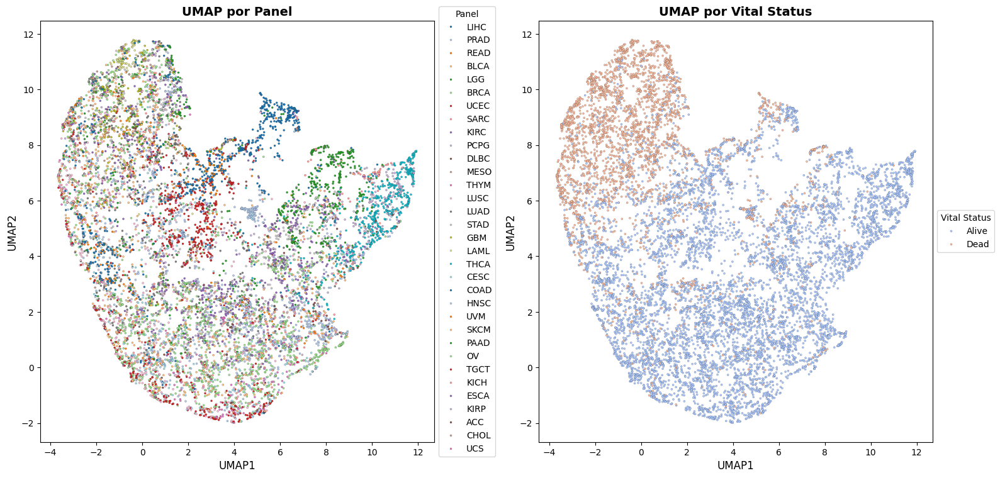

<ipython-input-17-2c387bc12976>:37: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


Modelo de la época 15 cargado exitosamente.

+-----------------------+------------------+------------+
|   Nombre de la capa   |   Tipo de capa   | Parámetros |
+-----------------------+------------------+------------+
|                       |       DANN       |  44028034  |
|   feature_extractor   | FeatureExtractor |  39982000  |
| feature_extractor.fc1 |      Linear      |  39980000  |
| feature_extractor.bn1 |   BatchNorm1d    |    2000    |
|    label_predictor    |  LabelPredictor  |  2007001   |
|  label_predictor.fc1  |      Linear      |  1001000   |
|  label_predictor.bn1  |   BatchNorm1d    |    2000    |
|  label_predictor.fc2  |      Linear      |  1001000   |
|  label_predictor.bn2  |   BatchNorm1d    |    2000    |
|  label_predictor.fc3  |      Linear      |    1001    |
|   domain_classifier   | DomainClassifier |  2039033   |
| domain_classifier.fc1 |      Linear      |  1001000   |
| domain_classifier.bn1 |   BatchNorm1d    |    2000    |
| domain_classifier.fc2 |  

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


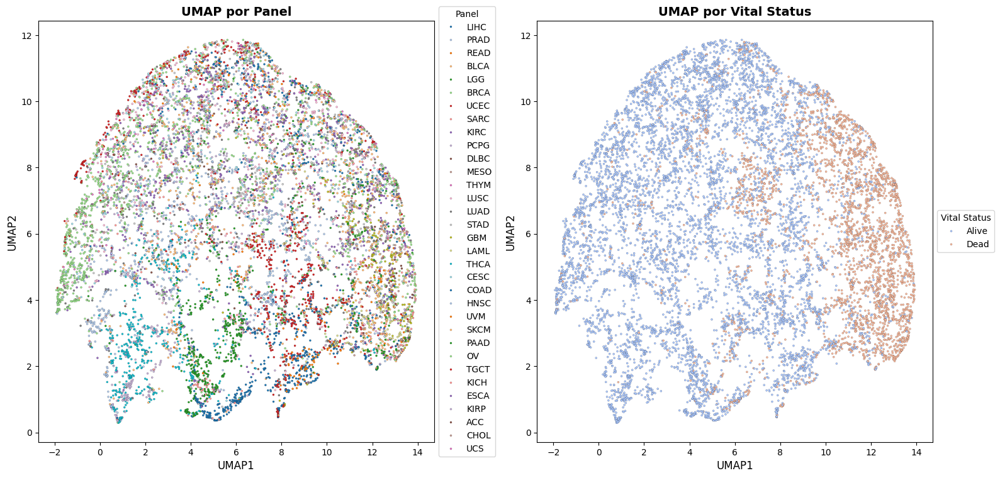

<ipython-input-17-2c387bc12976>:37: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


Modelo de la época 16 cargado exitosamente.

+-----------------------+------------------+------------+
|   Nombre de la capa   |   Tipo de capa   | Parámetros |
+-----------------------+------------------+------------+
|                       |       DANN       |  44028034  |
|   feature_extractor   | FeatureExtractor |  39982000  |
| feature_extractor.fc1 |      Linear      |  39980000  |
| feature_extractor.bn1 |   BatchNorm1d    |    2000    |
|    label_predictor    |  LabelPredictor  |  2007001   |
|  label_predictor.fc1  |      Linear      |  1001000   |
|  label_predictor.bn1  |   BatchNorm1d    |    2000    |
|  label_predictor.fc2  |      Linear      |  1001000   |
|  label_predictor.bn2  |   BatchNorm1d    |    2000    |
|  label_predictor.fc3  |      Linear      |    1001    |
|   domain_classifier   | DomainClassifier |  2039033   |
| domain_classifier.fc1 |      Linear      |  1001000   |
| domain_classifier.bn1 |   BatchNorm1d    |    2000    |
| domain_classifier.fc2 |  

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


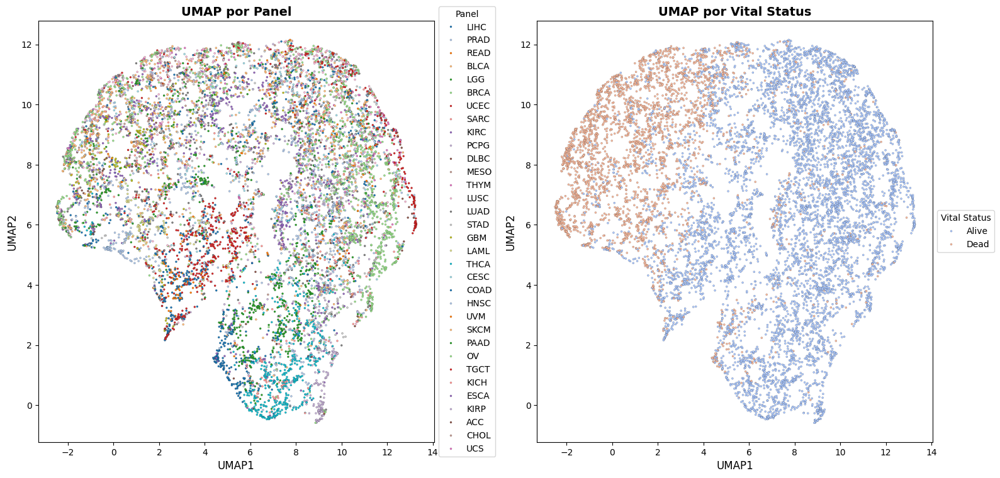

<ipython-input-17-2c387bc12976>:37: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


Modelo de la época 17 cargado exitosamente.

+-----------------------+------------------+------------+
|   Nombre de la capa   |   Tipo de capa   | Parámetros |
+-----------------------+------------------+------------+
|                       |       DANN       |  44028034  |
|   feature_extractor   | FeatureExtractor |  39982000  |
| feature_extractor.fc1 |      Linear      |  39980000  |
| feature_extractor.bn1 |   BatchNorm1d    |    2000    |
|    label_predictor    |  LabelPredictor  |  2007001   |
|  label_predictor.fc1  |      Linear      |  1001000   |
|  label_predictor.bn1  |   BatchNorm1d    |    2000    |
|  label_predictor.fc2  |      Linear      |  1001000   |
|  label_predictor.bn2  |   BatchNorm1d    |    2000    |
|  label_predictor.fc3  |      Linear      |    1001    |
|   domain_classifier   | DomainClassifier |  2039033   |
| domain_classifier.fc1 |      Linear      |  1001000   |
| domain_classifier.bn1 |   BatchNorm1d    |    2000    |
| domain_classifier.fc2 |  

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


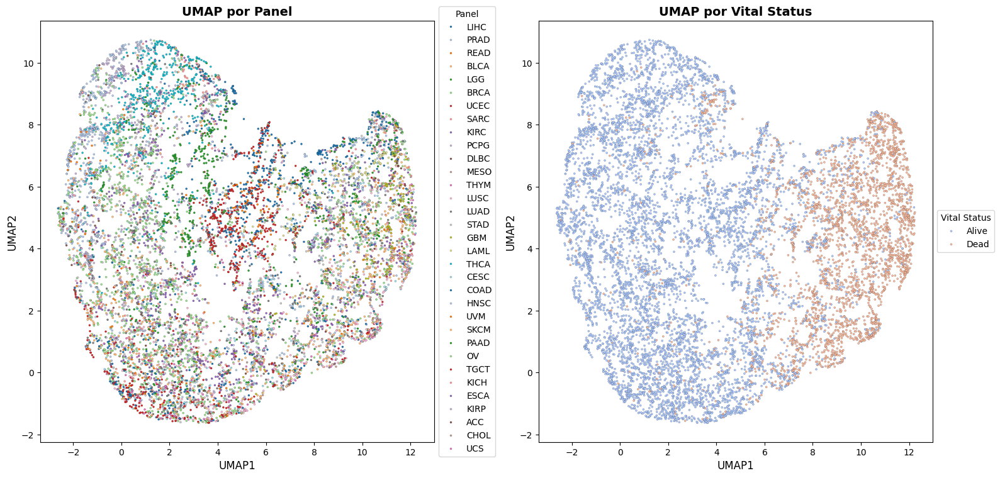

<ipython-input-17-2c387bc12976>:37: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


Modelo de la época 18 cargado exitosamente.

+-----------------------+------------------+------------+
|   Nombre de la capa   |   Tipo de capa   | Parámetros |
+-----------------------+------------------+------------+
|                       |       DANN       |  44028034  |
|   feature_extractor   | FeatureExtractor |  39982000  |
| feature_extractor.fc1 |      Linear      |  39980000  |
| feature_extractor.bn1 |   BatchNorm1d    |    2000    |
|    label_predictor    |  LabelPredictor  |  2007001   |
|  label_predictor.fc1  |      Linear      |  1001000   |
|  label_predictor.bn1  |   BatchNorm1d    |    2000    |
|  label_predictor.fc2  |      Linear      |  1001000   |
|  label_predictor.bn2  |   BatchNorm1d    |    2000    |
|  label_predictor.fc3  |      Linear      |    1001    |
|   domain_classifier   | DomainClassifier |  2039033   |
| domain_classifier.fc1 |      Linear      |  1001000   |
| domain_classifier.bn1 |   BatchNorm1d    |    2000    |
| domain_classifier.fc2 |  

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


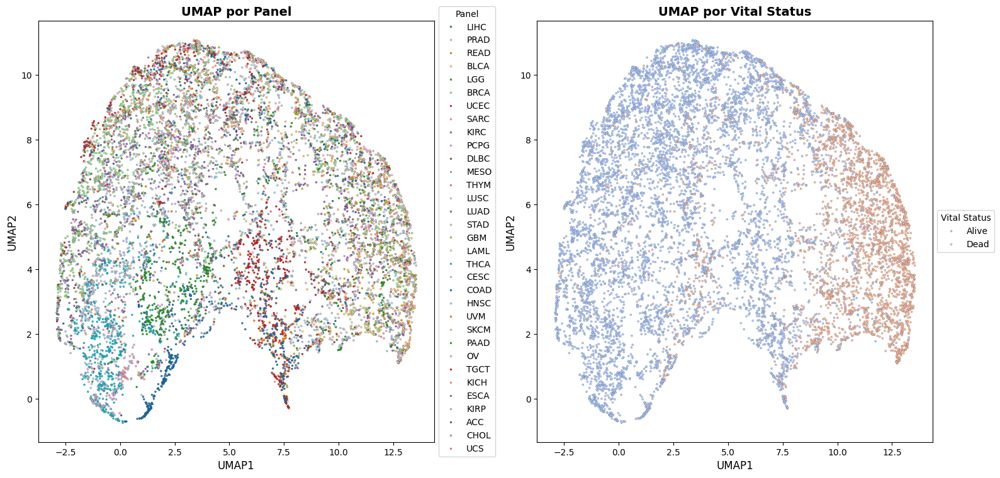

<ipython-input-17-2c387bc12976>:37: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


Modelo de la época 19 cargado exitosamente.

+-----------------------+------------------+------------+
|   Nombre de la capa   |   Tipo de capa   | Parámetros |
+-----------------------+------------------+------------+
|                       |       DANN       |  44028034  |
|   feature_extractor   | FeatureExtractor |  39982000  |
| feature_extractor.fc1 |      Linear      |  39980000  |
| feature_extractor.bn1 |   BatchNorm1d    |    2000    |
|    label_predictor    |  LabelPredictor  |  2007001   |
|  label_predictor.fc1  |      Linear      |  1001000   |
|  label_predictor.bn1  |   BatchNorm1d    |    2000    |
|  label_predictor.fc2  |      Linear      |  1001000   |
|  label_predictor.bn2  |   BatchNorm1d    |    2000    |
|  label_predictor.fc3  |      Linear      |    1001    |
|   domain_classifier   | DomainClassifier |  2039033   |
| domain_classifier.fc1 |      Linear      |  1001000   |
| domain_classifier.bn1 |   BatchNorm1d    |    2000    |
| domain_classifier.fc2 |  

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


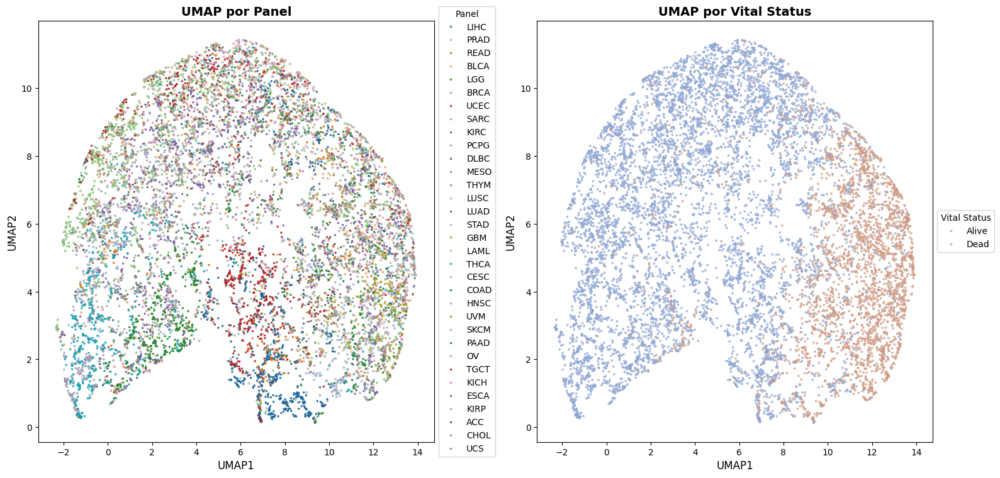

<ipython-input-17-2c387bc12976>:37: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


Modelo de la época 20 cargado exitosamente.

+-----------------------+------------------+------------+
|   Nombre de la capa   |   Tipo de capa   | Parámetros |
+-----------------------+------------------+------------+
|                       |       DANN       |  44028034  |
|   feature_extractor   | FeatureExtractor |  39982000  |
| feature_extractor.fc1 |      Linear      |  39980000  |
| feature_extractor.bn1 |   BatchNorm1d    |    2000    |
|    label_predictor    |  LabelPredictor  |  2007001   |
|  label_predictor.fc1  |      Linear      |  1001000   |
|  label_predictor.bn1  |   BatchNorm1d    |    2000    |
|  label_predictor.fc2  |      Linear      |  1001000   |
|  label_predictor.bn2  |   BatchNorm1d    |    2000    |
|  label_predictor.fc3  |      Linear      |    1001    |
|   domain_classifier   | DomainClassifier |  2039033   |
| domain_classifier.fc1 |      Linear      |  1001000   |
| domain_classifier.bn1 |   BatchNorm1d    |    2000    |
| domain_classifier.fc2 |  

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


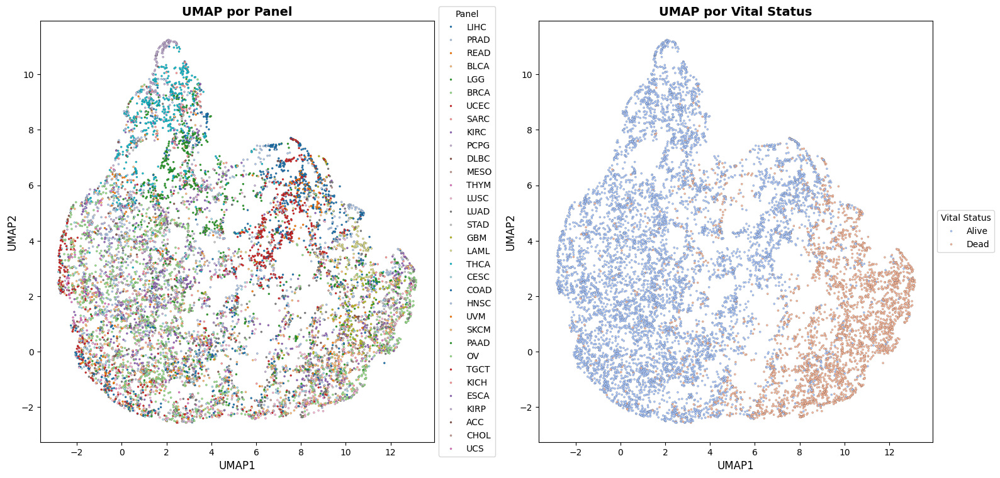

<ipython-input-17-2c387bc12976>:37: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


Modelo de la época 21 cargado exitosamente.

+-----------------------+------------------+------------+
|   Nombre de la capa   |   Tipo de capa   | Parámetros |
+-----------------------+------------------+------------+
|                       |       DANN       |  44028034  |
|   feature_extractor   | FeatureExtractor |  39982000  |
| feature_extractor.fc1 |      Linear      |  39980000  |
| feature_extractor.bn1 |   BatchNorm1d    |    2000    |
|    label_predictor    |  LabelPredictor  |  2007001   |
|  label_predictor.fc1  |      Linear      |  1001000   |
|  label_predictor.bn1  |   BatchNorm1d    |    2000    |
|  label_predictor.fc2  |      Linear      |  1001000   |
|  label_predictor.bn2  |   BatchNorm1d    |    2000    |
|  label_predictor.fc3  |      Linear      |    1001    |
|   domain_classifier   | DomainClassifier |  2039033   |
| domain_classifier.fc1 |      Linear      |  1001000   |
| domain_classifier.bn1 |   BatchNorm1d    |    2000    |
| domain_classifier.fc2 |  

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


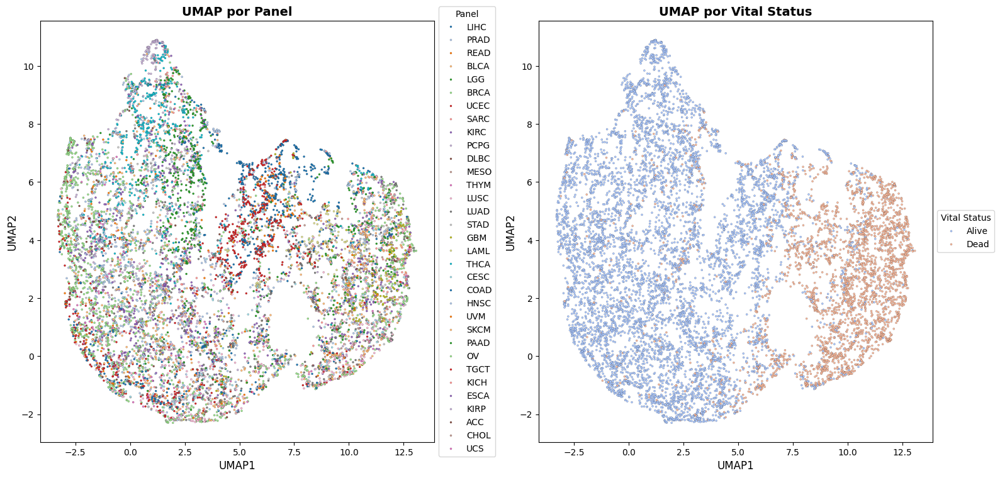

<ipython-input-17-2c387bc12976>:37: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


Modelo de la época 22 cargado exitosamente.

+-----------------------+------------------+------------+
|   Nombre de la capa   |   Tipo de capa   | Parámetros |
+-----------------------+------------------+------------+
|                       |       DANN       |  44028034  |
|   feature_extractor   | FeatureExtractor |  39982000  |
| feature_extractor.fc1 |      Linear      |  39980000  |
| feature_extractor.bn1 |   BatchNorm1d    |    2000    |
|    label_predictor    |  LabelPredictor  |  2007001   |
|  label_predictor.fc1  |      Linear      |  1001000   |
|  label_predictor.bn1  |   BatchNorm1d    |    2000    |
|  label_predictor.fc2  |      Linear      |  1001000   |
|  label_predictor.bn2  |   BatchNorm1d    |    2000    |
|  label_predictor.fc3  |      Linear      |    1001    |
|   domain_classifier   | DomainClassifier |  2039033   |
| domain_classifier.fc1 |      Linear      |  1001000   |
| domain_classifier.bn1 |   BatchNorm1d    |    2000    |
| domain_classifier.fc2 |  

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


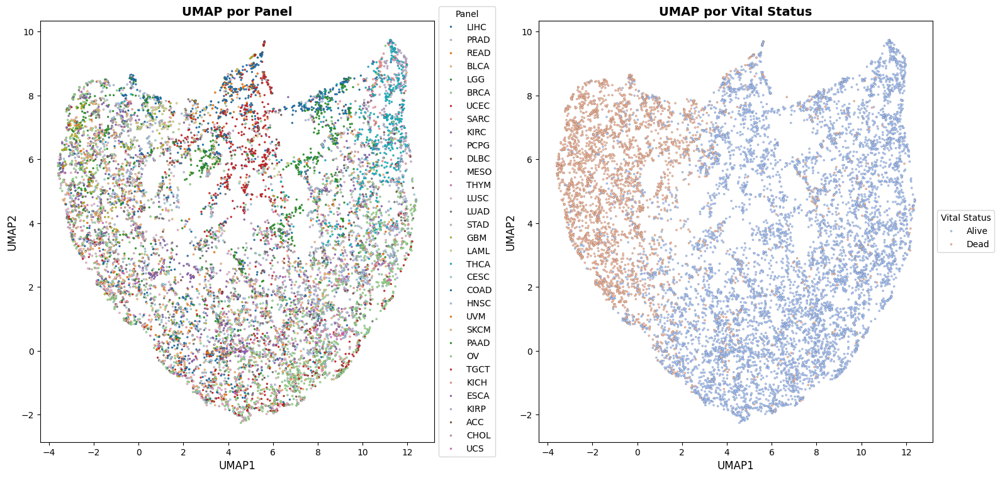

<ipython-input-17-2c387bc12976>:37: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


Modelo de la época 23 cargado exitosamente.

+-----------------------+------------------+------------+
|   Nombre de la capa   |   Tipo de capa   | Parámetros |
+-----------------------+------------------+------------+
|                       |       DANN       |  44028034  |
|   feature_extractor   | FeatureExtractor |  39982000  |
| feature_extractor.fc1 |      Linear      |  39980000  |
| feature_extractor.bn1 |   BatchNorm1d    |    2000    |
|    label_predictor    |  LabelPredictor  |  2007001   |
|  label_predictor.fc1  |      Linear      |  1001000   |
|  label_predictor.bn1  |   BatchNorm1d    |    2000    |
|  label_predictor.fc2  |      Linear      |  1001000   |
|  label_predictor.bn2  |   BatchNorm1d    |    2000    |
|  label_predictor.fc3  |      Linear      |    1001    |
|   domain_classifier   | DomainClassifier |  2039033   |
| domain_classifier.fc1 |      Linear      |  1001000   |
| domain_classifier.bn1 |   BatchNorm1d    |    2000    |
| domain_classifier.fc2 |  

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


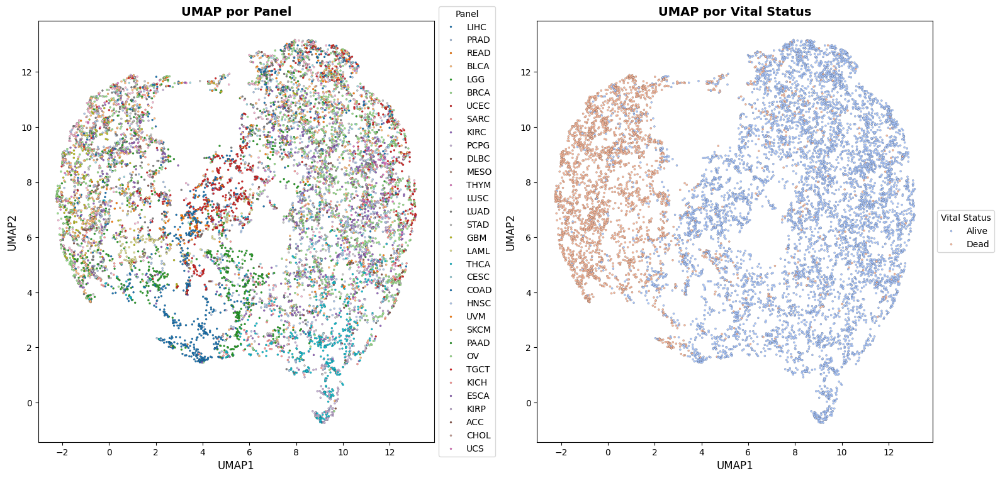

<ipython-input-17-2c387bc12976>:37: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


Modelo de la época 24 cargado exitosamente.

+-----------------------+------------------+------------+
|   Nombre de la capa   |   Tipo de capa   | Parámetros |
+-----------------------+------------------+------------+
|                       |       DANN       |  44028034  |
|   feature_extractor   | FeatureExtractor |  39982000  |
| feature_extractor.fc1 |      Linear      |  39980000  |
| feature_extractor.bn1 |   BatchNorm1d    |    2000    |
|    label_predictor    |  LabelPredictor  |  2007001   |
|  label_predictor.fc1  |      Linear      |  1001000   |
|  label_predictor.bn1  |   BatchNorm1d    |    2000    |
|  label_predictor.fc2  |      Linear      |  1001000   |
|  label_predictor.bn2  |   BatchNorm1d    |    2000    |
|  label_predictor.fc3  |      Linear      |    1001    |
|   domain_classifier   | DomainClassifier |  2039033   |
| domain_classifier.fc1 |      Linear      |  1001000   |
| domain_classifier.bn1 |   BatchNorm1d    |    2000    |
| domain_classifier.fc2 |  

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


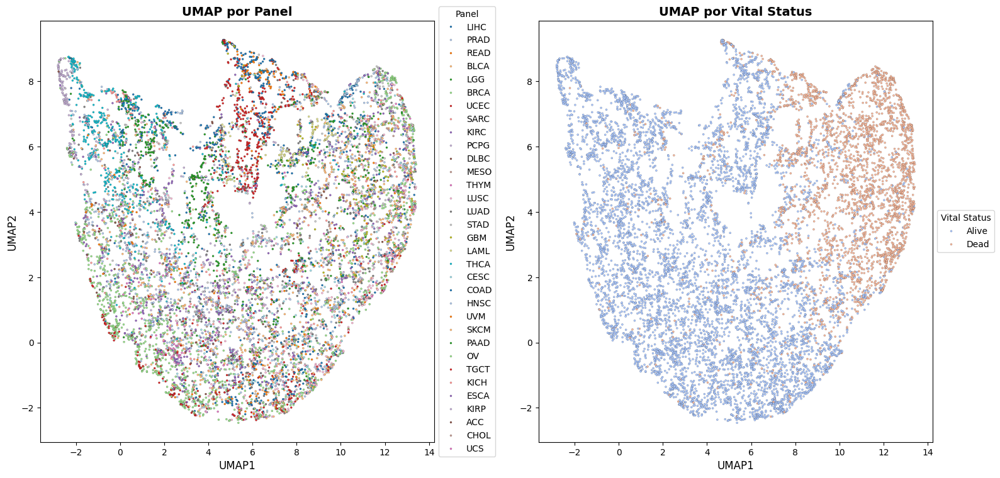

<ipython-input-17-2c387bc12976>:37: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


Modelo de la época 25 cargado exitosamente.

+-----------------------+------------------+------------+
|   Nombre de la capa   |   Tipo de capa   | Parámetros |
+-----------------------+------------------+------------+
|                       |       DANN       |  44028034  |
|   feature_extractor   | FeatureExtractor |  39982000  |
| feature_extractor.fc1 |      Linear      |  39980000  |
| feature_extractor.bn1 |   BatchNorm1d    |    2000    |
|    label_predictor    |  LabelPredictor  |  2007001   |
|  label_predictor.fc1  |      Linear      |  1001000   |
|  label_predictor.bn1  |   BatchNorm1d    |    2000    |
|  label_predictor.fc2  |      Linear      |  1001000   |
|  label_predictor.bn2  |   BatchNorm1d    |    2000    |
|  label_predictor.fc3  |      Linear      |    1001    |
|   domain_classifier   | DomainClassifier |  2039033   |
| domain_classifier.fc1 |      Linear      |  1001000   |
| domain_classifier.bn1 |   BatchNorm1d    |    2000    |
| domain_classifier.fc2 |  

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


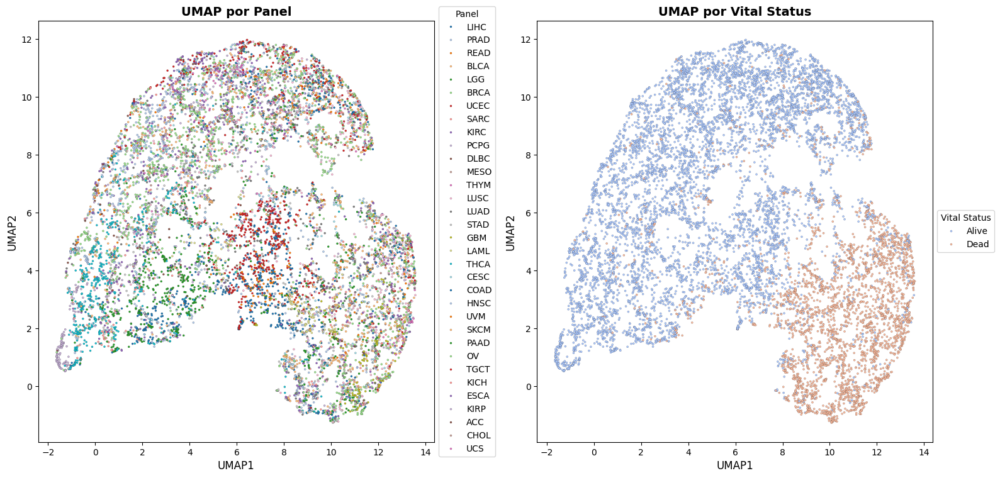

<ipython-input-17-2c387bc12976>:37: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


Modelo de la época 26 cargado exitosamente.

+-----------------------+------------------+------------+
|   Nombre de la capa   |   Tipo de capa   | Parámetros |
+-----------------------+------------------+------------+
|                       |       DANN       |  44028034  |
|   feature_extractor   | FeatureExtractor |  39982000  |
| feature_extractor.fc1 |      Linear      |  39980000  |
| feature_extractor.bn1 |   BatchNorm1d    |    2000    |
|    label_predictor    |  LabelPredictor  |  2007001   |
|  label_predictor.fc1  |      Linear      |  1001000   |
|  label_predictor.bn1  |   BatchNorm1d    |    2000    |
|  label_predictor.fc2  |      Linear      |  1001000   |
|  label_predictor.bn2  |   BatchNorm1d    |    2000    |
|  label_predictor.fc3  |      Linear      |    1001    |
|   domain_classifier   | DomainClassifier |  2039033   |
| domain_classifier.fc1 |      Linear      |  1001000   |
| domain_classifier.bn1 |   BatchNorm1d    |    2000    |
| domain_classifier.fc2 |  

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


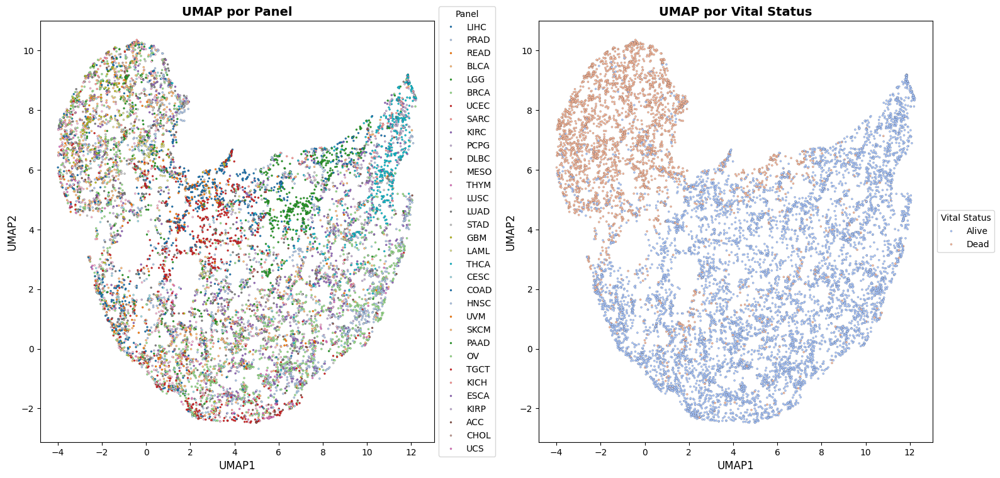

<ipython-input-17-2c387bc12976>:37: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


Modelo de la época 27 cargado exitosamente.

+-----------------------+------------------+------------+
|   Nombre de la capa   |   Tipo de capa   | Parámetros |
+-----------------------+------------------+------------+
|                       |       DANN       |  44028034  |
|   feature_extractor   | FeatureExtractor |  39982000  |
| feature_extractor.fc1 |      Linear      |  39980000  |
| feature_extractor.bn1 |   BatchNorm1d    |    2000    |
|    label_predictor    |  LabelPredictor  |  2007001   |
|  label_predictor.fc1  |      Linear      |  1001000   |
|  label_predictor.bn1  |   BatchNorm1d    |    2000    |
|  label_predictor.fc2  |      Linear      |  1001000   |
|  label_predictor.bn2  |   BatchNorm1d    |    2000    |
|  label_predictor.fc3  |      Linear      |    1001    |
|   domain_classifier   | DomainClassifier |  2039033   |
| domain_classifier.fc1 |      Linear      |  1001000   |
| domain_classifier.bn1 |   BatchNorm1d    |    2000    |
| domain_classifier.fc2 |  

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


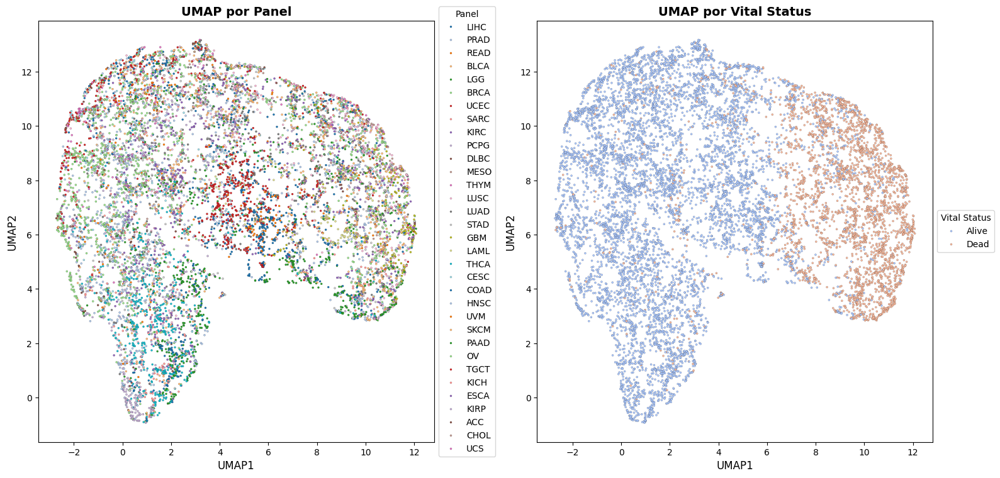

<ipython-input-17-2c387bc12976>:37: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


Modelo de la época 28 cargado exitosamente.

+-----------------------+------------------+------------+
|   Nombre de la capa   |   Tipo de capa   | Parámetros |
+-----------------------+------------------+------------+
|                       |       DANN       |  44028034  |
|   feature_extractor   | FeatureExtractor |  39982000  |
| feature_extractor.fc1 |      Linear      |  39980000  |
| feature_extractor.bn1 |   BatchNorm1d    |    2000    |
|    label_predictor    |  LabelPredictor  |  2007001   |
|  label_predictor.fc1  |      Linear      |  1001000   |
|  label_predictor.bn1  |   BatchNorm1d    |    2000    |
|  label_predictor.fc2  |      Linear      |  1001000   |
|  label_predictor.bn2  |   BatchNorm1d    |    2000    |
|  label_predictor.fc3  |      Linear      |    1001    |
|   domain_classifier   | DomainClassifier |  2039033   |
| domain_classifier.fc1 |      Linear      |  1001000   |
| domain_classifier.bn1 |   BatchNorm1d    |    2000    |
| domain_classifier.fc2 |  

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


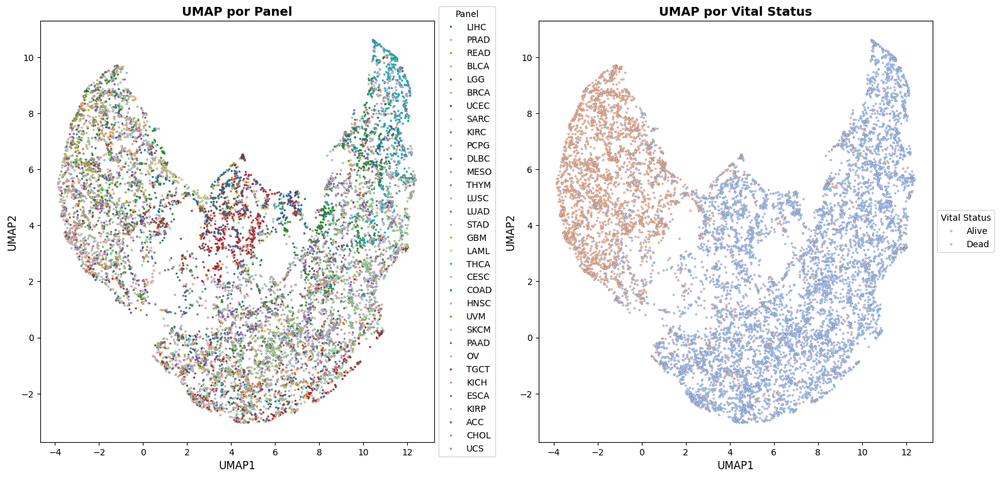

<ipython-input-17-2c387bc12976>:37: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


Modelo de la época 29 cargado exitosamente.

+-----------------------+------------------+------------+
|   Nombre de la capa   |   Tipo de capa   | Parámetros |
+-----------------------+------------------+------------+
|                       |       DANN       |  44028034  |
|   feature_extractor   | FeatureExtractor |  39982000  |
| feature_extractor.fc1 |      Linear      |  39980000  |
| feature_extractor.bn1 |   BatchNorm1d    |    2000    |
|    label_predictor    |  LabelPredictor  |  2007001   |
|  label_predictor.fc1  |      Linear      |  1001000   |
|  label_predictor.bn1  |   BatchNorm1d    |    2000    |
|  label_predictor.fc2  |      Linear      |  1001000   |
|  label_predictor.bn2  |   BatchNorm1d    |    2000    |
|  label_predictor.fc3  |      Linear      |    1001    |
|   domain_classifier   | DomainClassifier |  2039033   |
| domain_classifier.fc1 |      Linear      |  1001000   |
| domain_classifier.bn1 |   BatchNorm1d    |    2000    |
| domain_classifier.fc2 |  

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


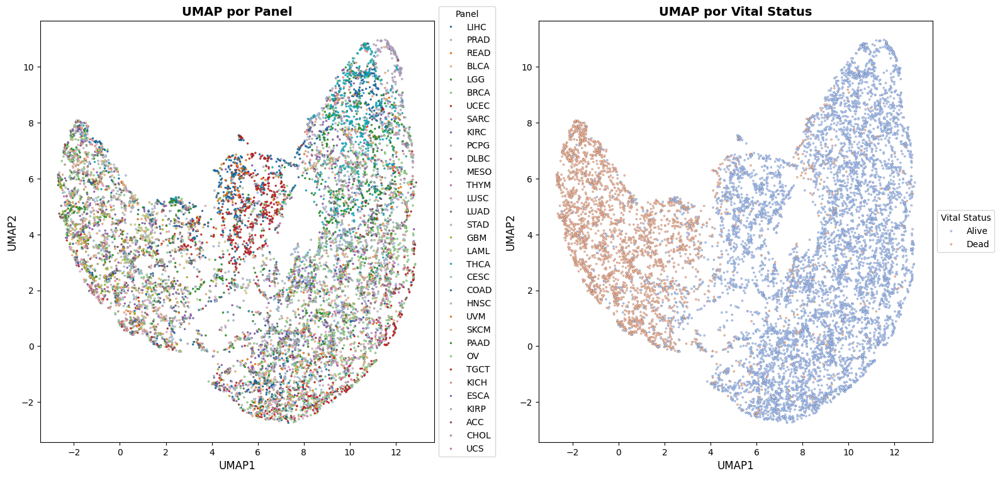

<ipython-input-17-2c387bc12976>:37: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


Modelo de la época 30 cargado exitosamente.

+-----------------------+------------------+------------+
|   Nombre de la capa   |   Tipo de capa   | Parámetros |
+-----------------------+------------------+------------+
|                       |       DANN       |  44028034  |
|   feature_extractor   | FeatureExtractor |  39982000  |
| feature_extractor.fc1 |      Linear      |  39980000  |
| feature_extractor.bn1 |   BatchNorm1d    |    2000    |
|    label_predictor    |  LabelPredictor  |  2007001   |
|  label_predictor.fc1  |      Linear      |  1001000   |
|  label_predictor.bn1  |   BatchNorm1d    |    2000    |
|  label_predictor.fc2  |      Linear      |  1001000   |
|  label_predictor.bn2  |   BatchNorm1d    |    2000    |
|  label_predictor.fc3  |      Linear      |    1001    |
|   domain_classifier   | DomainClassifier |  2039033   |
| domain_classifier.fc1 |      Linear      |  1001000   |
| domain_classifier.bn1 |   BatchNorm1d    |    2000    |
| domain_classifier.fc2 |  

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


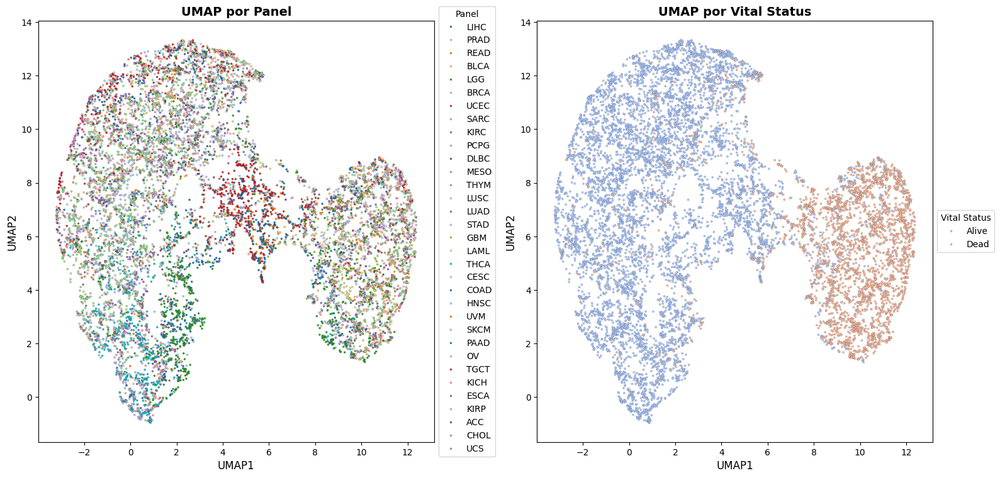

In [20]:
# Lista para guardar los DataFrames
dataframes_list = []

# Ciclo iterativo de 1 a 30
for i in range(1, 31):
    df_coords = process_model_and_umap(df, epoch_to_load=i, layer_of_interest='label_predictor.fc2', device='cuda')
    df_coords['epochs'] = i
    dataframes_list.append(df_coords)

# Al final, la lista `dataframes_list` contendrá los DataFrames generados en cada iteración


In [22]:
final_df = pd.concat(dataframes_list, ignore_index=True)
final_df

,UMAP1,UMAP2,index,vital,panel_y,epochs
0,7.873282,13.936563,9fe7d0f4-866d-490f-b2cb-d9be7da889de,Alive,LIHC,1
1,3.165354,7.953806,dd74434f-300f-4798-8342-aad31b192e12,Alive,PRAD,1
2,0.390797,-2.619241,07db9e9d-059d-4e6c-b483-81517a492b96,Dead,READ,1
3,12.172947,3.984075,47ee860a-fd18-48f2-bfe7-4e19391950bd,Alive,LIHC,1
4,1.519655,-2.732467,e322b0e5-458a-4cbf-a64f-9b348e413939,Dead,BLCA,1
...,...,...,...,...,...,...
308575,9.027594,7.064115,62cb41b1-8960-4fa2-8f74-38dd174af004,Dead,KIRC,30
308576,5.105608,12.059362,673a85f3-ba5e-448a-acee-dfec77b5238e,Alive,UCS,30
308577,2.547596,3.885732,3d93b2ae-7730-4914-af23-ff3554752922,Alive,LGG,30
308578,5.790080,8.589130,85a0b88f-2b89-4117-9e04-b81fad7f2e1b,Alive,LAML,30


In [24]:
df

,5S_rRNA,5_8S_rRNA,7SK,A1BG,A1BG-AS1,A1CF,A2M,A2M-AS1,A2ML1,A2ML1-AS1,...,ZYG11B,ZYX,ZYXP1,ZZEF1,ZZZ3,hsa-mir-1253,hsa-mir-423,snoZ196,vital,panel
9fe7d0f4-866d-490f-b2cb-d9be7da889de,0,0,79,1055,12,3291,6614,11,0,0,...,557,3130,0,314,469,0,0,3,Alive,LIHC
dd74434f-300f-4798-8342-aad31b192e12,1,0,1250,8,51,3,24510,55,120,0,...,963,10619,0,1656,1146,0,0,3,Alive,PRAD
07db9e9d-059d-4e6c-b483-81517a492b96,0,0,41,2,35,1618,21227,29,1,0,...,2136,13793,0,3667,2641,0,0,3,Dead,READ
47ee860a-fd18-48f2-bfe7-4e19391950bd,0,0,111,16482,328,10632,159168,124,1,0,...,3417,887,0,1822,1891,0,0,1,Alive,LIHC
e322b0e5-458a-4cbf-a64f-9b348e413939,2,0,22,2,0,2,7488,18,1714,0,...,2155,13427,0,1404,2215,0,0,4,Dead,BLCA
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
62cb41b1-8960-4fa2-8f74-38dd174af004,3,0,52,14,76,2971,111008,92,6,0,...,3969,11102,0,4381,2584,0,0,1,Dead,KIRC
673a85f3-ba5e-448a-acee-dfec77b5238e,3,0,169,40,142,4,25243,27,277,0,...,2717,14657,0,1090,2165,0,0,3,Alive,UCS
3d93b2ae-7730-4914-af23-ff3554752922,0,1,3961,10,54,3,32550,26,289,1,...,2568,4216,0,3239,908,0,0,1,Alive,LGG
85a0b88f-2b89-4117-9e04-b81fad7f2e1b,9,1,1003,90,272,0,331,96,55,0,...,1611,19604,0,7247,3970,0,0,13,Alive,LAML


In [23]:
final_df[final_df['epochs'] == 30].set_index('index')

,UMAP1,UMAP2,index,vital,panel_y,epochs
298294,3.315575,5.548252,9fe7d0f4-866d-490f-b2cb-d9be7da889de,Alive,LIHC,30
298295,-1.307040,9.362494,dd74434f-300f-4798-8342-aad31b192e12,Alive,PRAD,30
298296,10.324514,8.523129,07db9e9d-059d-4e6c-b483-81517a492b96,Dead,READ,30
298297,0.890576,-0.831648,47ee860a-fd18-48f2-bfe7-4e19391950bd,Alive,LIHC,30
298298,11.661679,8.389454,e322b0e5-458a-4cbf-a64f-9b348e413939,Dead,BLCA,30
...,...,...,...,...,...,...
308575,9.027594,7.064115,62cb41b1-8960-4fa2-8f74-38dd174af004,Dead,KIRC,30
308576,5.105608,12.059362,673a85f3-ba5e-448a-acee-dfec77b5238e,Alive,UCS,30
308577,2.547596,3.885732,3d93b2ae-7730-4914-af23-ff3554752922,Alive,LGG,30
308578,5.790080,8.589130,85a0b88f-2b89-4117-9e04-b81fad7f2e1b,Alive,LAML,30


In [ ]:
df_coords = process_model_and_umap(df, epoch_to_load=10, layer_of_interest='label_predictor.fc1', device='cuda')


In [ ]:
df_coords = process_model_and_umap(df, epoch_to_load=5, layer_of_interest='label_predictor.fc2', device='cuda')

In [ ]:
from sklearn.preprocessing import LabelEncoder
import os
import torch
import umap
import pandas as pd
from prettytable import PrettyTable
from torch.utils.data import DataLoader, TensorDataset
import matplotlib.pyplot as plt
import seaborn as sns

def main(epoch_to_load, layer_of_interest, df, visualize=False):
    # Definir el dispositivo
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    # Preparar los datos de df
    X = df.iloc[:, :-2].values  # Datos de las características (miRNAs u otras variables)
    Y = df['vital'].values      # Estado vital
    panels = df['panel'].values  # Etiquetas del dominio (paneles)
    indices = df.index.values    # Mantener los índices originales como cadenas

    # Asegúrate de que la columna 'vital' sea numérica reemplazando 'Alive' y 'Dead' por números
    df['vital'] = df['vital'].replace({'Alive': 1, 'Dead': 0})  # Reemplazar por 1 y 0

    # Convertir la columna 'panel' a valores numéricos usando LabelEncoder
    label_encoder_panel = LabelEncoder()
    panels = label_encoder_panel.fit_transform(panels)

    # Cargar el modelo de la época especificada
    model_path = os.path.join('model_checkpoints', f'model_epoch_{epoch_to_load}.pth')

    # Crear una nueva instancia del modelo (estructura)
    input_dim = X.shape[1]  # Usar las dimensiones de X
    num_domains = len(label_encoder_panel.classes_)  # Usar el codificador de etiquetas
    model = DANN(input_dim, num_domains).to(device)

    # Cargar los parámetros guardados en el modelo (ya entrenado)
    model.load_state_dict(torch.load(model_path))
    model.eval()  # Cambiar a modo evaluación para inferencias

    print(f"Modelo de la época {epoch_to_load} cargado exitosamente.\n")

    # Crear la tabla con encabezados
    table = PrettyTable(["Nombre de la capa", "Tipo de capa", "Parámetros"])

    # Iterar sobre las capas del modelo
    for name, layer in model.named_modules():
        num_params = sum(p.numel() for p in layer.parameters())
        if num_params > 0:  # Mostrar solo las capas que tienen parámetros
            table.add_row([name, layer.__class__.__name__, num_params])

    # Imprimir la tabla de capas
    print(table)

    # Convertir los datos en tensores para PyTorch (excepto los índices que se mantienen como están)
    X_tensor = torch.tensor(X, dtype=torch.float32).to(device)
    Y_tensor = torch.tensor(Y, dtype=torch.float32).unsqueeze(1).to(device)  # Asegúrate de que sea float
    panels_tensor = torch.tensor(panels, dtype=torch.long).to(device)

    # Crear el DataLoader directamente a partir del DataFrame df (sin los índices)
    batch_size = 128
    dataset = TensorDataset(X_tensor, Y_tensor, panels_tensor)
    loader = DataLoader(dataset, batch_size=batch_size, shuffle=False)

    # Función para extraer características de una capa específica
    def extract_features(model, loader, layer_name, indices, device):
        model.eval()
        features_list = []
        labels_list = []
        panels_list = []
        indices_list = []

        with torch.no_grad():
            for i, (inputs, labels, domains) in enumerate(loader):
                inputs = inputs.to(device)

                # Extraer características de la capa de interés
                if layer_name == 'feature_extractor':
                    features = model.feature_extractor(inputs)
                elif layer_name == 'feature_extractor.fc1':
                    features = model.feature_extractor.fc1(inputs)
                elif layer_name == 'label_predictor':
                    features = model.label_predictor(model.feature_extractor(inputs))
                elif layer_name == 'label_predictor.fc1':
                    features = model.label_predictor.fc1(model.feature_extractor(inputs))
                elif layer_name == 'label_predictor.fc2':
                    features = model.label_predictor.fc2(model.feature_extractor(inputs))
                elif layer_name == 'label_predictor.fc3':
                    features = model.label_predictor.fc3(model.feature_extractor(inputs))
                elif layer_name == 'domain_classifier':
                    features = model.domain_classifier(model.feature_extractor(inputs))
                elif layer_name == 'domain_classifier.fc1':
                    features = model.domain_classifier.fc1(model.feature_extractor(inputs))
                elif layer_name == 'domain_classifier.fc2':
                    features = model.domain_classifier.fc2(model.feature_extractor(inputs))
                elif layer_name == 'domain_classifier.fc3':
                    features = model.domain_classifier.fc3(model.feature_extractor(inputs))
                else:
                    raise ValueError(f"Capa no reconocida: {layer_name}")

                features_list.append(features.cpu().numpy())  # Guardar las características
                labels_list.append(labels.cpu().numpy())      # Guardar el vital status (etiquetas)
                panels_list.append(domains.cpu().numpy())     # Guardar el panel
                indices_list.append(indices[i*batch_size:(i+1)*batch_size])  # Guardar los índices originales

        # Concatenar todas las características y etiquetas
        all_features = np.concatenate(features_list, axis=0)
        all_labels = np.concatenate(labels_list, axis=0)
        all_panels = np.concatenate(panels_list, axis=0)
        all_indices = np.concatenate(indices_list, axis=0)

        return all_features, all_labels, all_panels, all_indices

    # Extraer características de la última iteración (manteniendo los índices)
    all_features, all_labels, all_panels, all_indices = extract_features(model, loader, layer_of_interest, indices, device)

    # Función para aplicar UMAP a las características extraídas
    def apply_umap(features):
        reducer = umap.UMAP(n_neighbors=15, min_dist=0.1, n_components=2, random_state=42)
        umap_coords = reducer.fit_transform(features)
        return umap_coords

    # Aplicar UMAP
    umap_coords = apply_umap(all_features)

    # Crear un DataFrame final con las coordenadas UMAP, vital status, index y panel
    df_umap = pd.DataFrame(umap_coords, columns=['UMAP1', 'UMAP2'])
    df_umap['vital_status'] = all_labels
    df_umap['panel'] = all_panels
    df_umap['index'] = all_indices

    # Añadir los datos originales del DataFrame df si es necesario (por ejemplo, nombres de las muestras, etc.)
    df_final = df_umap.merge(df, left_on='index', right_index=True)

    # Visualizar si se ha especificado
    if visualize:
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))

        # Scatter plot para "panel_y" con mejoras estéticas
        sns.scatterplot(ax=axes[0], x='UMAP1', y='UMAP2', hue='panel_y', data=df_final,
                        palette='tab20', legend='full', s=60, edgecolor='black', linewidth=0.3)
        axes[0].set_title('UMAP por Panel', fontsize=14, weight='bold')
        axes[0].set_xlabel('UMAP1', fontsize=12)
        axes[0].set_ylabel('UMAP2', fontsize=12)
        axes[0].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='Panel')

        # Scatter plot para "vital" con mejoras estéticas
        sns.scatterplot(ax=axes[1], x='UMAP1', y='UMAP2', hue='vital', data=df_final,
                        palette='coolwarm', legend='full', s=60, edgecolor='black', linewidth=0.3)
        axes[1].set_title('UMAP por Vital Status', fontsize=14, weight='bold')
        axes[1].set_xlabel('UMAP1', fontsize=12)
        axes[1].set_ylabel('UMAP2', fontsize=12)
        axes[1].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='Vital Status')

        plt.tight_layout()
        plt.show()

    # Devolver el DataFrame final
    return df_final

# Ejemplo de uso:
# df es el DataFrame que contiene tus datos.
# df_result = main(40, 'label_predictor.fc2', df, visualize=True)


In [ ]:
# Ejemplo de uso:

df_result = main(40, 'label_predictor.fc2', df, visualize=True)


In [ ]:
from sklearn.preprocessing import LabelEncoder
import os
import torch
import umap
import pandas as pd
from prettytable import PrettyTable
from torch.utils.data import DataLoader, TensorDataset

# Cargar el modelo de la época 50
epoch_to_load = 50
model_path = os.path.join('model_checkpoints', f'model_epoch_{epoch_to_load}.pth')

# Crear una nueva instancia del modelo (estructura)
input_dim = X.shape[1]  # Asegúrate de que 'X' esté definido correctamente con tu conjunto de datos
num_domains = len(label_encoder_panel.classes_)  # Asegúrate de que 'label_encoder_panel' esté definido correctamente
model = DANN(input_dim, num_domains).to(device)

# Cargar los parámetros guardados en el modelo (ya entrenado)
model.load_state_dict(torch.load(model_path))
model.eval()  # Cambiar a modo evaluación para inferencias

print(f"Modelo de la época {epoch_to_load} cargado exitosamente.\n")

# Crear la tabla con encabezados
table = PrettyTable(["Nombre de la capa", "Tipo de capa", "Parámetros"])

# Iterar sobre las capas del modelo
for name, layer in model.named_modules():
    num_params = sum(p.numel() for p in layer.parameters())
    if num_params > 0:  # Mostrar solo las capas que tienen parámetros
        table.add_row([name, layer.__class__.__name__, num_params])

# Imprimir la tabla de capas
print(table)

# Ahora vamos a extraer las características de la capa de interés y aplicar UMAP
# Extraer directamente desde el DataFrame df

# Preparar los datos de df
X = df.iloc[:, :-2].values  # Datos de las características (miRNAs u otras variables)
Y = df['vital'].values      # Estado vital
panels = df['panel'].values  # Etiquetas del dominio (paneles)
indices = df.index.values    # Mantener los índices originales como cadenas

# Asegúrate de que la columna 'vital' sea numérica reemplazando 'Alive' y 'Dead' por números
df['vital'] = df['vital'].replace({'Alive': 1, 'Dead': 0})  # Reemplazar por 1 y 0

# Convertir la columna 'panel' a valores numéricos usando LabelEncoder
label_encoder_panel = LabelEncoder()
panels = label_encoder_panel.fit_transform(panels)

# Convertir los datos en tensores para PyTorch (excepto los índices que se mantienen como están)
X_tensor = torch.tensor(X, dtype=torch.float32).to(device)
Y_tensor = torch.tensor(Y, dtype=torch.float32).unsqueeze(1).to(device)  # Asegúrate de que sea float
panels_tensor = torch.tensor(panels, dtype=torch.long).to(device)

# Mantén los índices como están, no es necesario convertirlos a tensores
# Crear el DataLoader directamente a partir del DataFrame df (sin los índices)
batch_size = 128
dataset = TensorDataset(X_tensor, Y_tensor, panels_tensor)
loader = DataLoader(dataset, batch_size=batch_size, shuffle=False)

# Función para extraer características de una capa específica
def extract_features(model, loader, layer_name, indices, device):
    model.eval()
    features_list = []
    labels_list = []
    panels_list = []
    indices_list = []

    with torch.no_grad():
        for i, (inputs, labels, domains) in enumerate(loader):
            inputs = inputs.to(device)

            # Extraer características de la capa de interés
            if layer_name == 'feature_extractor':
                features = model.feature_extractor(inputs)
            elif layer_name == 'feature_extractor.fc1':
                features = model.feature_extractor.fc1(inputs)
            elif layer_name == 'label_predictor':
                features = model.label_predictor(model.feature_extractor(inputs))
            elif layer_name == 'label_predictor.fc1':
                features = model.label_predictor.fc1(model.feature_extractor(inputs))
            elif layer_name == 'label_predictor.fc2':
                features = model.label_predictor.fc2(model.feature_extractor(inputs))
            elif layer_name == 'label_predictor.fc3':
                features = model.label_predictor.fc3(model.feature_extractor(inputs))
            elif layer_name == 'domain_classifier':
                features = model.domain_classifier(model.feature_extractor(inputs))
            elif layer_name == 'domain_classifier.fc1':
                features = model.domain_classifier.fc1(model.feature_extractor(inputs))
            elif layer_name == 'domain_classifier.fc2':
                features = model.domain_classifier.fc2(model.feature_extractor(inputs))
            elif layer_name == 'domain_classifier.fc3':
                features = model.domain_classifier.fc3(model.feature_extractor(inputs))
            else:
                raise ValueError(f"Capa no reconocida: {layer_name}")

            features_list.append(features.cpu().numpy())  # Guardar las características
            labels_list.append(labels.cpu().numpy())      # Guardar el vital status (etiquetas)
            panels_list.append(domains.cpu().numpy())     # Guardar el panel
            indices_list.append(indices[i*batch_size:(i+1)*batch_size])  # Guardar los índices originales

    # Concatenar todas las características y etiquetas
    all_features = np.concatenate(features_list, axis=0)
    all_labels = np.concatenate(labels_list, axis=0)
    all_panels = np.concatenate(panels_list, axis=0)
    all_indices = np.concatenate(indices_list, axis=0)

    return all_features, all_labels, all_panels, all_indices


# Función para aplicar UMAP a las características extraídas
def apply_umap(features):
    reducer = umap.UMAP(n_neighbors=15, min_dist=0.1, n_components=2, random_state=42)
    umap_coords = reducer.fit_transform(features)
    return umap_coords

# Elegir la capa de interés (puede ser cualquier capa de las que has mostrado en la tabla)
layer_of_interest = 'label_predictor.fc2'  # Cambia este valor según la capa que desees

# Extraer características de la última iteración (manteniendo los índices)
all_features, all_labels, all_panels, all_indices = extract_features(model, loader, layer_of_interest, indices, device)

# Aplicar UMAP
umap_coords = apply_umap(all_features)

# Crear un DataFrame final con las coordenadas UMAP, vital status, index y panel
df_umap = pd.DataFrame(umap_coords, columns=['UMAP1', 'UMAP2'])
df_umap['vital_status'] = all_labels
df_umap['panel'] = all_panels
df_umap['index'] = all_indices

# Añadir los datos originales del DataFrame df si es necesario (por ejemplo, nombres de las muestras, etc.)
df_final = df_umap.merge(df, left_on='index', right_index=True)

columnas = ['UMAP1','UMAP2','index','vital','panel_y']
df_final[columnas]
import matplotlib.pyplot as plt
import seaborn as sns

# Cargar el DataFrame que el usuario ha proporcionado
# Asumo que ya tienes el DataFrame "df_final" con las columnas ['UMAP1', 'UMAP2', 'index', 'vital', 'panel_y']

# Crear dos gráficos scatter con UMAP
fig, axes = plt.subplots(1, 2, figsize=(16, 8))

# Scatter plot para "panel_y" con mejoras estéticas
sns.scatterplot(ax=axes[0], x='UMAP1', y='UMAP2', hue='panel_y', data=df_final,
                palette='tab20', legend='full', s=5, edgecolor='black', linewidth=0.3)
axes[0].set_title('UMAP por Panel', fontsize=14, weight='bold')
axes[0].set_xlabel('UMAP1', fontsize=12)
axes[0].set_ylabel('UMAP2', fontsize=12)
axes[0].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='Panel')

# Scatter plot para "vital" con mejoras estéticas
sns.scatterplot(ax=axes[1], x='UMAP1', y='UMAP2', hue='vital', data=df_final,
                palette='coolwarm', legend='full', s=5, edgecolor='black', linewidth=0.3)
axes[1].set_title('UMAP por Vital Status', fontsize=14, weight='bold')
axes[1].set_xlabel('UMAP1', fontsize=12)
axes[1].set_ylabel('UMAP2', fontsize=12)
axes[1].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='Vital Status')

# Ajustar el diseño para que se vea mejor
plt.tight_layout()
plt.show()


In [ ]:
import os
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from sklearn.preprocessing import LabelEncoder
from torch.utils.data import DataLoader, TensorDataset
import numpy as np
import umap
import seaborn as sns
import matplotlib.pyplot as plt
import pickle
import pandas as pd
from torchsummary import summary  # Para imprimir el resumen del modelo

# Configurar el dispositivo para GPU si está disponible, de lo contrario, usar CPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Usando dispositivo: {device}")

# Preparar los datos
X = df.iloc[:, :-2].values  # Datos de miRNAs
Y = df['vital'].values  # Estado vital
panels = df['panel'].values  # Etiquetas del dominio (paneles)
original_indices = df.index.values  # Guardar los índices originales

from sklearn.model_selection import train_test_split

# Dividir los datos en conjuntos de entrenamiento (80%) y validación (20%) de forma estratificada
X_train, X_val, Y_train, Y_val, panels_train, panels_val, indices_train, indices_val = train_test_split(
    X, Y, panels, original_indices, test_size=0.2, stratify=Y, random_state=42
)

# Convertir el estado vital y las etiquetas de dominio a valores numéricos
label_encoder_vital = LabelEncoder()
Y_train = label_encoder_vital.fit_transform(Y_train)
Y_val = label_encoder_vital.transform(Y_val)

label_encoder_panel = LabelEncoder()
panels_train = label_encoder_panel.fit_transform(panels_train)
panels_val = label_encoder_panel.transform(panels_val)

# Convertir los datos a tensores y moverlos al dispositivo
X_train_tensor = torch.tensor(X_train, dtype=torch.float32).to(device)
Y_train_tensor = torch.tensor(Y_train, dtype=torch.float32).unsqueeze(1).to(device)
panels_train_tensor = torch.tensor(panels_train, dtype=torch.long).to(device)

X_val_tensor = torch.tensor(X_val, dtype=torch.float32).to(device)
Y_val_tensor = torch.tensor(Y_val, dtype=torch.float32).unsqueeze(1).to(device)
panels_val_tensor = torch.tensor(panels_val, dtype=torch.long).to(device)

# Crear datasets y dataloaders
batch_size = 128
train_dataset = TensorDataset(X_train_tensor, Y_train_tensor, panels_train_tensor)
val_dataset = TensorDataset(X_val_tensor, Y_val_tensor, panels_val_tensor)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

# Definición del modelo DANN
class FeatureExtractor(nn.Module):
    def __init__(self, input_dim):
        super(FeatureExtractor, self).__init__()
        self.fc1 = nn.Linear(input_dim, 1000)
        self.bn1 = nn.BatchNorm1d(1000)
        self.dropout1 = nn.Dropout(0.1)

        # Inicialización de He
        nn.init.kaiming_normal_(self.fc1.weight, nonlinearity='leaky_relu')

    def forward(self, x, lambda_=1.0):
        x = F.leaky_relu(self.bn1(self.fc1(x)))
        x = self.dropout1(x)
        return x

class LabelPredictor(nn.Module):
    def __init__(self, input_dim):
        super(LabelPredictor, self).__init__()
        self.fc1 = nn.Linear(input_dim, 1000)
        self.bn1 = nn.BatchNorm1d(1000)
        self.dropout1 = nn.Dropout(0.1)
        self.fc2 = nn.Linear(1000, 1000)
        self.bn2 = nn.BatchNorm1d(1000)
        self.dropout2 = nn.Dropout(0.1)
        self.fc3 = nn.Linear(1000, 1)

        # Inicialización de He
        nn.init.kaiming_normal_(self.fc1.weight, nonlinearity='leaky_relu')
        nn.init.kaiming_normal_(self.fc2.weight, nonlinearity='leaky_relu')
        nn.init.kaiming_normal_(self.fc3.weight, nonlinearity='leaky_relu')

    def forward(self, x):
        x = F.leaky_relu(self.bn1(self.fc1(x)))
        x = self.dropout1(x)
        x = F.leaky_relu(self.bn2(self.fc2(x)))
        x = self.dropout2(x)
        x = torch.sigmoid(self.fc3(x))
        return x

class DomainClassifier(nn.Module):
    def __init__(self, input_dim, num_domains):
        super(DomainClassifier, self).__init__()
        self.fc1 = nn.Linear(input_dim, 1000)
        self.bn1 = nn.BatchNorm1d(1000)
        self.dropout1 = nn.Dropout(0.1)
        self.fc2 = nn.Linear(1000, 1000)
        self.bn2 = nn.BatchNorm1d(1000)
        self.dropout2 = nn.Dropout(0.1)
        self.fc3 = nn.Linear(1000, num_domains)

        # Inicialización de He
        nn.init.kaiming_normal_(self.fc1.weight, nonlinearity='leaky_relu')
        nn.init.kaiming_normal_(self.fc2.weight, nonlinearity='leaky_relu')
        nn.init.kaiming_normal_(self.fc3.weight, nonlinearity='leaky_relu')

    def forward(self, x):
        x = F.leaky_relu(self.bn1(self.fc1(x)))
        x = self.dropout1(x)
        x = F.leaky_relu(self.bn2(self.fc2(x)))
        x = self.dropout2(x)
        x = self.fc3(x)
        return x

class DANN(nn.Module):
    def __init__(self, feature_dim, num_domains):
        super(DANN, self).__init__()
        self.feature_extractor = FeatureExtractor(feature_dim)
        self.label_predictor = LabelPredictor(1000)
        self.domain_classifier = DomainClassifier(1000, num_domains)

    def forward(self, x, lambda_=1.0):
        features = self.feature_extractor(x)
        reverse_features = ReverseLayerF.apply(features, lambda_)
        label_output = self.label_predictor(features)
        domain_output = self.domain_classifier(reverse_features)
        return label_output, domain_output, features

class ReverseLayerF(torch.autograd.Function):
    @staticmethod
    def forward(ctx, x, lambda_):
        ctx.lambda_ = lambda_
        return x.view_as(x)

    @staticmethod
    def backward(ctx, grad_output):
        return grad_output.neg() * ctx.lambda_, None

# Parámetro tunable: lambda
lambda_ = 0.2

# Definir las funciones de pérdida
criterion_label = nn.BCELoss().to(device)
criterion_domain = nn.CrossEntropyLoss().to(device)

# Crear el modelo
input_dim = X.shape[1]
num_domains = len(label_encoder_panel.classes_)
model = DANN(input_dim, num_domains).to(device)

# Definir el optimizador AdamW
optimizer = optim.AdamW(
    model.parameters(),
    lr=0.01,  # Tasa de aprendizaje
    betas=(0.9, 0.99),  # Coeficientes beta
    eps=1e-8,  # Valor pequeño para estabilidad numérica
    weight_decay=0.01,  # Regularización L2
    amsgrad=False  # Si deseas usar la variante AMSGrad
)

# Guardar los pesos del modelo por cada época
def save_model(epoch, model, optimizer, path="/content/drive/MyDrive/DANN_saved_models"):
    if not os.path.exists(path):
        os.makedirs(path)
    torch.save({
        'epoch': epoch,
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
    }, os.path.join(path, f'model_epoch_{epoch}.pth'))

# Función para cargar el modelo desde una época específica
def load_model(epoch, model, optimizer, path="/content/drive/MyDrive/DANN_saved_models"):
    checkpoint = torch.load(os.path.join(path, f'model_epoch_{epoch}.pth'))
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    return model, optimizer

# Función para extraer características de todas las muestras sin batch limit
def extract_layer_features_all_data(model, loader, indices, module_name, layer_name, use_features=False):
    model.eval()
    features = []
    labels = []
    domains = []
    indices_list = []

    with torch.no_grad():
        for idx, (inputs, label, domain) in enumerate(loader):
            inputs, label, domain = inputs.to(device), label.to(device), domain.to(device)
            if use_features:
                x = model.feature_extractor(inputs)
            else:
                x = inputs
            module = getattr(model, module_name)
            for name, mod in module.named_children():
                x = mod(x)
                if name == layer_name:
                    break
            features.append(x.cpu().numpy())
            labels.append(label.cpu().numpy())
            domains.append(domain.cpu().numpy())
            indices_list.append(indices[idx * loader.batch_size: (idx + 1) * loader.batch_size])

    features = np.concatenate(features, axis=0)
    labels = np.concatenate(labels, axis=0).flatten()
    domains = np.concatenate(domains, axis=0).flatten()
    indices_list = np.concatenate(indices_list, axis=0)  # Los índices originales
    return features, labels, domains, indices_list

# Función para generar UMAP y devolver DataFrame con índices originales
def generate_umap_with_dataframe_full(model, loader, indices, module_name, layer_name, use_features=False):
    features, labels, domains, indices_list = extract_layer_features_all_data(model, loader, indices, module_name, layer_name, use_features)

    # Reducir dimensiones con UMAP
    reducer = umap.UMAP(n_components=2)
    embedding = reducer.fit_transform(features)

    # Crear DataFrame con las coordenadas UMAP, etiquetas, dominios e índices originales
    df_umap = pd.DataFrame({
        'UMAP1': embedding[:, 0],
        'UMAP2': embedding[:, 1],
        'Label': labels,
        'Domain': domains,
        'Index': indices_list
    })

    return df_umap

# Función para visualizar UMAP
def plot_umap(df_umap, title_suffix=''):
    plt.figure(figsize=(20, 10))

    plt.subplot(1, 2, 1)
    sns.scatterplot(x='UMAP1', y='UMAP2', hue='Domain', data=df_umap, palette='Spectral', s=10)
    plt.title(f'UMAP projection of the shared feature space (colored by domain) {title_suffix}')

    plt.subplot(1, 2, 2)
    sns.scatterplot(x='UMAP1', y='UMAP2', hue='Label', data=df_umap, palette='coolwarm', s=10)
    plt.title(f'UMAP projection of the shared feature space (colored by vital status) {title_suffix}')

    plt.tight_layout()
    plt.show()

# Cargar el modelo desde una época específica y realizar UMAP
epoch_to_load = 99  # Especifica la época que quieres cargar
model, optimizer = load_model(epoch_to_load, model, optimizer)

# Visualización UMAP para la capa de interés en la época cargada
df_umap = generate_umap_with_dataframe_full(model, train_loader, indices_train, 'feature_extractor', 'fc3')

# Verificar el tamaño del DataFrame
print(f"DataFrame UMAP size: {df_umap.shape}")
print(df_umap.head())

# Visualizar UMAP
plot_umap(df_umap, title_suffix=f'for layer fc1 in FeatureExtractor at epoch {epoch_to_load}')



In [ ]:
# Cargar el modelo desde una época específica y realizar UMAP
epoch_to_load = 99  # Especifica la época que quieres cargar
model, optimizer = load_model(epoch_to_load, model, optimizer)

# Visualización UMAP para la capa de interés en la época cargada
df_umap = generate_umap_with_dataframe_full(model, train_loader, indices_train, 'label_classi', 'fc3')

# Verificar el tamaño del DataFrame
print(f"DataFrame UMAP size: {df_umap.shape}")
print(df_umap.head())

# Visualizar UMAP
plot_umap(df_umap, title_suffix=f'for layer fc1 in FeatureExtractor at epoch {epoch_to_load}')



In [ ]:
# Cargar el modelo desde una época específica y realizar UMAP
epoch_to_load = 99  # Especifica la época que quieres cargar
model, optimizer = load_model(epoch_to_load, model, optimizer)

# Visualización UMAP para la capa de interés en la época cargada
df_umap = generate_umap_with_dataframe_full(model, train_loader, indices_train, 'LabelPredictor', 'fc1')

# Verificar el tamaño del DataFrame
print(f"DataFrame UMAP size: {df_umap.shape}")
print(df_umap.head())

# Visualizar UMAP
plot_umap(df_umap, title_suffix=f'for layer fc1 in FeatureExtractor at epoch {epoch_to_load}')

In [ ]:
# Usar la matriz completa sin hacer el split
X = df.iloc[:, :-2].values  # Datos de miRNAs
Y = df['vital'].values  # Estado vital
panels = df['panel'].values  # Etiquetas del dominio (paneles)
indices = df.index.values  # Guardar los índices originales de toda la matriz

# Convertir el estado vital y las etiquetas del panel a valores numéricos
label_encoder_vital = LabelEncoder()
Y = label_encoder_vital.fit_transform(Y)

label_encoder_panel = LabelEncoder()
panels = label_encoder_panel.fit_transform(panels)

# Convertir los datos a tensores y moverlos al dispositivo
X_tensor = torch.tensor(X, dtype=torch.float32).to(device)
Y_tensor = torch.tensor(Y, dtype=torch.float32).unsqueeze(1).to(device)
panels_tensor = torch.tensor(panels, dtype=torch.long).to(device)

# Crear dataset y dataloader para la matriz completa
dataset = TensorDataset(X_tensor, Y_tensor, panels_tensor)
loader = DataLoader(dataset, batch_size=128, shuffle=False)

# Parámetros del modelo
input_dim = X.shape[1]
num_domains = len(label_encoder_panel.classes_)
num_epochs = 30

# Crear el modelo
model = DANN(input_dim, num_domains).to(device)

# Imprimir el resumen de la arquitectura del modelo usando torchsummary
summary(model, input_size=(input_dim,))

# Entrenamiento y visualización de UMAP
epoch = 30  # Especificar la época
iteration = len(loader) - 1  # Usar la última iteración de esa época

# Extraer características de todos los puntos en la capa de interés
df_umap = generate_umap_with_dataframe_full(model, loader, indices, 'feature_extractor', 'fc1')

# Verificar el tamaño del DataFrame
print(f"DataFrame UMAP size: {df_umap.shape}")
print(df_umap.head())

# Visualizar UMAP con todos los puntos
plot_umap(df_umap, title_suffix=f'for layer fc1 in FeatureExtractor with all data')


In [ ]:
# Usar la matriz completa sin hacer el split
X = df.iloc[:, :-2].values  # Datos de miRNAs
Y = df['vital'].values  # Estado vital
panels = df['panel'].values  # Etiquetas del dominio (paneles)
indices = df.index.values  # Guardar los índices originales de toda la matriz

# Convertir el estado vital y las etiquetas del panel a valores numéricos
label_encoder_vital = LabelEncoder()
Y = label_encoder_vital.fit_transform(Y)

label_encoder_panel = LabelEncoder()
panels = label_encoder_panel.fit_transform(panels)

# Convertir los datos a tensores y moverlos al dispositivo
X_tensor = torch.tensor(X, dtype=torch.float32).to(device)
Y_tensor = torch.tensor(Y, dtype=torch.float32).unsqueeze(1).to(device)
panels_tensor = torch.tensor(panels, dtype=torch.long).to(device)

# Crear dataset y dataloader para la matriz completa
dataset = TensorDataset(X_tensor, Y_tensor, panels_tensor)
loader = DataLoader(dataset, batch_size=128, shuffle=False)

# Parámetros del modelo
input_dim = X.shape[1]
num_domains = len(label_encoder_panel.classes_)
num_epochs = 99

# Crear el modelo
model = DANN(input_dim, num_domains).to(device)

# Imprimir el resumen de la arquitectura del modelo usando torchsummary
summary(model, input_size=(input_dim,))

# Entrenamiento y visualización de UMAP
epoch = 99  # Especificar la época
iteration = len(loader) - 1  # Usar la última iteración de esa época

# Extraer características de todos los puntos en la capa de interés
df_umap = generate_umap_with_dataframe_full(model, loader, indices, 'feature_extractor', 'fc3')

# Verificar el tamaño del DataFrame
print(f"DataFrame UMAP size: {df_umap.shape}")
print(df_umap.head())

# Visualizar UMAP con todos los puntos
plot_umap(df_umap, title_suffix=f'for layer fc1 in FeatureExtractor with all data')


In [ ]:
# Usar la matriz completa sin hacer el split
X = df.iloc[:, :-2].values  # Datos de miRNAs
Y = df['vital'].values  # Estado vital
panels = df['panel'].values  # Etiquetas del dominio (paneles)
indices = df.index.values  # Guardar los índices originales de toda la matriz

# Convertir el estado vital y las etiquetas del panel a valores numéricos
label_encoder_vital = LabelEncoder()
Y = label_encoder_vital.fit_transform(Y)

label_encoder_panel = LabelEncoder()
panels = label_encoder_panel.fit_transform(panels)

# Convertir los datos a tensores y moverlos al dispositivo
X_tensor = torch.tensor(X, dtype=torch.float32).to(device)
Y_tensor = torch.tensor(Y, dtype=torch.float32).unsqueeze(1).to(device)
panels_tensor = torch.tensor(panels, dtype=torch.long).to(device)

# Crear dataset y dataloader para la matriz completa
dataset = TensorDataset(X_tensor, Y_tensor, panels_tensor)
loader = DataLoader(dataset, batch_size=128, shuffle=False)

# Parámetros del modelo
input_dim = X.shape[1]
num_domains = len(label_encoder_panel.classes_)
num_epochs = 50

# Crear el modelo
model = DANN(input_dim, num_domains).to(device)

# Imprimir el resumen de la arquitectura del modelo usando torchsummary
summary(model, input_size=(input_dim,))

# Entrenamiento y visualización de UMAP
epoch = 1  # Especificar la época
iteration = len(loader) - 1  # Usar la última iteración de esa época

# Extraer características de todos los puntos en la capa de interés
df_umap = generate_umap_with_dataframe_full(model, loader, indices, 'feature_extractor', 'fc1')

# Verificar el tamaño del DataFrame
print(f"DataFrame UMAP size: {df_umap.shape}")
print(df_umap.head())

# Visualizar UMAP con todos los puntos
plot_umap(df_umap, title_suffix=f'for layer fc1 in FeatureExtractor with all data')


In [ ]:
# Función para cargar el modelo y generar UMAP para una capa específica
def visualize_layer_umap(epoch, loader, indices, module_name, layer_name, title_suffix=''):
    # Cargar el modelo desde una época específica
    model, optimizer = load_model(epoch, model, optimizer)

    # Extraer características y generar UMAP
    df_umap = generate_umap_with_dataframe_full(model, loader, indices, module_name, layer_name)

    # Verificar el tamaño del DataFrame
    print(f"DataFrame UMAP size for {module_name}, {layer_name}: {df_umap.shape}")
    print(df_umap.head())

    # Visualizar UMAP
    plot_umap(df_umap, title_suffix=f'{title_suffix} at epoch {epoch}')

# Llamadas para visualizar UMAP de las diferentes capas

# Visualización de UMAP para la capa 'fc1' del 'feature_extractor' en la época 4
visualize_layer_umap(
    epoch=4,
    loader=train_loader,
    indices=indices_train,
    module_name='feature_extractor',
    layer_name='fc1',
    title_suffix='for layer fc1 in FeatureExtractor'
)

# Visualización de UMAP para la capa 'fc2' del 'domain_classifier' en la época 4
visualize_layer_umap(
    epoch=4,
    loader=train_loader,
    indices=indices_train,
    module_name='domain_classifier',
    layer_name='fc2',
    title_suffix='for layer fc2 in DomainClassifier'
)

# Visualización de UMAP para la capa 'fc2' del 'label_predictor' en la época 4
visualize_layer_umap(
    epoch=4,
    loader=train_loader,
    indices=indices_train,
    module_name='label_predictor',
    layer_name='fc2',
    title_suffix='for layer fc2 in LabelPredictor'
)


In [ ]:
# Visualización de UMAP de la última iteración de la segunda época (indexada como epoch 1)
visualize_layer_umap(epoch=9, iteration=len(loader) - 1, module_name='feature_extractor', layer_name='fc1', title_suffix='for layer fc2 in FeatureExtractor at epoch 2, last iteration')
visualize_layer_umap(epoch=9, iteration=len(loader) - 1, module_name='domain_classifier', layer_name='fc2', title_suffix='for layer fc2 in DomainClassifier at epoch 2, last iteration')
visualize_layer_umap(epoch=9, iteration=len(loader) - 1, module_name='label_predictor', layer_name='fc2', title_suffix='for layer fc2 in LabelPredictor at epoch 2, last iteration')


In [ ]:
# Visualización de UMAP de la última iteración de la segunda época (indexada como epoch 1)
visualize_layer_umap(epoch=29, iteration=len(loader) - 1, module_name='feature_extractor', layer_name='fc1', title_suffix='for layer fc2 in FeatureExtractor at epoch 2, last iteration')
visualize_layer_umap(epoch=29, iteration=len(loader) - 1, module_name='domain_classifier', layer_name='fc2', title_suffix='for layer fc2 in DomainClassifier at epoch 2, last iteration')
visualize_layer_umap(epoch=29, iteration=len(loader) - 1, module_name='label_predictor', layer_name='fc2', title_suffix='for layer fc2 in LabelPredictor at epoch 2, last iteration')


In [ ]:
# Visualización de UMAP de la última iteración de la segunda época (indexada como epoch 1)
visualize_layer_umap(epoch= 49, iteration=len(loader) - 1, module_name='feature_extractor', layer_name='fc1', title_suffix='for layer fc2 in FeatureExtractor at epoch 2, last iteration')
visualize_layer_umap(epoch=49, iteration=len(loader) - 1, module_name='domain_classifier', layer_name='fc2', title_suffix='for layer fc2 in DomainClassifier at epoch 2, last iteration')
visualize_layer_umap(epoch=49, iteration=len(loader) - 1, module_name='label_predictor', layer_name='fc2', title_suffix='for layer fc2 in LabelPredictor at epoch 2, last iteration')

In [ ]:
# Supongamos que la época 5 es la que te interesa (indexada como 4 en Python)
epoch_of_interest = 9  # Indexada desde 0, por lo que la época 5 es epoch 4

# Obtener el modelo guardado al final de la época 5
iteration_info, model_state_dict = model_saver.get_models()[epoch_of_interest]
epoch, iteration = iteration_info

print(f"Modelo guardado al final de la época {epoch + 1}, iteración {iteration + 1}")
model.load_state_dict(model_state_dict)


In [ ]:
import torch
import shap
from tqdm import tqdm
import numpy as np

# Supongamos que la época 10 es la que te interesa (indexada como 9 en Python)
epoch_of_interest = 29  # Indexada desde 0, por lo que la época 10 es epoch 9

# Obtener el modelo guardado al final de la época 10
iteration_info, model_state_dict = model_saver.get_models()[epoch_of_interest]
epoch, iteration = iteration_info

print(f"Modelo guardado al final de la época {epoch + 1}, iteración {iteration + 1}")
model.load_state_dict(model_state_dict)

# Convertir los datos de miRNAs a un tensor, pero solo las primeras 100 muestras
X = df.iloc[:, :-2].values  # Usando las primeras 100 filas y todas las columnas excepto las dos últimas
X_tensor = torch.tensor(X, dtype=torch.float32).to(device)

# Asegúrate de que el modelo esté en modo de evaluación
model.eval()

# Crear un modelo combinado que incluya tanto el FeatureExtractor como el LabelPredictor
class CombinedModel(torch.nn.Module):
    def __init__(self, feature_extractor, label_predictor):
        super(CombinedModel, self).__init__()
        self.feature_extractor = feature_extractor
        self.label_predictor = label_predictor

    def forward(self, x):
        features = self.feature_extractor(x)
        output = self.label_predictor(features)
        return output

combined_model = CombinedModel(model.feature_extractor, model.label_predictor)

# Crear un objeto SHAP explainer utilizando GradientExplainer con el modelo combinado
explainer = shap.GradientExplainer(combined_model, X_tensor)

# Calcular los valores SHAP para la salida del LabelPredictor directamente sobre X_tensor
shap_values = []
try:
    for i in tqdm(range(X_tensor.shape[0]), desc="Calculando valores SHAP"):
        shap_value = explainer.shap_values(X_tensor[i:i+1])
        shap_values.append(shap_value)
        print(f"SHAP values for instance {i}: {shap_value}")

    # Convertir la lista de valores SHAP a un numpy array
    shap_values_np = np.vstack(shap_values).squeeze()  # Eliminar la tercera dimensión
    print("Final SHAP values numpy array (shape):", shap_values_np.shape)

    # Usar los nombres de características originales
    feature_names_original = df.iloc[:, :-2].columns

    # Visualización de los valores SHAP para las características originales
    print("Generating SHAP summary plot...")
    shap.summary_plot(shap_values_np, X, feature_names=feature_names_original)
    print("SHAP summary plot generated successfully.")

except Exception as e:
    print(f"An error occurred: {e}")
    print(f"SHAP values calculated so far: {shap_values}")


In [ ]:
shap_values_np.shape

In [ ]:
shap.summary_plot(shap_values_np, X, feature_names=feature_names_original)

In [ ]:
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import roc_auc_score, roc_curve
import matplotlib.pyplot as plt


# Preparar los datos
X = df.iloc[:, :-2].values  # Datos de miRNAs
Y = df['vital'].values  # Estado vital
panels = df['panel'].values  # Etiquetas del dominio (paneles)
from sklearn.model_selection import train_test_split


# Convertir el estado vital a valores numéricos
label_encoder_vital = LabelEncoder()
Y = label_encoder_vital.fit_transform(Y)

# Definir el número de pliegues
n_splits = 10  # Número de pliegues para la validación cruzada
skf = StratifiedKFold(n_splits=n_splits)

# Listas para almacenar resultados de AUC
auc_scores = []
fpr_list = []
tpr_list = []

# Validación cruzada estratificada
for fold, (train_index, test_index) in enumerate(skf.split(X, Y)):
    print(f"Fold {fold + 1}/{n_splits}")

    # Dividir los datos en entrenamiento y prueba
    X_train, X_test = X[train_index], X[test_index]
    Y_train, Y_test = Y[train_index], Y[test_index]

    # Convertir a tensores
    X_train_tensor = torch.tensor(X_train, dtype=torch.float32).to(device)
    Y_train_tensor = torch.tensor(Y_train, dtype=torch.float32).unsqueeze(1).to(device)
    X_test_tensor = torch.tensor(X_test, dtype=torch.float32).to(device)
    Y_test_tensor = torch.tensor(Y_test, dtype=torch.float32).unsqueeze(1).to(device)

    # Evaluar el modelo en el conjunto de prueba
    model.eval()
    with torch.no_grad():
        label_preds, _, _ = model(X_test_tensor)
        label_preds = label_preds.cpu().numpy()
        Y_test = Y_test_tensor.cpu().numpy()

    # Calcular el AUC
    auc_score = roc_auc_score(Y_test, label_preds)
    auc_scores.append(auc_score)

    # Calcular la curva ROC
    fpr, tpr, _ = roc_curve(Y_test, label_preds)
    fpr_list.append(fpr)
    tpr_list.append(tpr)

    print(f"AUC for fold {fold + 1}: {auc_score:.4f}")

# Promediar y graficar las curvas ROC
plt.figure(figsize=(10, 8))
for i in range(n_splits):
    plt.plot(fpr_list[i], tpr_list[i], label=f'Fold {i+1} (AUC = {auc_scores[i]:.4f})')

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curves for Label Predictor across Folds')
plt.legend(loc="lower right")
plt.show()


In [ ]:
df

In [ ]:
pd.DataFrame(shap_values_np, columns=feature_names_original,index= df.index)

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import umap
import matplotlib.pyplot as plt


# Create the DataFrame with SHAP values
df_shap_values = pd.DataFrame(shap_values_np, columns=feature_names_original,index= df.index)

# Scaling the SHAP values using Z-score (StandardScaler)
scaler = StandardScaler()
scaled_shap_values = scaler.fit_transform(df_shap_values)

# Applying PCA to reduce to 30 dimensions
pca = PCA(n_components=30)
pca_shap_values = pca.fit_transform(scaled_shap_values)

# Applying UMAP after PCA
reducer = umap.UMAP(n_components=2)
embedding = reducer.fit_transform(pca_shap_values)

# Convert the UMAP embedding to a DataFrame for easy plotting
df_umap = pd.DataFrame(embedding, columns=['UMAP_1', 'UMAP_2'], index=df.index)

# Plotting the UMAP projection after PCA
plt.figure(figsize=(10, 6))
plt.scatter(df_umap['UMAP_1'], df_umap['UMAP_2'], c='blue', s=10)
plt.title('UMAP projection of SHAP values after PCA')
plt.xlabel('UMAP 1')
plt.ylabel('UMAP 2')
plt.grid(True)
plt.show()

# Display the resulting UMAP dataframe
print(df_umap)


In [ ]:
# Plotting the UMAP projection with color based on vital status
plt.figure(figsize=(10, 6))
plt.scatter(df_umap['UMAP_1'], df_umap['UMAP_2'], c=Y, cmap='coolwarm', s=0.1)
plt.title('UMAP projection of SHAP values after PCA (colored by vital status)')
plt.xlabel('UMAP 1')
plt.ylabel('UMAP 2')
plt.colorbar(label='Vital Status (0=Dead, 1=Alive)')
plt.grid(True)
plt.show()



In [ ]:
# Automatically convert text labels in 'panels' to numeric values using LabelEncoder
label_encoder_panel = LabelEncoder()
panels_numeric = label_encoder_panel.fit_transform(panels)

# Plotting the UMAP projection with color based on panel labels
plt.figure(figsize=(10, 6))
plt.scatter(df_umap['UMAP_1'], df_umap['UMAP_2'], c=panels_numeric, s=10)
plt.title('UMAP projection of SHAP values after PCA (colored by panels)')
plt.xlabel('UMAP 1')
plt.ylabel('UMAP 2')
plt.colorbar(label='Panel (Encoded)')
plt.grid(True)
plt.show()


In [ ]:
# Step 1: Compute the absolute SHAP values
absolute_shap_values = df_shap_values.abs()

# Step 2: Sum the SHAP values across all samples (for each feature)
feature_importance = absolute_shap_values.sum(axis=0)

# Step 3: Select the top 100 most important features
top_100_features = feature_importance.nlargest(50).index

# Step 4: Filter the original SHAP matrix to keep only the top 100 features
shap_top_100 = df_shap_values[top_100_features]

In [ ]:
shap_top_100

In [ ]:
# Scaling the SHAP values using Z-score (StandardScaler)
scaler = StandardScaler()
scaled_shap_values = scaler.fit_transform(shap_top_100)

# Applying PCA to reduce to 30 dimensions
pca = PCA(n_components=30)
pca_shap_values = pca.fit_transform(shap_top_100)

# Applying UMAP after PCA
reducer = umap.UMAP(n_components=2)
embedding = reducer.fit_transform(pca_shap_values)

# Convert the UMAP embedding to a DataFrame for easy plotting
df_umap = pd.DataFrame(embedding, columns=['UMAP_1', 'UMAP_2'], index=df.index)

# Plotting the UMAP projection after PCA
plt.figure(figsize=(10, 6))
plt.scatter(df_umap['UMAP_1'], df_umap['UMAP_2'], c='blue', s=10)
plt.title('UMAP projection of SHAP values after PCA')
plt.xlabel('UMAP 1')
plt.ylabel('UMAP 2')
plt.grid(True)
plt.show()

# Display the resulting UMAP dataframe
print(df_umap)


In [ ]:
# Automatically convert text labels in 'panels' to numeric values using LabelEncoder
label_encoder_panel = LabelEncoder()
panels_numeric = label_encoder_panel.fit_transform(panels)

# Plotting the UMAP projection with color based on panel labels
plt.figure(figsize=(10, 6))
plt.scatter(df_umap['UMAP_1'], df_umap['UMAP_2'], c=panels_numeric, s=10)
plt.title('UMAP projection of SHAP values after PCA (colored by panels)')
plt.xlabel('UMAP 1')
plt.ylabel('UMAP 2')
plt.colorbar(label='Panel (Encoded)')
plt.grid(True)
plt.show()

In [ ]:
import seaborn as sns
from sklearn.preprocessing import LabelEncoder
import matplotlib.pyplot as plt

# Automatically convert text labels in 'panels' to numeric values using LabelEncoder
label_encoder_panel = LabelEncoder()
panels_numeric = label_encoder_panel.fit_transform(panels)

# Create a DataFrame for the UMAP results to use in Seaborn
df_umap['Panel'] = panels  # Add the panel labels to the UMAP DataFrame

# Define a discrete color palette that can handle up to 32 categories
palette = sns.color_palette("tab20", n_colors=32)  # "tab20" gives a discrete color palette

# Plotting the UMAP projection with Seaborn's scatterplot, coloring based on panels
plt.figure(figsize=(12, 7))
sns.scatterplot(
    x='UMAP_1',
    y='UMAP_2',
    hue='Panel',
    data=df_umap,
    palette=palette,
    s=60,
    legend='full'
)

plt.title('UMAP projection of SHAP values after PCA (colored by panels)')
plt.xlabel('UMAP 1')
plt.ylabel('UMAP 2')
plt.grid(True)

# Adjust the legend to make it more readable
plt.legend(title='Panels', bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize='small')
plt.tight_layout()
plt.show()


In [ ]:
# Plotting the UMAP projection with color based on vital status
plt.figure(figsize=(10, 6))
plt.scatter(df_umap['UMAP_1'], df_umap['UMAP_2'], c=Y, cmap='coolwarm', s=1)
plt.title('UMAP projection of SHAP values after PCA (colored by vital status)')
plt.xlabel('UMAP 1')
plt.ylabel('UMAP 2')
plt.colorbar(label='Vital Status (0=Dead, 1=Alive)')
plt.grid(True)
plt.show()


In [ ]:
import seaborn as sns
from sklearn.preprocessing import LabelEncoder
import matplotlib.pyplot as plt

# Automatically convert text labels in 'panels' to numeric values using LabelEncoder
label_encoder_panel = LabelEncoder()
panels_numeric = label_encoder_panel.fit_transform(panels)

# Create a DataFrame for the UMAP results to use in Seaborn
df_umap['vital'] = Y  # Add the panel labels to the UMAP DataFrame

# Define a discrete color palette that can handle up to 32 categories
palette = sns.color_palette("tab20", n_colors=32)  # "tab20" gives a discrete color palette

# Plotting the UMAP projection with Seaborn's scatterplot, coloring based on panels
plt.figure(figsize=(12, 7))
sns.scatterplot(
    x='UMAP_1',
    y='UMAP_2',
    hue='Panel',
    data=df_umap,
    palette=palette,
    s=60,
    legend='full'
)

plt.title('UMAP projection of SHAP values after PCA (colored by vital)')
plt.xlabel('UMAP 1')
plt.ylabel('UMAP 2')
plt.grid(True)

# Adjust the legend to make it more readable
plt.legend(title='vital', bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize='small')
plt.tight_layout()
plt.show()


In [ ]:
import plotly.express as px
from sklearn.preprocessing import LabelEncoder
import pandas as pd

# Automatically convert text labels in 'panels' to numeric values using LabelEncoder
label_encoder_panel = LabelEncoder()
panels_numeric = label_encoder_panel.fit_transform(panels)

# Create a DataFrame for the UMAP results and add the panel labels
df_umap['Panel'] = panels  # Add the panel labels to the UMAP DataFrame

# Create a Plotly scatter plot
fig = px.scatter(
    df_umap,
    x='UMAP_1',
    y='UMAP_2',
    color='Panel',  # Categorical color based on 'Panel'
    title='UMAP projection of SHAP values after PCA (colored by panels)',
    labels={
        'UMAP_1': 'UMAP 1',
        'UMAP_2': 'UMAP 2',
        'Panel': 'Panels'
    },
    color_discrete_sequence=px.colors.qualitative.Set3,  # Set discrete color palette
    template='plotly_white'  # Choose a clean template
)

# Adjust legend layout and plot size
fig.update_layout(
    width=900,
    height=600,
    legend_title_text='Panels',
    legend=dict(
        orientation="v",  # vertical legend
        yanchor="top",
        y=1,
        xanchor="left",
        x=1.05  # Move the legend outside of the plot
    )
)

# Show the plot
fig.show()


In [ ]:
import matplotlib.pyplot as plt

# Assuming df_umap contains the UMAP projection data and 'VIM' contains the values to color by
df_umap['VIM'] = np.log(df['VIM']  +1) # Add the 'VIM' column to the UMAP DataFrame

# Plotting the UMAP projection with color based on 'VIM' values
plt.figure(figsize=(10, 6))
plt.scatter(df_umap['UMAP_1'], df_umap['UMAP_2'], c=df_umap['VIM'], cmap='viridis', s=10)
plt.title('UMAP projection with VIM values as color')
plt.xlabel('UMAP 1')
plt.ylabel('UMAP 2')
plt.colorbar(label='VIM Value')
plt.grid(True)
plt.show()


In [ ]:
import matplotlib.pyplot as plt

# Assuming df_umap contains the UMAP projection data and 'VIM' contains the values to color by
df_umap['FN1'] = np.log(df['FN1']  +1) # Add the 'VIM' column to the UMAP DataFrame

# Plotting the UMAP projection with color based on 'VIM' values
plt.figure(figsize=(10, 6))
plt.scatter(df_umap['UMAP_1'], df_umap['UMAP_2'], c=df_umap['FN1'], cmap='viridis', s=10)
plt.title('UMAP projection with VIM values as color')
plt.xlabel('UMAP 1')
plt.ylabel('UMAP 2')
plt.colorbar(label='VIM Value')
plt.grid(True)
plt.show()


In [ ]:
import matplotlib.pyplot as plt

# Assuming df_umap contains the UMAP projection data and 'VIM' contains the values to color by
df_umap['MT-CO3'] = np.log(df['MT-CO3']  +1) # Add the 'VIM' column to the UMAP DataFrame

# Plotting the UMAP projection with color based on 'VIM' values
plt.figure(figsize=(10, 6))
plt.scatter(df_umap['UMAP_1'], df_umap['UMAP_2'], c=df_umap['MT-CO3'], cmap='viridis', s=10)
plt.title('UMAP projection with VIM values as color')
plt.xlabel('UMAP 1')
plt.ylabel('UMAP 2')
plt.colorbar(label='MT-CO3 Value')
plt.grid(True)
plt.show()


In [ ]:
# Step 1: Compute the absolute SHAP values
absolute_shap_values = df_shap_values.abs()

# Step 2: Sum the SHAP values across all samples (for each feature)
feature_importance = absolute_shap_values.sum(axis=0)

# Step 3: Select the top 100 most important features
top_100_features = feature_importance.nlargest(300).index

# Step 4: Filter the original SHAP matrix to keep only the top 100 features
shap_top_100 = df_shap_values[top_100_features]



# Step 1: Compute the absolute SHAP values
absolute_shap_values = shap_top_100.abs()

# Step 2: Sum the SHAP values across all samples (for each gene)
gene_importance = absolute_shap_values.sum(axis=0)

# Step 3: Sort the genes by importance
gene_importance_sorted = gene_importance.sort_values(ascending=False)

# Step 4: Plotting the bar plot for SHAP values
plt.figure(figsize=(12, 38))
sns.barplot(x=gene_importance_sorted.values, y=gene_importance_sorted.index, palette='viridis')

# Add title and labels
plt.title('Gene Importance Based on SHAP Values', fontsize=16)
plt.xlabel('Summed Absolute SHAP Values', fontsize=12)
plt.ylabel('Genes', fontsize=12)

# Show the plot
plt.tight_layout()
plt.show()

In [ ]:
THCA PRAD LAML LIHC

**Analysis of the Model Outputs:**

The result you obtained confirms that the wrapper (`ModelWrapper`) is functioning correctly to return only the first output of the model, which corresponds to the vital status prediction. Below is the analysis of the results:

1. **Outputs of the model without the wrapper:**
   - **First output:** `tensor([[4.6149e-02], ... , [6.9630e-02]], device='cuda:0')` with dimension `[10286, 1]` corresponds to the vital status prediction (`LabelPredictor`).
   - **Second output:** `tensor([[-0.2760,  0.1515, ...]], device='cuda:0')` with dimension `[10286, 33]` corresponds to the domain prediction (`DomainClassifier`).
   - **Third output:** `tensor([[ 2.3175e-01, ...]], device='cuda:0')` with dimension `[10286, 5000]` corresponds to some intermediate representation or features from the feature extractor (`FeatureExtractor`).

2. **Output of the model with the wrapper:**
   - **Output:** `tensor([[4.6149e-02], ... , [6.9630e-02]], device='cuda:0')` with dimension `[10286, 1]` corresponds to the first output of the model, which is the vital status prediction, as expected.

**Conclusion:**

The wrapper `ModelWrapper` is functioning as intended, returning only the first output of the full model, which is the vital status prediction. This is confirmed by comparing the dimensions:

- **Dimensions of all outputs:**
  - **First output:** `[10286, 1]`
  - **Second output:** `[10286, 33]`
  - **Third output:** `[10286, 5000]`

- **Dimension of the wrapped output:**
  - `[10286, 1]`

The dimension `[10286, 1]` of the wrapped output matches the dimension of the vital status prediction, confirming that the wrapper is correctly returning the first output.

This behavior ensures that when you calculate SHAP values using the wrapper, you are calculating SHAP values with respect to the vital status prediction (and not the other outputs of the model). This is exactly what you need to analyze how the input features influence the vital status prediction in your DANN model.




In [ ]:
asdasdasdasdasdasd

In [ ]:
import shap
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import roc_auc_score, roc_curve
import matplotlib.pyplot as plt
import torch

# Preparar los datos
X = df.iloc[:, :-2].values  # Datos de miRNAs
Y = df['vital'].values  # Estado vital
panels = df['panel'].values  # Etiquetas del dominio (paneles)

# Convertir el estado vital a valores numéricos
label_encoder_vital = LabelEncoder()
Y = label_encoder_vital.fit_transform(Y)

# Convertir los datos a tensores y moverlos al dispositivo (CPU o GPU)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
X_tensor = torch.tensor(X, dtype=torch.float32).to(device)
Y_tensor = torch.tensor(Y, dtype=torch.float32).unsqueeze(1).to(device)
print(X_tensor.shape)

# Supongamos que la época 10 es la que te interesa (indexada como 9 en Python)
epoch_of_interest = 9  # Indexada desde 0, por lo que la época 10 es epoch 9

# Obtener el modelo guardado al final de la época 9
iteration_info, model_state_dict = model_saver.get_models()[epoch_of_interest]
epoch, iteration = iteration_info

print(f"Modelo guardado al final de la época {epoch + 1}, iteración {iteration + 1}")
model.load_state_dict(model_state_dict)

# Asegúrate de que el modelo completo esté en modo de evaluación
model.eval()

# Obtener la salida del modelo
output = model(X_tensor)

# Si el modelo devuelve una tupla, selecciona la primera salida
if isinstance(output, tuple):
    output = output[0]

# Paso 1: Usar GradientExplainer para calcular los valores SHAP basados en las características originales
explainer = shap.GradientExplainer(model, X_tensor)
shap_values = explainer.shap_values(X_tensor)
print(shap_values.shape)

# Paso 2: Convertir los valores SHAP a numpy para visualización
shap_values_np = np.array(shap_values).squeeze()

# Paso 3: Visualización de SHAP con feature_names tomadas del DataFrame original
shap.summary_plot(shap_values_np, X, feature_names=df.iloc[:, :-2].columns)


In [ ]:
import shap
import torch
from sklearn.preprocessing import LabelEncoder
import numpy as np

# Preparar los datos
X = df.iloc[:, :-2].values  # Datos de miRNAs
Y = df['vital'].values  # Estado vital

# Convertir el estado vital a valores numéricos
label_encoder_vital = LabelEncoder()
Y = label_encoder_vital.fit_transform(Y)

# Convertir los datos a tensores y moverlos al dispositivo (CPU o GPU)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
X_tensor = torch.tensor(X, dtype=torch.float32).to(device)
Y_tensor = torch.tensor(Y, dtype=torch.float32).unsqueeze(1).to(device)

# Supongamos que la época 5 es la que te interesa (indexada como 4 en Python)
epoch_of_interest = 9  # Indexada desde 0, por lo que la época 10 es epoch 9

# Obtener el modelo guardado al final de la época 9
iteration_info, model_state_dict = model_saver.get_models()[epoch_of_interest]
epoch, iteration = iteration_info

print(f"Modelo guardado al final de la época {epoch + 1}, iteración {iteration + 1}")
model.load_state_dict(model_state_dict)

# Asegúrate de que el modelo completo esté en modo de evaluación
model.eval()

# Paso 1: Crear un objeto DeepExplainer para el modelo
explainer = shap.DeepExplainer(model.label_predictor, X_tensor)

# Paso 2: Calcular los valores SHAP utilizando el tensor de entrada X_tensor
shap_values = explainer.shap_values(X_tensor)

# Paso 3: Convertir los valores SHAP a numpy para visualización
shap_values_np = np.array(shap_values).squeeze()

# Verifica las dimensiones de shap_values para asegurarte de que coincide con lo esperado
print("Dimensión de shap_values:", shap_values_np.shape)

# Paso 4: Visualización de SHAP con feature_names tomadas del DataFrame original
shap.summary_plot(shap_values_np, X, feature_names=df.iloc[:, :-2].columns)


In [ ]:
import shap
import torch
from sklearn.preprocessing import LabelEncoder
import numpy as np

# Preparar los datos
X = df.iloc[:, :-2].values  # Datos de miRNAs
Y = df['vital'].values  # Estado vital
panels = df['panel'].values  # Etiquetas del dominio (paneles)

# Convertir el estado vital a valores numéricos
label_encoder_vital = LabelEncoder()
Y = label_encoder_vital.fit_transform(Y)

# Convertir los datos a tensores y moverlos al dispositivo (CPU o GPU)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
X_tensor = torch.tensor(X, dtype=torch.float32).to(device)
Y_tensor = torch.tensor(Y, dtype=torch.float32).unsqueeze(1).to(device)

# Supongamos que la época 5 es la que te interesa (indexada como 4 en Python)
epoch_of_interest = 9  # Indexada desde 0, por lo que la época 10 es epoch 9

# Obtener el modelo guardado al final de la época 9
iteration_info, model_state_dict = model_saver.get_models()[epoch_of_interest]
epoch, iteration = iteration_info

print(f"Modelo guardado al final de la época {epoch + 1}, iteración {iteration + 1}")
model.load_state_dict(model_state_dict)

# Asegúrate de que el modelo completo esté en modo de evaluación
model.eval()

# Verificar las salidas del modelo sin el wrapper
with torch.no_grad():
    all_outputs = model(X_tensor)
    print("Salidas del modelo (sin wrapper):", all_outputs)
    print("Dimensiones de todas las salidas:", [output.shape for output in all_outputs])

# Crear una clase wrapper para el modelo
# Esta clase `ModelWrapper` envuelve el modelo completo, pero en la función `forward`
# devuelve solo la primera salida del modelo (que corresponde a la predicción del estado vital).
class ModelWrapper(torch.nn.Module):
    def __init__(self, model):
        super(ModelWrapper, self).__init__()
        self.model = model

    def forward(self, x):
        return self.model(x)[0]  # Retornar solo la primera salida (la predicción de la etiqueta de vitalidad)

# Instanciar la clase wrapper
wrapped_model = ModelWrapper(model)

# Verificar la salida del modelo con el wrapper
with torch.no_grad():
    wrapped_output = wrapped_model(X_tensor)
    print("Salida del modelo (con wrapper):", wrapped_output)
    print("Dimensión de la salida envuelta:", wrapped_output.shape)

# Paso 1: Usar GradientExplainer para calcular los valores SHAP basados en las características originales
explainer = shap.DeepExplainer(wrapped_model, X_tensor)
shap_values = explainer.shap_values(X_tensor)

# Paso 2: Convertir los valores SHAP a numpy para visualización
shap_values_np = np.array(shap_values).squeeze()

# Verifica las dimensiones de shap_values para asegurarte de que coincide con lo esperado
print("Dimensión de shap_values:", shap_values_np.shape)

# Paso 3: Visualización de SHAP con feature_names tomadas del DataFrame original
shap.summary_plot(shap_values_np, X, feature_names=df.iloc[:, :-2].columns)


In [ ]:
shap.summary_plot(shap_values_np, X, feature_names=df.iloc[:, :-2].columns)



In [ ]:
shap.summary_plot(shap_values_np, X, feature_names=df.iloc[:, :-2].columns)

In [ ]:
shap.summary_plot(shap_values_np, X, feature_names=df.iloc[:, :-2].columns)


In [ ]:
import shap
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import roc_auc_score, roc_curve
import matplotlib.pyplot as plt
import torch

# Preparar los datos
X = df.iloc[:, :-2].values  # Datos de miRNAs
Y = df['vital'].values  # Estado vital
panels = df['panel'].values  # Etiquetas del dominio (paneles)

# Convertir el estado vital a valores numéricos
label_encoder_vital = LabelEncoder()
Y = label_encoder_vital.fit_transform(Y)

# Convertir los datos a tensores y moverlos al dispositivo (CPU o GPU)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
X_tensor = torch.tensor(X, dtype=torch.float32).to(device)
Y_tensor = torch.tensor(Y, dtype=torch.float32).unsqueeze(1).to(device)

# Supongamos que la época 5 es la que te interesa (indexada como 4 en Python)
epoch_of_interest = 9  # Indexada desde 0, por lo que la época 10 es epoch 9

# Obtener el modelo guardado al final de la época 9
iteration_info, model_state_dict = model_saver.get_models()[epoch_of_interest]
epoch, iteration = iteration_info

print(f"Modelo guardado al final de la época {epoch + 1}, iteración {iteration + 1}")
model.load_state_dict(model_state_dict)

# Asegúrate de que el modelo completo esté en modo de evaluación
model.eval()

# Crear una clase wrapper para el modelo
class ModelWrapper(torch.nn.Module):
    def __init__(self, model):
        super(ModelWrapper, self).__init__()
        self.model = model

    def forward(self, x):
        return self.model(x)[0]  # Retornar solo la primera salida

# Instanciar la clase wrapper
wrapped_model = ModelWrapper(model)

# Paso 1: Usar GradientExplainer para calcular los valores SHAP basados en las características originales
explainer = shap.GradientExplainer(wrapped_model, X_tensor,batch_size = 150)
shap_values = explainer.shap_values(X_tensor)

# Paso 2: Convertir los valores SHAP a numpy para visualización
shap_values_np = np.array(shap_values).squeeze()

# Paso 3: Visualización de SHAP con feature_names tomadas del DataFrame original
shap.summary_plot(shap_values_np, X, feature_names=df.iloc[:, :-2].columns)


In [ ]:
sdasdasdasdasdasdasdasd

In [ ]:
import shap
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import roc_auc_score, roc_curve
import matplotlib.pyplot as plt
import torch

# Preparar los datos
X = df.iloc[:, :-2].values  # Datos de miRNAs
Y = df['vital'].values  # Estado vital
panels = df['panel'].values  # Etiquetas del dominio (paneles)

# Convertir el estado vital a valores numéricos
label_encoder_vital = LabelEncoder()
Y = label_encoder_vital.fit_transform(Y)

# Convertir los datos a tensores y moverlos al dispositivo (CPU o GPU)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
X_tensor = torch.tensor(X, dtype=torch.float32).to(device)
Y_tensor = torch.tensor(Y, dtype=torch.float32).unsqueeze(1).to(device)

# Supongamos que la época 5 es la que te interesa (indexada como 4 en Python)
epoch_of_interest = 9  # Indexada desde 0, por lo que la época 10 es epoch 9

# Obtener el modelo guardado al final de la época 9
iteration_info, model_state_dict = model_saver.get_models()[epoch_of_interest]
epoch, iteration = iteration_info

print(f"Modelo guardado al final de la época {epoch + 1}, iteración {iteration + 1}")
model.load_state_dict(model_state_dict)

# Asegúrate de que el modelo completo esté en modo de evaluación
model.eval()

# Crear una clase wrapper para el modelo
class ModelWrapper(torch.nn.Module):
    def __init__(self, model):
        super(ModelWrapper, self).__init__()
        self.model = model

    def forward(self, x):
        return self.model(x)[0]  # Retornar solo la primera salida

# Instanciar la clase wrapper
wrapped_model = ModelWrapper(model)

# Paso 1: Usar GradientExplainer para calcular los valores SHAP basados en las características originales
explainer = shap.GradientExplainer(wrapped_model, X_tensor)
shap_values = explainer.shap_values(X_tensor)

# Paso 2: Convertir los valores SHAP a numpy para visualización
shap_values_np = np.array(shap_values).squeeze()

# Paso 3: Visualización de SHAP con feature_names tomadas del DataFrame original
shap.summary_plot(shap_values_np, X, feature_names=df.iloc[:, :-2].columns)


In [ ]:
import shap
import torch

# Asumiendo que el modelo DANN ya ha sido definido y entrenado

# Instanciar y cargar el modelo como se hace en el código original
input_dim = X.shape[1]
num_domains = len(label_encoder_panel.classes_)
model = DANN(input_dim, num_domains).to(device)

# Cargar el modelo guardado al final de una época en particular
epoch_of_interest = 9  # Ejemplo, puedes ajustar la época de interés
iteration_info, model_state_dict = model_saver.get_models()[epoch_of_interest]
model.load_state_dict(model_state_dict)

# Asegurarse de que el modelo esté en modo de evaluación
model.eval()

# Crear una clase wrapper para obtener solo la salida del LabelPredictor
class LabelPredictorWrapper(torch.nn.Module):
    def __init__(self, model):
        super(LabelPredictorWrapper, self).__init__()
        self.label_predictor = model.label_predictor

    def forward(self, x):
        return self.label_predictor(x)

# Instanciar el wrapper
label_predictor_model = LabelPredictorWrapper(model)

# Usar GradientExplainer para calcular los valores SHAP basados en las características originales
explainer = shap.GradientExplainer(label_predictor_model, X_tensor)
shap_values = explainer.shap_values(X_tensor)

# Convertir los valores SHAP a numpy para visualización
shap_values_np = np.array(shap_values).squeeze()

# Visualización de SHAP
shap.summary_plot(shap_values_np, X, feature_names=df.iloc[:, :-2].columns)


In [ ]:

# Paso 2: Usar GradientExplainer para calcular los valores SHAP
explainer = shap.GradientExplainer(label_predictor_model,X)
shap_values = explainer.shap_values(X)

# Paso 3: Convertir los tensores de entrada y los valores SHAP a numpy para visualización
features_np = X.cpu().numpy()
shap_values_np = np.array(shap_values).squeeze()

# Paso 4: Visualización de SHAP con feature_names tomadas del DataFrame original
shap.summary_plot(shap_values_np, features_np, feature_names=df.iloc[:, :-2].columns)

In [ ]:
features_np.shape

In [ ]:
len(df.iloc[:, :-2].columns)

In [ ]:
shap.summary_plot(shap_values_np, features_np, feature_names=df.iloc[:, :-2].columns,max_display=50 )


In [ ]:
shap_values_np.shape

In [ ]:

pd.DataFrame(shap_values_np, columns=df.iloc[:, :-2].columns,index=df.index)

asdasdas

In [ ]:
import os
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from sklearn.preprocessing import LabelEncoder
from torch.utils.data import DataLoader, TensorDataset
import numpy as np
import umap
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Configurar el dispositivo para GPU si está disponible, de lo contrario, usar CPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Usando dispositivo: {device}")

# Preparar los datos
X = df.iloc[:, :-2].values  # Datos de miRNAs
Y = df['vital'].values  # Estado vital
panels = df['panel'].values  # Etiquetas del dominio (paneles)
original_indices = df.index.values  # Guardar los índices originales

from sklearn.model_selection import train_test_split

# Dividir los datos en conjuntos de entrenamiento (80%) y validación (20%) de forma estratificada
X_train, X_val, Y_train, Y_val, panels_train, panels_val, indices_train, indices_val = train_test_split(
    X, Y, panels, original_indices, test_size=0.2, stratify=Y, random_state=42
)

# Convertir el estado vital y las etiquetas de dominio a valores numéricos
label_encoder_vital = LabelEncoder()
Y_train = label_encoder_vital.fit_transform(Y_train)
Y_val = label_encoder_vital.transform(Y_val)

label_encoder_panel = LabelEncoder()
panels_train = label_encoder_panel.fit_transform(panels_train)
panels_val = label_encoder_panel.transform(panels_val)

# Convertir los datos a tensores y moverlos al dispositivo
X_train_tensor = torch.tensor(X_train, dtype=torch.float32).to(device)
Y_train_tensor = torch.tensor(Y_train, dtype=torch.float32).unsqueeze(1).to(device)
panels_train_tensor = torch.tensor(panels_train, dtype=torch.long).to(device)

X_val_tensor = torch.tensor(X_val, dtype=torch.float32).to(device)
Y_val_tensor = torch.tensor(Y_val, dtype=torch.float32).unsqueeze(1).to(device)
panels_val_tensor = torch.tensor(panels_val, dtype=torch.long).to(device)

# Crear datasets y dataloaders
batch_size = 128
train_dataset = TensorDataset(X_train_tensor, Y_train_tensor, panels_train_tensor)
val_dataset = TensorDataset(X_val_tensor, Y_val_tensor, panels_val_tensor)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

# Definición del modelo DANN
class FeatureExtractor(nn.Module):
    def __init__(self, input_dim):
        super(FeatureExtractor, self).__init__()
        self.fc1 = nn.Linear(input_dim, 1000)
        self.bn1 = nn.BatchNorm1d(1000)
        self.dropout1 = nn.Dropout(0.1)

        # Inicialización de He
        nn.init.kaiming_normal_(self.fc1.weight, nonlinearity='leaky_relu')

    def forward(self, x, lambda_=1.0):
        x = F.leaky_relu(self.bn1(self.fc1(x)))
        x = self.dropout1(x)
        return x

class LabelPredictor(nn.Module):
    def __init__(self, input_dim):
        super(LabelPredictor, self).__init__()
        self.fc1 = nn.Linear(input_dim, 1000)
        self.bn1 = nn.BatchNorm1d(1000)
        self.dropout1 = nn.Dropout(0.1)
        self.fc2 = nn.Linear(1000, 1000)
        self.bn2 = nn.BatchNorm1d(1000)
        self.dropout2 = nn.Dropout(0.1)
        self.fc3 = nn.Linear(1000, 1)

        # Inicialización de He
        nn.init.kaiming_normal_(self.fc1.weight, nonlinearity='leaky_relu')
        nn.init.kaiming_normal_(self.fc2.weight, nonlinearity='leaky_relu')
        nn.init.kaiming_normal_(self.fc3.weight, nonlinearity='leaky_relu')

    def forward(self, x):
        x = F.leaky_relu(self.bn1(self.fc1(x)))
        x = self.dropout1(x)
        x = F.leaky_relu(self.bn2(self.fc2(x)))
        x = self.dropout2(x)
        x = torch.sigmoid(self.fc3(x))
        return x

class DomainClassifier(nn.Module):
    def __init__(self, input_dim, num_domains):
        super(DomainClassifier, self).__init__()
        self.fc1 = nn.Linear(input_dim, 1000)
        self.bn1 = nn.BatchNorm1d(1000)
        self.dropout1 = nn.Dropout(0.1)
        self.fc2 = nn.Linear(1000, 1000)
        self.bn2 = nn.BatchNorm1d(1000)
        self.dropout2 = nn.Dropout(0.1)
        self.fc3 = nn.Linear(1000, num_domains)

        # Inicialización de He
        nn.init.kaiming_normal_(self.fc1.weight, nonlinearity='leaky_relu')
        nn.init.kaiming_normal_(self.fc2.weight, nonlinearity='leaky_relu')
        nn.init.kaiming_normal_(self.fc3.weight, nonlinearity='leaky_relu')

    def forward(self, x):
        x = F.leaky_relu(self.bn1(self.fc1(x)))
        x = self.dropout1(x)
        x = F.leaky_relu(self.bn2(self.fc2(x)))
        x = self.dropout2(x)
        x = self.fc3(x)
        return x

class DANN(nn.Module):
    def __init__(self, feature_dim, num_domains):
        super(DANN, self).__init__()
        self.feature_extractor = FeatureExtractor(feature_dim)
        self.label_predictor = LabelPredictor(1000)
        self.domain_classifier = DomainClassifier(1000, num_domains)

    def forward(self, x, lambda_=1.0):
        features = self.feature_extractor(x)
        reverse_features = ReverseLayerF.apply(features, lambda_)
        label_output = self.label_predictor(features)
        domain_output = self.domain_classifier(reverse_features)
        return label_output, domain_output, features

class ReverseLayerF(torch.autograd.Function):
    @staticmethod
    def forward(ctx, x, lambda_):
        ctx.lambda_ = lambda_
        return x.view_as(x)

    @staticmethod
    def backward(ctx, grad_output):
        return grad_output.neg() * ctx.lambda_, None

# Parámetro tunable: lambda
lambda_ = 0.2

# Definir las funciones de pérdida
criterion_label = nn.BCELoss().to(device)
criterion_domain = nn.CrossEntropyLoss().to(device)

# Crear el modelo
input_dim = X.shape[1]
num_domains = len(label_encoder_panel.classes_)
model = DANN(input_dim, num_domains).to(device)

# Definir el optimizador AdamW
optimizer = optim.AdamW(
    model.parameters(),
    lr=0.01,  # Tasa de aprendizaje
    betas=(0.9, 0.99),  # Coeficientes beta
    eps=1e-8,  # Valor pequeño para estabilidad numérica
    weight_decay=0.01,  # Regularización L2
    amsgrad=False  # Si deseas usar la variante AMSGrad
)

# Guardar los pesos del modelo por cada época
def save_model(epoch, model, optimizer, path="/content/drive/MyDrive/DANN_saved_models"):
    if not os.path.exists(path):
        os.makedirs(path)
    torch.save({
        'epoch': epoch,
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
    }, os.path.join(path, f'model_epoch_{epoch}.pth'))

# Función para cargar el modelo desde una época específica
def load_model(epoch, model, optimizer, path="/content/drive/MyDrive/DANN_saved_models"):
    checkpoint = torch.load(os.path.join(path, f'model_epoch_{epoch}.pth'))
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    return model, optimizer

# Función para extraer características de todas las muestras sin batch limit
def extract_layer_features_all_data(model, loader, indices, module_name, layer_name, use_features=False):
    model.eval()
    features = []
    labels = []
    domains = []
    indices_list = []

    with torch.no_grad():
        for idx, (inputs, label, domain) in enumerate(loader):
            inputs, label, domain = inputs.to(device), label.to(device), domain.to(device)
            if use_features:
                x = model.feature_extractor(inputs)
            else:
                x = inputs
            module = getattr(model, module_name)
            for name, mod in module.named_children():
                x = mod(x)
                if name == layer_name:
                    break
            features.append(x.cpu().numpy())
            labels.append(label.cpu().numpy())
            domains.append(domain.cpu().numpy())
            indices_list.append(indices[idx * loader.batch_size: (idx + 1) * loader.batch_size])

    features = np.concatenate(features, axis=0)
    labels = np.concatenate(labels, axis=0).flatten()
    domains = np.concatenate(domains, axis=0).flatten()
    indices_list = np.concatenate(indices_list, axis=0)  # Los índices originales
    return features, labels, domains, indices_list

# Función para generar UMAP y devolver DataFrame con índices originales
def generate_umap_with_dataframe_full(model, loader, indices, module_name, layer_name, use_features=False):
    features, labels, domains, indices_list = extract_layer_features_all_data(model, loader, indices, module_name, layer_name, use_features)

    # Reducir dimensiones con UMAP
    reducer = umap.UMAP(n_components=2)
    embedding = reducer.fit_transform(features)

    # Crear DataFrame con las coordenadas UMAP, etiquetas, dominios e índices originales
    df_umap = pd.DataFrame({
        'UMAP1': embedding[:, 0],
        'UMAP2': embedding[:, 1],
        'Label': labels,
        'Domain': domains,
        'Index': indices_list
    })

    return df_umap

# Función para visualizar UMAP
def plot_umap(df_umap, title_suffix=''):
    plt.figure(figsize=(20, 10))

    plt.subplot(1, 2, 1)
    sns.scatterplot(x='UMAP1', y='UMAP2', hue='Domain', data=df_umap, palette='Spectral', s=10)
    plt.title(f'UMAP projection of the shared feature space (colored by domain) {title_suffix}')

    plt.subplot(1, 2, 2)
    sns.scatterplot(x='UMAP1', y='UMAP2', hue='Label', data=df_umap, palette='coolwarm', s=10)
    plt.title(f'UMAP projection of the shared feature space (colored by vital status) {title_suffix}')

    plt.tight_layout()
    plt.show()

# Función para cargar el modelo y generar UMAP para una capa específica
def visualize_layer_umap(epoch, loader, indices, module_name, layer_name, title_suffix=''):
    # Cargar el modelo desde una época específica
    model, optimizer = load_model(epoch, model, optimizer)

    # Extraer características y generar UMAP
    df_umap = generate_umap_with_dataframe_full(model, loader, indices, module_name, layer_name)

    # Verificar el tamaño del DataFrame
    print(f"DataFrame UMAP size for {module_name}, {layer_name}: {df_umap.shape}")
    print(df_umap.head())

    # Visualizar UMAP
    plot_umap(df_umap, title_suffix=f'{title_suffix} at epoch {epoch}')

# Llamadas para visualizar UMAP de las diferentes capas

# Visualización de UMAP para la capa 'fc1' del 'feature_extractor' en la época 4
visualize_layer_umap(
    epoch=4,
    loader=train_loader,
    indices=indices_train,
    module_name='feature_extractor',
    layer_name='fc1',
    title_suffix='for layer fc1 in FeatureExtractor'
)

# Visualización de UMAP para la capa 'fc2' del 'domain_classifier' en la época 4
visualize_layer_umap(
    epoch=4,
    loader=train_loader,
    indices=indices_train,
    module_name='domain_classifier',
    layer_name='fc2',
    title_suffix='for layer fc2 in DomainClassifier'
)

# Visualización de UMAP para la capa 'fc2' del 'label_predictor' en la época 4
visualize_layer_umap(
    epoch=4,
    loader=train_loader,
    indices=indices_train,
    module_name='label_predictor',
    layer_name='fc2',
    title_suffix='for layer fc2 in LabelPredictor'
)
